## Setup, Loading Data and CDFs

In [1]:
DATA_NAME = 'coco-indoor' 
TRANSFORM = 'gabor'
CHANNEL = 'red'
PARAM_CSV = "gabor_new.csv"

In [2]:
path_list = DATA_NAME.split("-") + TRANSFORM.split("-")
if CHANNEL:
    path_list.append(CHANNEL)
print(f"Name the notebook:\n{'_'.join(path_list[::-1])}.ipynb")
FULL_DATA_NAME='-'.join(path_list)

Name the notebook:
red_gabor_indoor_coco.ipynb


In [3]:
import git
from pathlib import Path
import os
import pandas as pd
import numpy as np

ROOT_DIR = Path(git.Repo('.', search_parent_directories=True).working_tree_dir)
CWD = os.path.join(ROOT_DIR, "results", "case-studies", *path_list)

assert CWD == os.getcwd()
Path(os.path.join(CWD, "CSVs")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "plots")).mkdir(exist_ok=True)
Path(os.path.join(CWD, "cache")).mkdir(exist_ok=True)

GROUP = 'layer' if TRANSFORM.split("-")[0] == 'wavelet' else ('band' if TRANSFORM.split("-")[0] == 'fourier' else 'filter_idx')
RERUN = False
SKIP_OPTIMIZE_STEP = False
CWD

'/Users/brandonmarks/Desktop/hierarchical-bayesian-model-validation/results/case-studies/coco/indoor/gabor/red'

In [4]:
os.chdir(os.path.join(ROOT_DIR, "utilities"))
from testing import * # If MATLAB is not installed, open utilities and set to False
from plotting import *
from learned import *
os.chdir(CWD)
np.random.seed(0)

In [5]:
group_data_map = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}.pickle'))
group_total_samples = pd.read_pickle(os.path.join(ROOT_DIR, "transformed-data", f'{FULL_DATA_NAME}-size.pickle'))

# treat all as nonskewed for gabor grouped over frequency
nonskewed_filter_idxs = list(group_data_map.keys())

df = pd.read_csv(os.path.join(ROOT_DIR, "gabor", PARAM_CSV), index_col="index")
df = df.sort_index()

filter_group_map = (df.loc[:, ["wave_number", "aspect_ratio", "frequency"]]
                      .apply(tuple, axis=1)
                      .to_dict())

filter_group_map

{0: (2.0, 0.5, 0.044),
 1: (2.0, 0.5, 0.065),
 2: (2.0, 0.5, 0.096),
 3: (2.0, 0.5, 0.141),
 4: (2.0, 0.5, 0.208),
 5: (2.0, 0.5, 0.306),
 6: (2.0, 0.5, 0.45),
 7: (2.0, 1.0, 0.044),
 8: (2.0, 1.0, 0.065),
 9: (2.0, 1.0, 0.096),
 10: (2.0, 1.0, 0.141),
 11: (2.0, 1.0, 0.208),
 12: (2.0, 1.0, 0.306),
 13: (2.0, 1.0, 0.45),
 14: (3.0, 0.5, 0.044),
 15: (3.0, 0.5, 0.065),
 16: (3.0, 0.5, 0.096),
 17: (3.0, 0.5, 0.141),
 18: (3.0, 0.5, 0.208),
 19: (3.0, 0.5, 0.306),
 20: (3.0, 0.5, 0.45),
 21: (3.0, 1.0, 0.044),
 22: (3.0, 1.0, 0.065),
 23: (3.0, 1.0, 0.096),
 24: (3.0, 1.0, 0.141),
 25: (3.0, 1.0, 0.208),
 26: (3.0, 1.0, 0.306),
 27: (3.0, 1.0, 0.45),
 28: (4.0, 0.5, 0.044),
 29: (4.0, 0.5, 0.065),
 30: (4.0, 0.5, 0.096),
 31: (4.0, 0.5, 0.141),
 32: (4.0, 0.5, 0.208),
 33: (4.0, 0.5, 0.306),
 34: (4.0, 0.5, 0.45),
 35: (4.0, 1.0, 0.044),
 36: (4.0, 1.0, 0.065),
 37: (4.0, 1.0, 0.096),
 38: (4.0, 1.0, 0.141),
 39: (4.0, 1.0, 0.208),
 40: (4.0, 1.0, 0.306),
 41: (4.0, 1.0, 0.45)}

In [6]:
if 'fourier' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)[::3]
elif 'wavelet' in TRANSFORM:
    GROUPS = np.arange(2, sorted(group_data_map)[-1] + 1)
elif 'learned' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters
elif 'gabor' in TRANSFORM: 
    GROUPS = nonskewed_filter_idxs # can set to filter_group_map.keys() to include all prepared filters

cdfs_dir = os.path.join(ROOT_DIR, "results", "CDFs")
cdfs_list = sorted([os.path.join(cdfs_dir, i) for i in os.listdir(cdfs_dir)])
all_cdfs = combine_pickles(cdfs_list[0])
for cdf_dir in cdfs_list[:6]: # TODO For quick testing purposes. Currently excluding 20000 CDFs. Use cdfs_list[5:6] to access CDFs/_test
    all_cdfs = all_cdfs | combine_pickles(cdf_dir)
    
# group_data_map = {g : group_data_map[g][::100] for g in GROUPS} # TODO For quick testing purposes
group_total_samples

{0: 65536000,
 1: 65536000,
 2: 65536000,
 3: 65536000,
 4: 65536000,
 5: 65536000,
 6: 65536000,
 7: 65536000,
 8: 65536000,
 9: 65536000,
 10: 65536000,
 11: 65536000,
 12: 65536000,
 13: 65536000,
 14: 65536000,
 15: 65536000,
 16: 65536000,
 17: 65536000,
 18: 65536000,
 19: 65536000,
 20: 65536000,
 21: 65536000,
 22: 65536000,
 23: 65536000,
 24: 65536000,
 25: 65536000,
 26: 65536000,
 27: 65536000,
 28: 65536000,
 29: 65536000,
 30: 65536000,
 31: 65536000,
 32: 65536000,
 33: 65536000,
 34: 65536000,
 35: 65536000,
 36: 65536000,
 37: 65536000,
 38: 65536000,
 39: 65536000,
 40: 65536000,
 41: 65536000}

Running 12760 CDFs


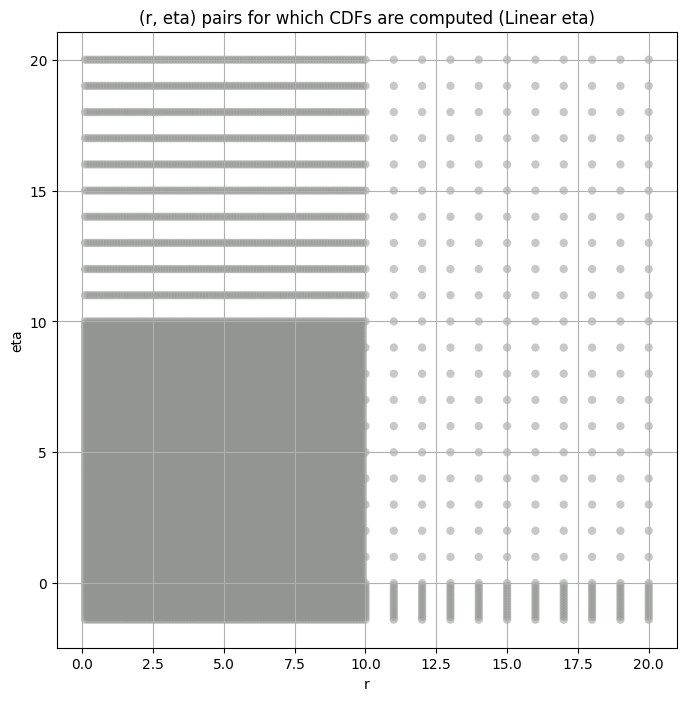

,"(r,eta),cdf",r,eta,cdf,variance,kurtosis
0,"((0.1, -1.4), <scipy.interpolate._fitpack2.Int...",0.1,-1.4,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.628800e+06,554265.000000
1,"((0.1, -1.3), <scipy.interpolate._fitpack2.Int...",0.1,-1.3,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.991680e+07,96192.272727
2,"((0.1, -1.2), <scipy.interpolate._fitpack2.Int...",0.1,-1.2,<scipy.interpolate._fitpack2.InterpolatedUniva...,2.395008e+08,29390.000000
3,"((0.1, -1.1), <scipy.interpolate._fitpack2.Int...",0.1,-1.1,<scipy.interpolate._fitpack2.InterpolatedUniva...,1.037837e+09,11997.692308
4,"((0.1, -1.0), <scipy.interpolate._fitpack2.Int...",0.1,-1.0,<scipy.interpolate._fitpack2.InterpolatedUniva...,3.632429e+09,5874.890110


In [7]:
warnings.filterwarnings('ignore', category=RuntimeWarning)

all_cdfs_df = create_kurt_var_ksstat_df(all_cdfs)
fine_cdfs_df = all_cdfs_df.copy()
all_cdfs_df = all_cdfs_df[(np.round(all_cdfs_df['r'], 1) == all_cdfs_df['r']) & (np.round(all_cdfs_df['eta'], 1) == all_cdfs_df['eta'])]
all_cdfs_df = all_cdfs_df.reset_index(drop=True)
all_cdfs = {x[0] : x[1] for x in all_cdfs_df["(r,eta),cdf"]}
                                             
var_values_dict = dict()
kurt_values_dict = dict()
master_df = pd.DataFrame(columns=[GROUP]).set_index(GROUP)
temp_cdf = all_cdfs_df
print(f"Running {all_cdfs_df.shape[0]} CDFs")
create_scatter_plot(all_cdfs_df);
all_cdfs_df.head()

## Bootstrapping the Variance and Kurtosis

In [8]:
n_bootstrap = int(1e3) # TODO For quick testing purposes
bootstrap_size = int(1e3) # TODO For quick testing purposes
ci = 0.99

In [9]:
bootstrap_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))
master_df_var_kurt_path = Path(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

if True or not master_df_var_kurt_path.exists(): # TODO For quick testing purposes
    for group in GROUPS:
        print(f'{GROUP.capitalize()} {group}: {str(filter_group_map[group])}')
        obs_var, var_lower, var_upper, var_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                n_bootstrap=n_bootstrap, 
                                                                                bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                metric= np.var, 
                                                                                ci=ci)
        obs_kurt, kurt_lower, kurt_upper, kurt_values_dict[group] = bootstrap_metric(group_data_map[group], 
                                                                                    n_bootstrap=n_bootstrap, 
                                                                                    bootstrap_size=min(group_data_map[group].size, bootstrap_size), 
                                                                                    metric= stats.kurtosis, ci=ci)  
        master_df.loc[group, 'obs_var'], master_df.loc[group, 'var_lower'], master_df.loc[group, 'var_upper'] = obs_var, var_lower, var_upper
        master_df.loc[group, 'obs_kurt'], master_df.loc[group, 'kurt_lower'], master_df.loc[group, 'kurt_upper'] = obs_kurt, kurt_lower, kurt_upper
        master_df.loc[group, 'total_samples'] = group_total_samples[group]
        master_df.loc[group, 'filter_group'] = str(filter_group_map[group])

    master_df.to_csv(os.path.join(CWD, "CSVs", f'initial_grid_bootstrap{n_bootstrap}_{bootstrap_size}_ci{ci}.csv'))

master_df = pd.read_csv(master_df_var_kurt_path, index_col=GROUP)
var_kurt_df = pd.read_csv(bootstrap_path, index_col=GROUP)
master_df

Filter_idx 0: (2.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 1: (2.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 2: (2.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 3: (2.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 4: (2.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 5: (2.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 6: (2.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 7: (2.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 8: (2.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 9: (2.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 10: (2.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 11: (2.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 12: (2.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 13: (2.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 14: (3.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 15: (3.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 16: (3.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 17: (3.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 18: (3.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 19: (3.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 20: (3.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 21: (3.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 22: (3.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 23: (3.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 24: (3.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 25: (3.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 26: (3.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 27: (3.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 28: (4.0, 0.5, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 29: (4.0, 0.5, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 30: (4.0, 0.5, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 31: (4.0, 0.5, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 32: (4.0, 0.5, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 33: (4.0, 0.5, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 34: (4.0, 0.5, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 35: (4.0, 1.0, 0.044)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 36: (4.0, 1.0, 0.065)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 37: (4.0, 1.0, 0.096)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 38: (4.0, 1.0, 0.141)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 39: (4.0, 1.0, 0.208)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 40: (4.0, 1.0, 0.306)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

Filter_idx 41: (4.0, 1.0, 0.45)


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group
filter_idx,,,,,,,,
0,55335.40000,43910.880000,67200.02000,4.569961,2.753132,10.063652,65536000.0,"(2.0, 0.5, 0.044)"
1,19047.67000,14847.801000,24242.93000,6.379718,3.746185,14.553737,65536000.0,"(2.0, 0.5, 0.065)"
2,6874.37450,5331.145000,8745.57600,7.939266,4.336729,17.756517,65536000.0,"(2.0, 0.5, 0.096)"
3,2517.88000,1859.195700,3329.25050,11.032557,5.883101,26.747358,65536000.0,"(2.0, 0.5, 0.141)"
4,960.38640,676.863200,1276.19180,13.725231,7.874681,37.101093,65536000.0,"(2.0, 0.5, 0.208)"
5,337.90594,225.185470,464.41925,17.738790,8.973111,45.261600,65536000.0,"(2.0, 0.5, 0.306)"
6,228.05840,158.856740,316.73297,16.143604,8.750346,45.505930,65536000.0,"(2.0, 0.5, 0.45)"
7,75053.41000,60645.383000,93151.82000,5.436268,3.062418,13.906753,65536000.0,"(2.0, 1.0, 0.044)"
8,27106.73800,20925.596000,34942.88700,7.330939,3.835541,21.208311,65536000.0,"(2.0, 1.0, 0.065)"


## Initial Grid Search and Hypothesis Test Plots

In [10]:
EXCLUDE_CUTOFFS = [0, 50, 100, 200] # TODO For quick testing purposes
SCALE_CAP = 1e5

In [11]:
augmented_var_df_path = Path(os.path.join(CWD, "CSVs", "augmented_var_df.csv"))
augmented_var_df = var_kurt_df[['obs_var']].copy()
augmented_var_df
for val in EXCLUDE_CUTOFFS:
    temp_arr = []
    for group in GROUPS:
        if val != 0:
            temp_arr.append(np.var(group_data_map[group][val:-val]))
        else:
            temp_arr.append(np.var(group_data_map[group]))

    augmented_var_df[f"var_exclude_{val}"] = temp_arr
augmented_var_df

,obs_var,var_exclude_0,var_exclude_50,var_exclude_100,var_exclude_200
filter_idx,,,,,
0,55335.40000,55335.398438,53534.945312,52317.878906,50306.933594
1,19047.67000,19047.669922,18298.376953,17796.328125,16972.730469
2,6874.37450,6874.374512,6569.198242,6363.777832,6025.543945
3,2517.88000,2517.879883,2375.746094,2282.412598,2134.698486
4,960.38640,960.386414,898.099487,858.606873,796.604675
5,337.90594,337.905945,312.769043,295.861633,269.772675
6,228.05840,228.058395,212.141663,201.411346,184.808090
7,75053.41000,75053.406250,72229.554688,70305.632812,67223.226562
8,27106.73800,27106.738281,25870.931641,25059.242188,23783.564453


####
Filter_idx, 0: (2.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 0 0.010412766703431886 55335.4


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 50 0.009376864803605334 53534.945


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 100 0.01008169637383205 52317.88


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
0 200 0.01106967210140597 50306.934
Number of samples: 100000, Without approximation : 65536000.0


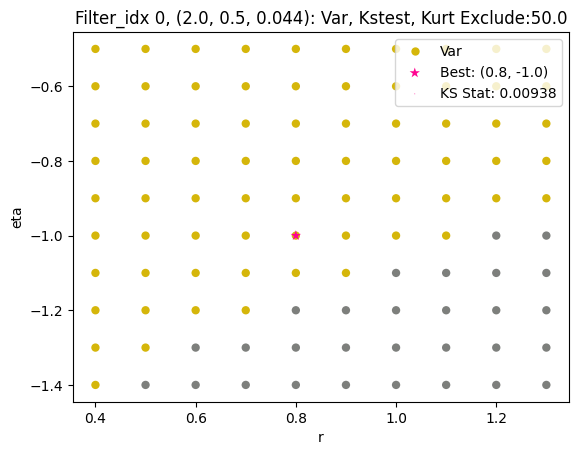

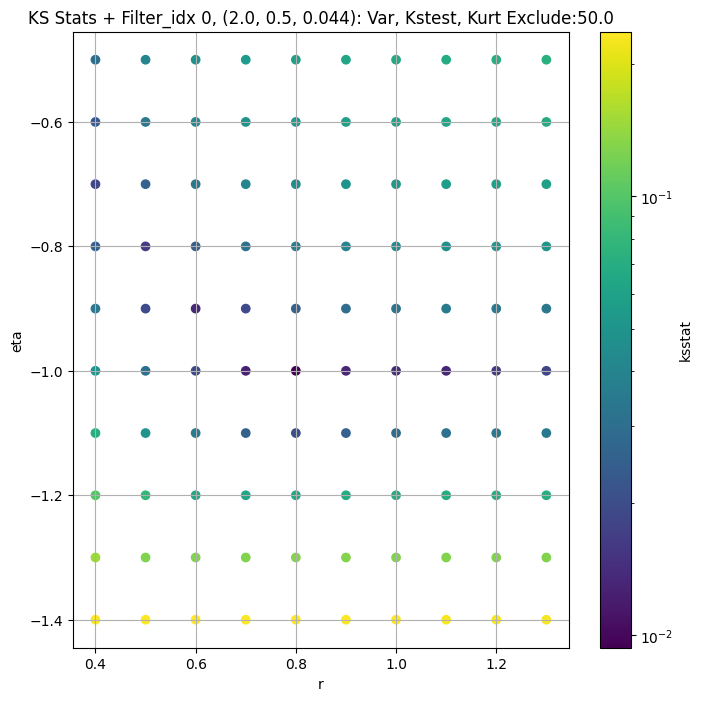

####
Filter_idx, 1: (2.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 0 0.006849840472434421 19047.67


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 50 0.007524351228825832 18298.377


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 100 0.007296202343806679 17796.328


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
1 200 0.009190095497272455 16972.73
Number of samples: 100000, Without approximation : 65536000.0


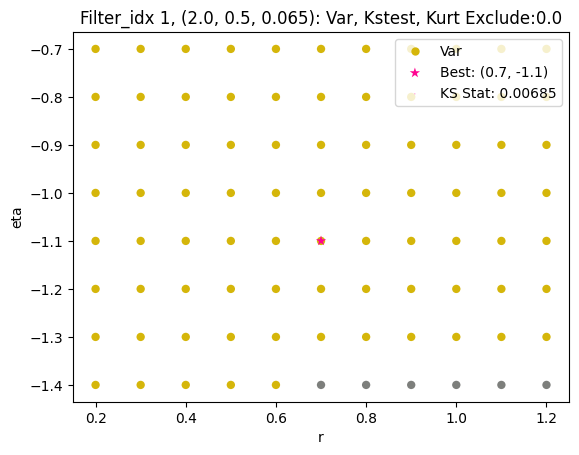

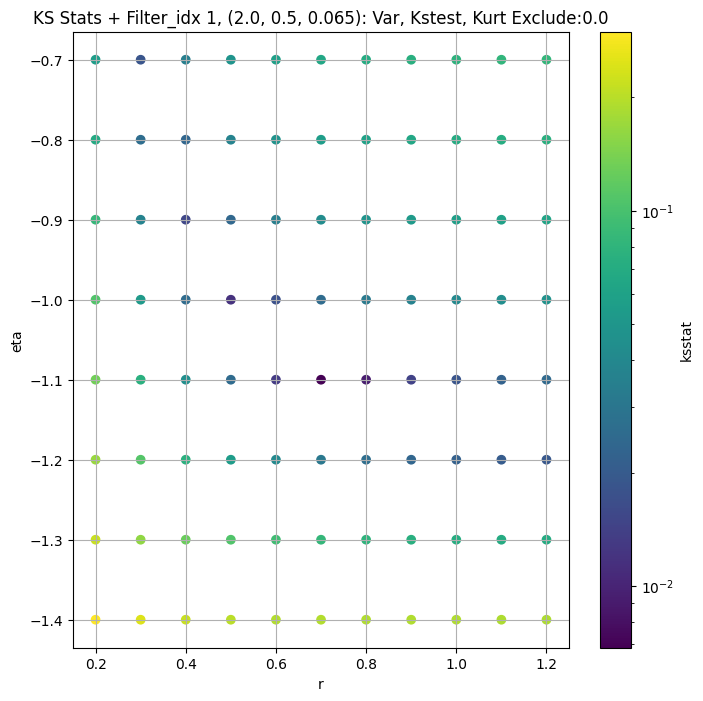

####
Filter_idx, 2: (2.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 0 0.007514550171571099 6874.3745


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 50 0.008145804541063284 6569.198


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 100 0.009214731799107798 6363.778


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
2 200 0.008385280265354726 6025.544
Number of samples: 100000, Without approximation : 65536000.0


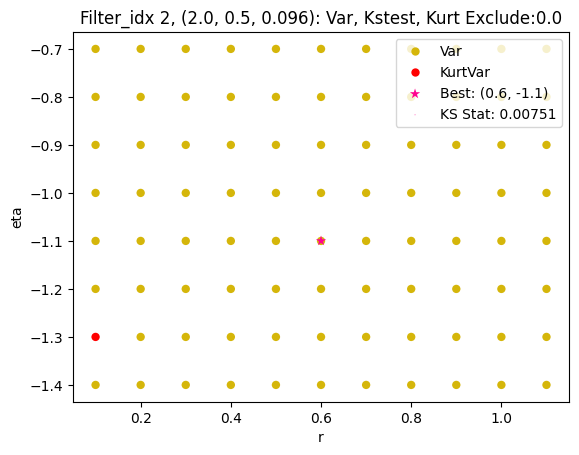

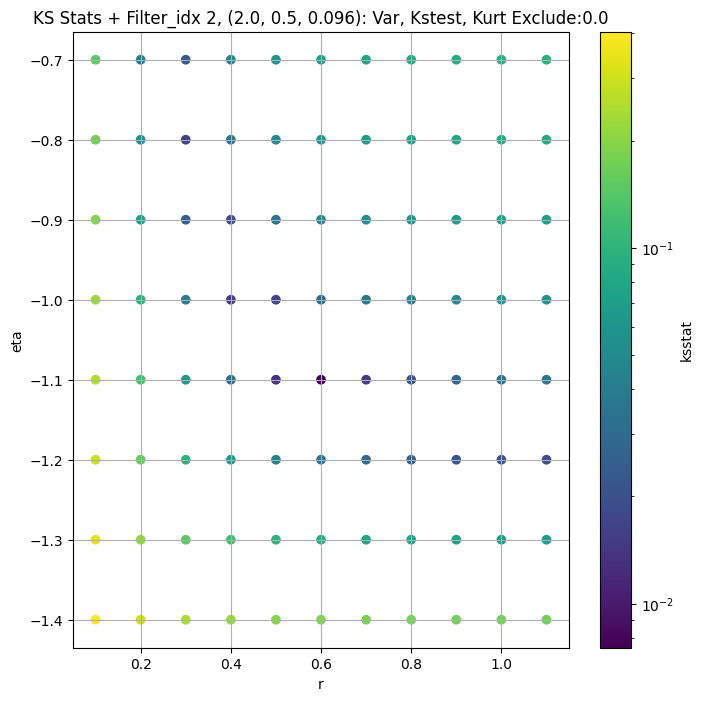

####
Filter_idx, 3: (2.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 0 0.009173442903337214 2517.88


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 50 0.01005491854061552 2375.746


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 100 0.0100000490250325 2282.4126


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
3 200 0.011837228028535929 2134.6985
Number of samples: 100000, Without approximation : 65536000.0


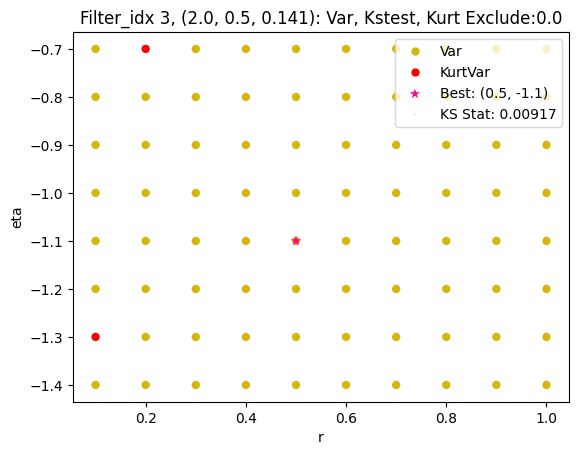

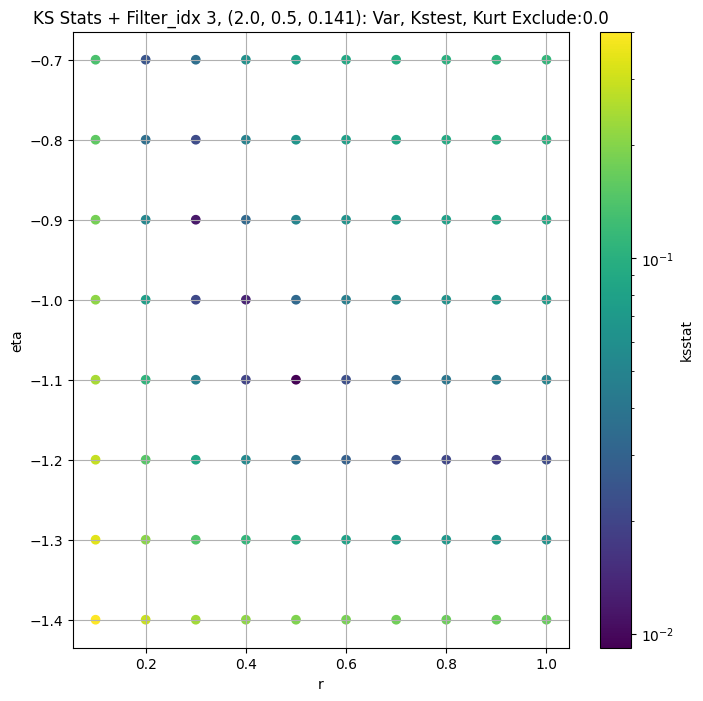

####
Filter_idx, 4: (2.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 0 0.011435353525330871 960.3864


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 50 0.00998176816764862 898.0995


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 100 0.009044558860962157 858.6069


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
4 200 0.010706307499673995 796.6047
Number of samples: 100000, Without approximation : 65536000.0


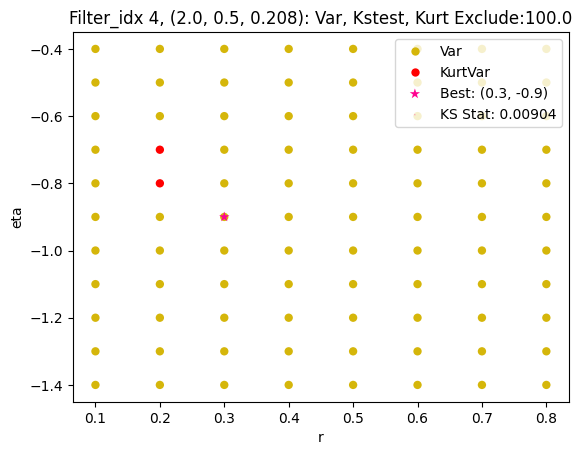

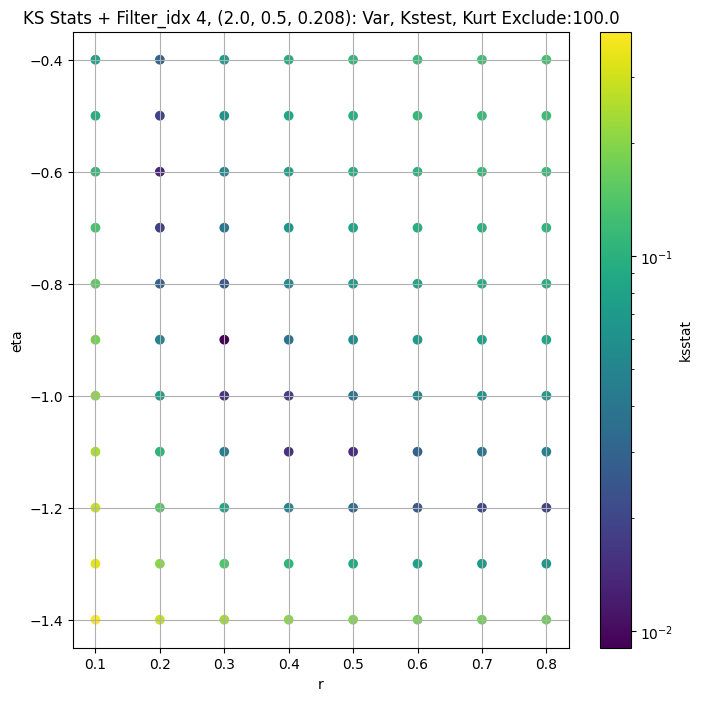

####
Filter_idx, 5: (2.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 0 0.00758766098634911 337.90594


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 50 0.007586386583590565 312.76904


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 100 0.00821119593066788 295.86163


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
5 200 0.010395635830048211 269.77267
Number of samples: 100000, Without approximation : 65536000.0


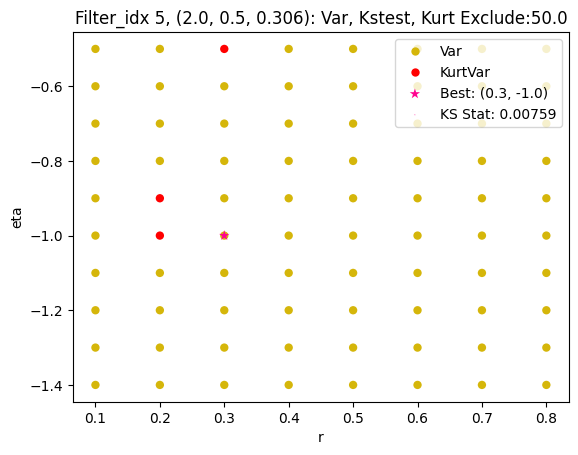

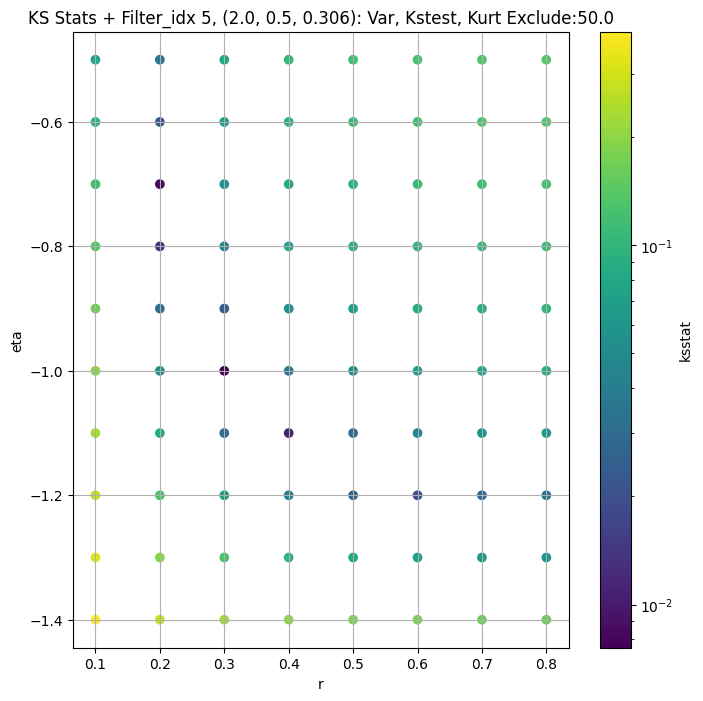

####
Filter_idx, 6: (2.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 0 0.010339936481684298 228.0584


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 50 0.01030820192287002 212.14166


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 100 0.010307102966295778 201.41135


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
6 200 0.011835381653679033 184.80809
Number of samples: 100000, Without approximation : 65536000.0


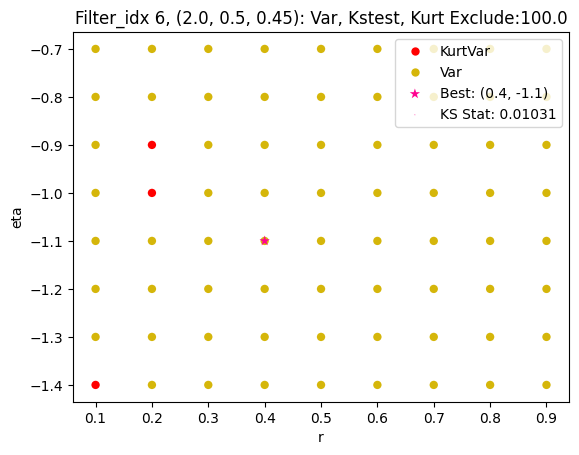

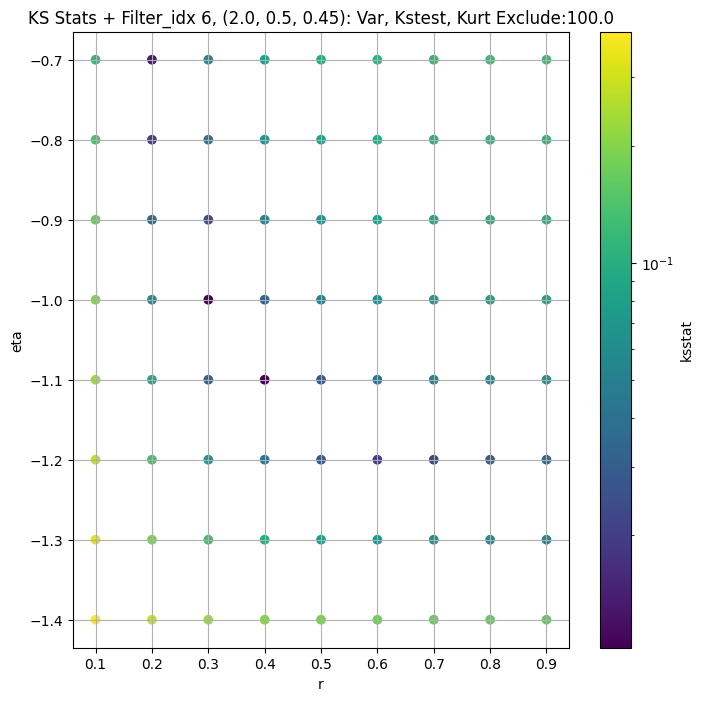

####
Filter_idx, 7: (2.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 0 0.007652474072904453 75053.41


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 50 0.008890030224395273 72229.555


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 100 0.008070317692322693 70305.63


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
7 200 0.00904434742923585 67223.23
Number of samples: 100000, Without approximation : 65536000.0


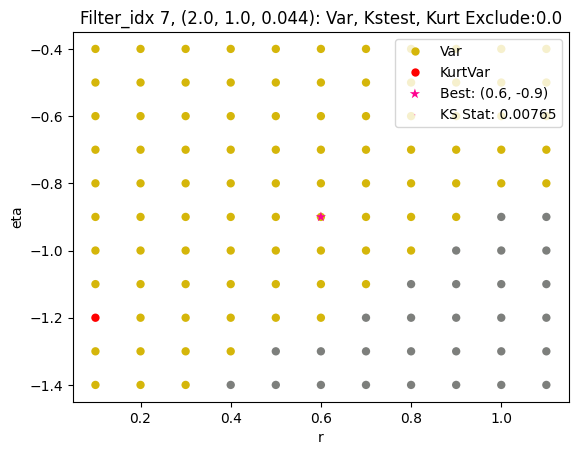

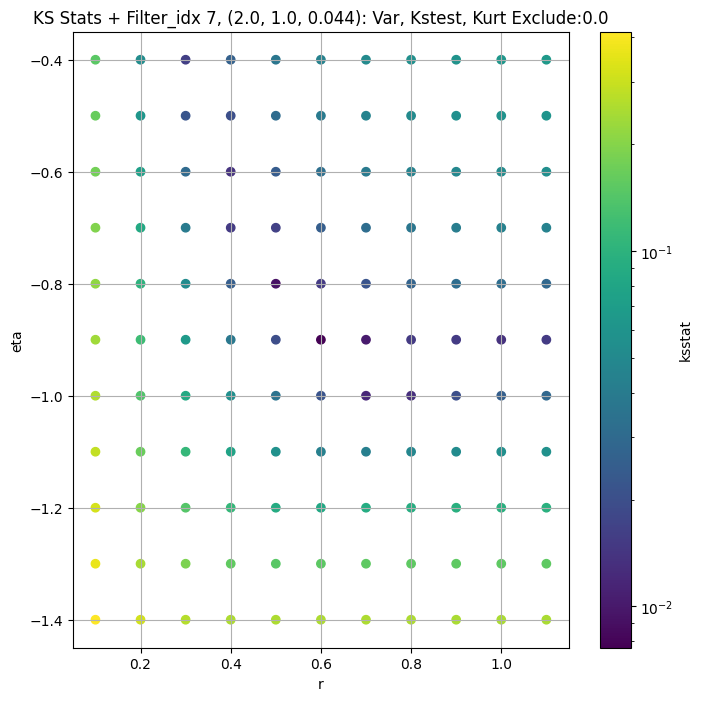

####
Filter_idx, 8: (2.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 0 0.004747684463613677 27106.738


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 50 0.005404063256093106 25870.932


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 100 0.005148456070854679 25059.242


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
8 200 0.005142654897251575 23783.564
Number of samples: 100000, Without approximation : 65536000.0


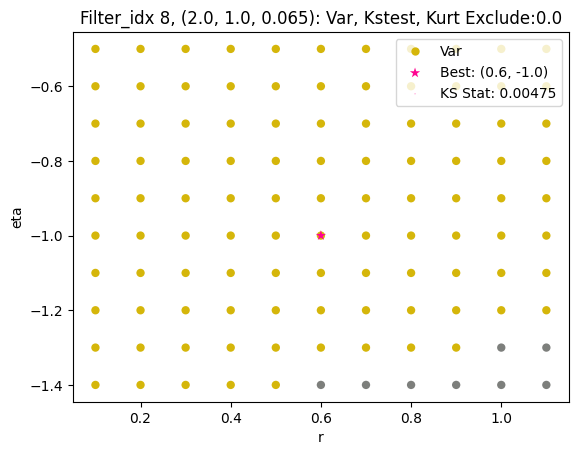

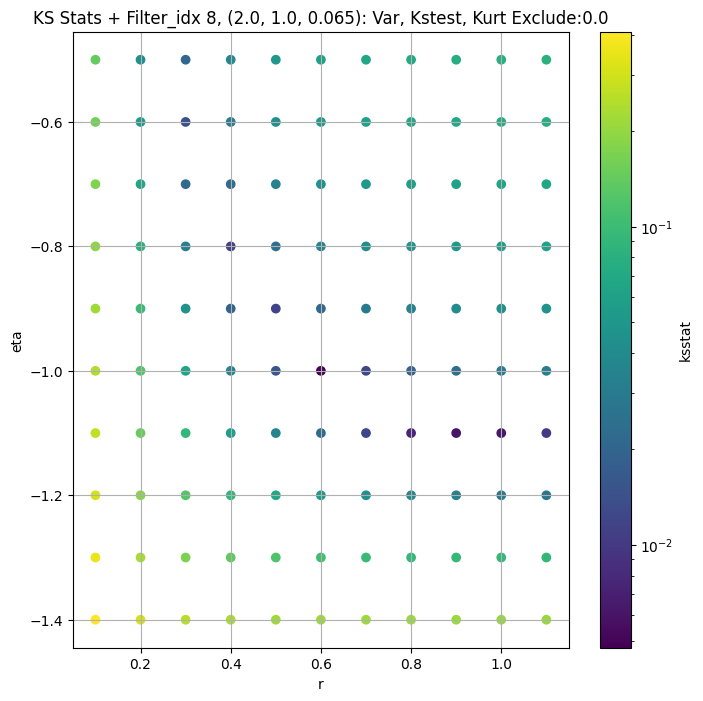

####
Filter_idx, 9: (2.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 0 0.006489709333047711 9415.743


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 50 0.006251143147152055 8899.272


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 100 0.007169279813288965 8565.491


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
9 200 0.006226030025070051 8054.158
Number of samples: 100000, Without approximation : 65536000.0


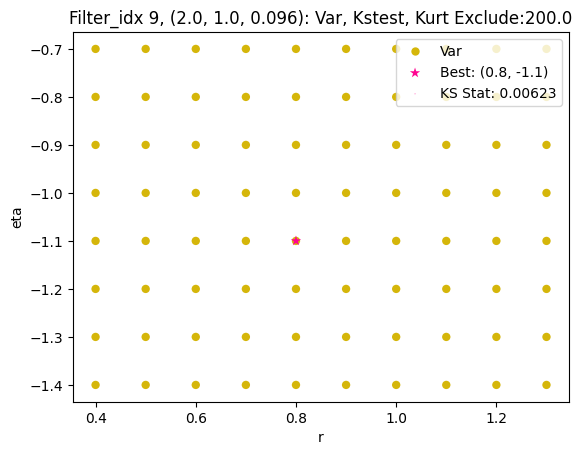

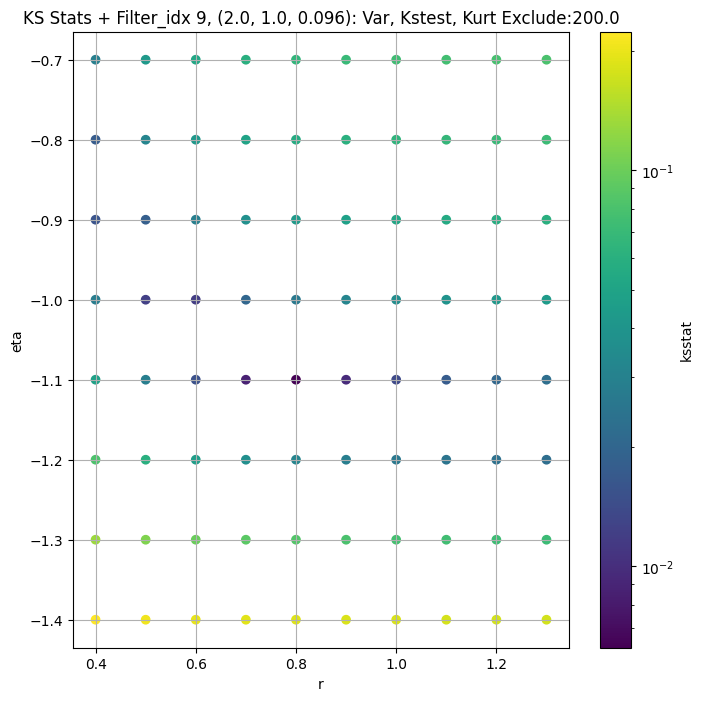

####
Filter_idx, 10: (2.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 0 0.0044400043418066915 3532.9695


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 50 0.008244092520157523 3288.0964


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 100 0.0074916593501251905 3136.8022


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
10 200 0.008597596779708172 2915.0898
Number of samples: 100000, Without approximation : 65536000.0


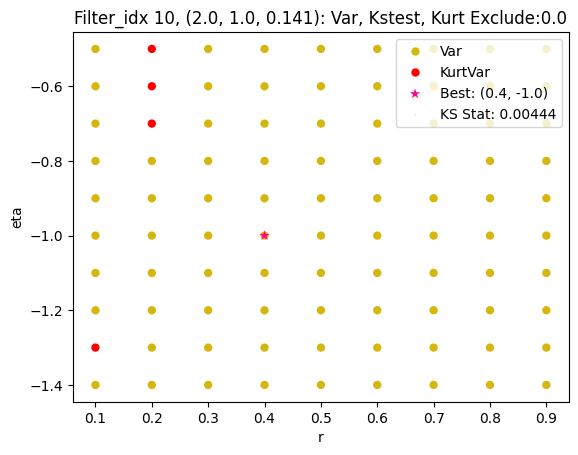

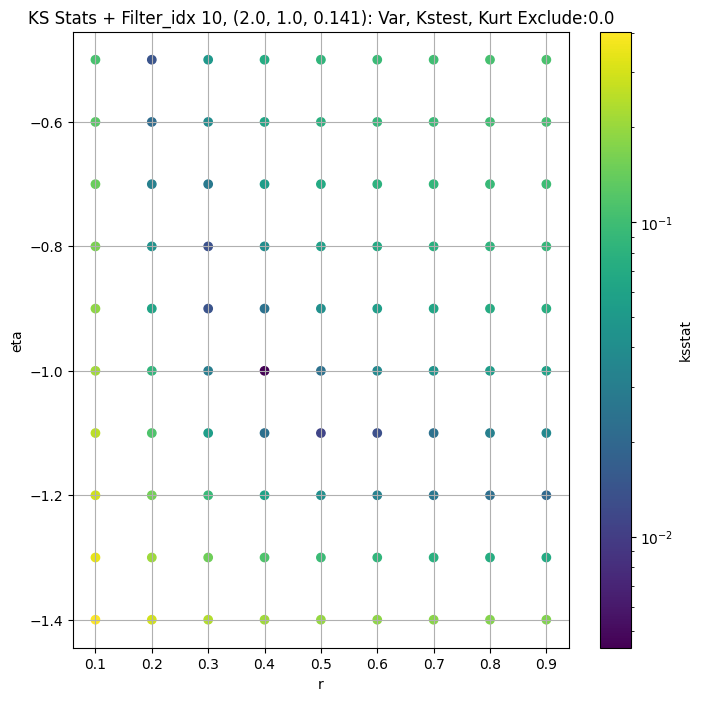

####
Filter_idx, 11: (2.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 0 0.0044337244665245135 1327.3878


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 50 0.007901401432843763 1226.7792


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 100 0.0076799301029808476 1166.0758


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
11 200 0.007846559580183543 1074.1865
Number of samples: 100000, Without approximation : 65536000.0


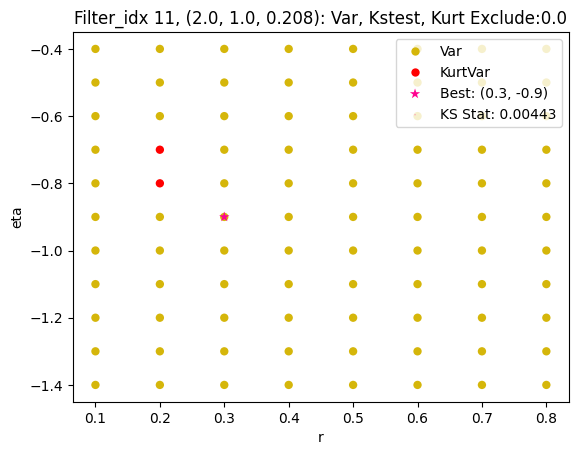

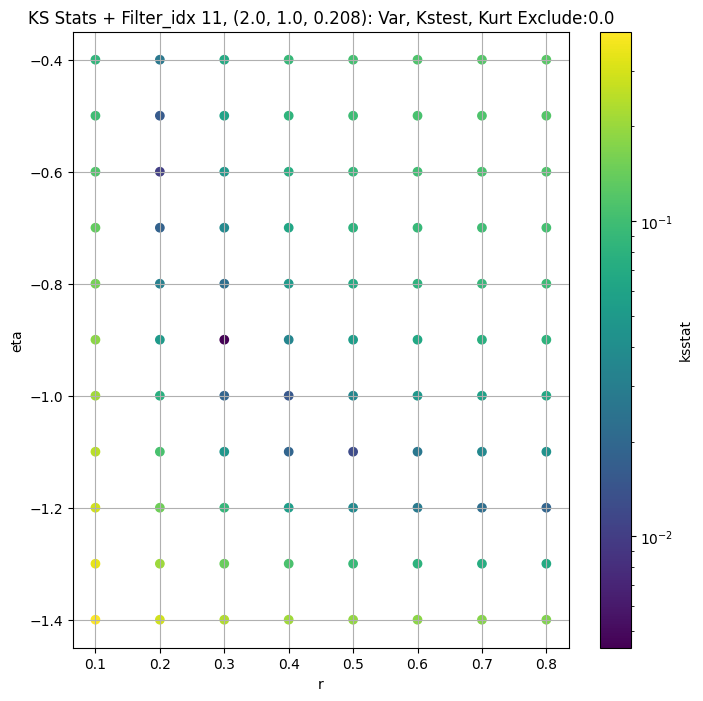

####
Filter_idx, 12: (2.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 0 0.006915967133331757 486.4704


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 50 0.010517008431876584 441.43488


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 100 0.009810628113851583 415.4662


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
12 200 0.008017980478841391 378.36218
Number of samples: 100000, Without approximation : 65536000.0


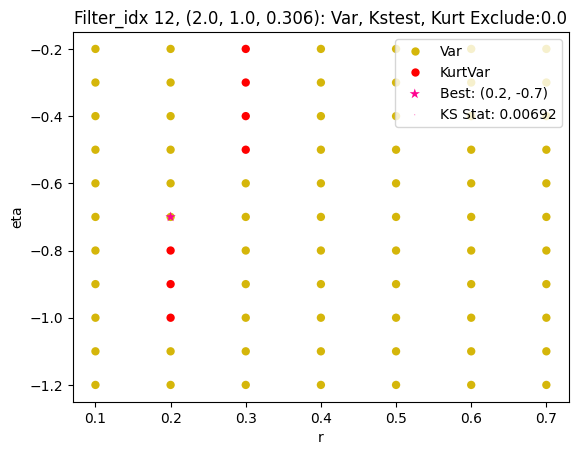

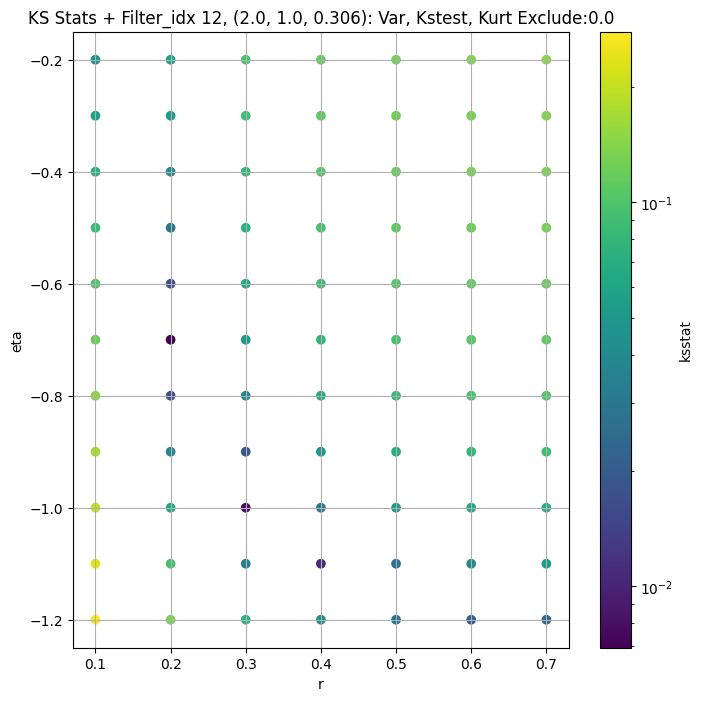

####
Filter_idx, 13: (2.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 0 0.009541929065388144 240.64812


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 50 0.009522354540515754 214.98895


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 100 0.009520986951438215 200.18024


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
13 200 0.009506981394932446 178.68225
Number of samples: 100000, Without approximation : 65536000.0


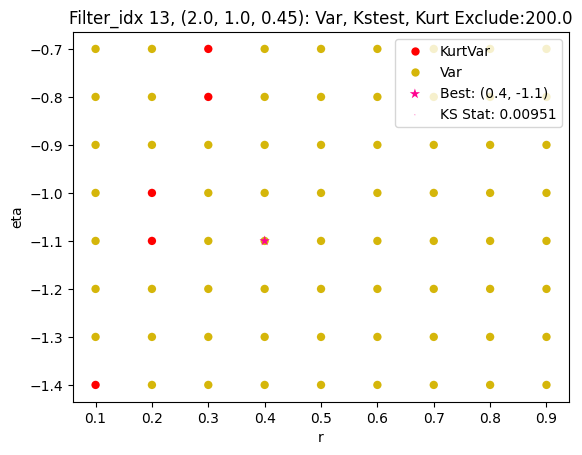

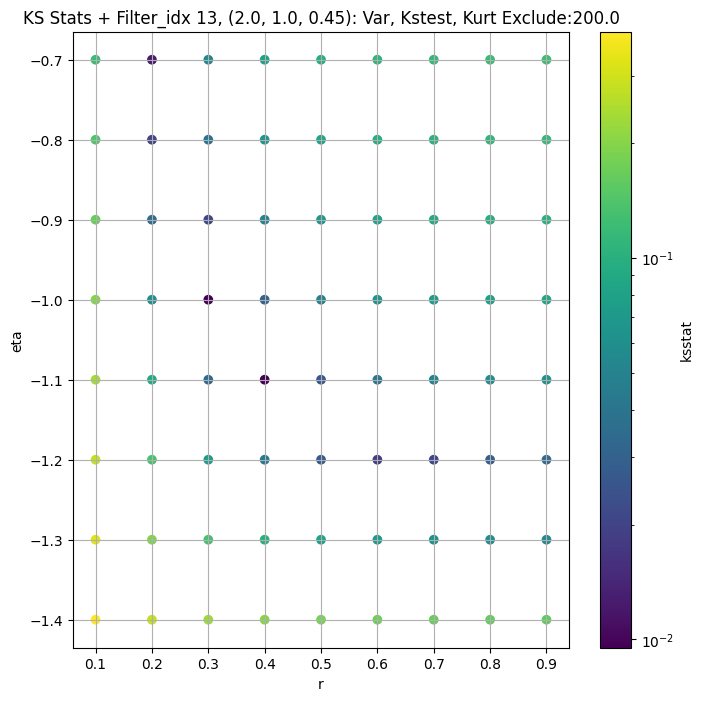

####
Filter_idx, 14: (3.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 0 0.00748200384529718 49222.934


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 50 0.008370858883389176 47342.234


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 100 0.008370858883389176 46086.977


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
14 200 0.008866125090147961 44055.945
Number of samples: 100000, Without approximation : 65536000.0


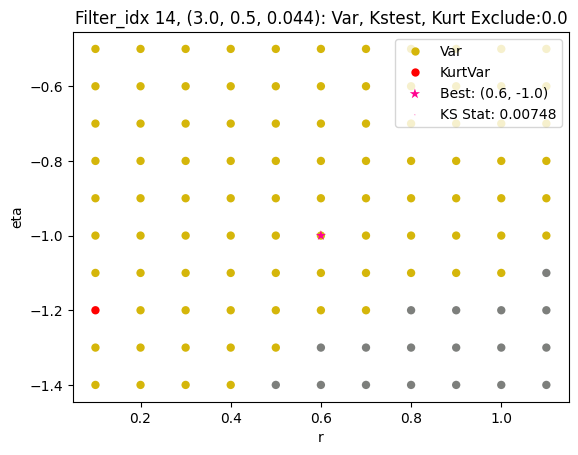

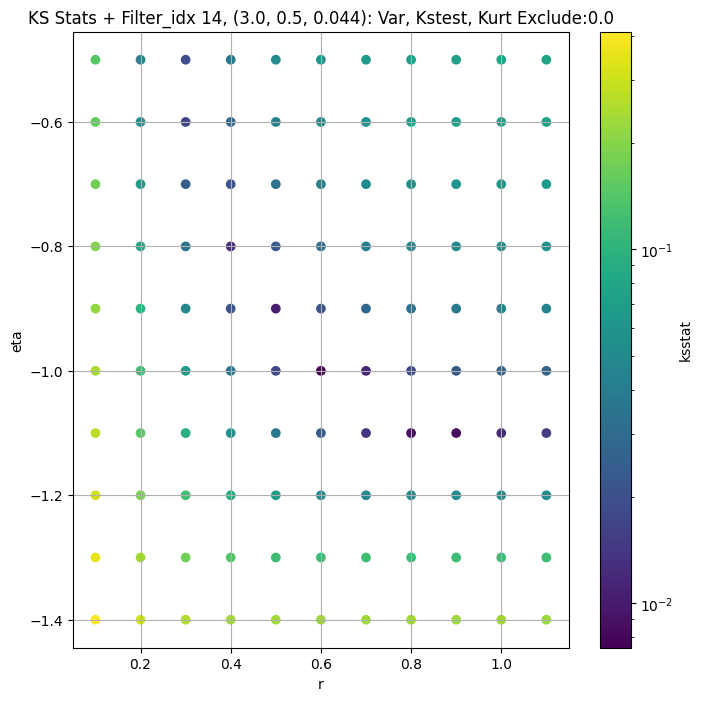

####
Filter_idx, 15: (3.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 0 0.008398135834532083 17971.002


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 50 0.009071068783277736 17102.602


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 100 0.007834528517431827 16551.121


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
15 200 0.008112595386731161 15676.603
Number of samples: 100000, Without approximation : 65536000.0


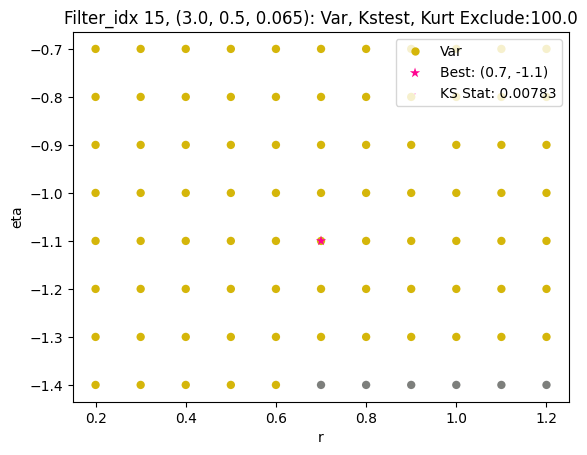

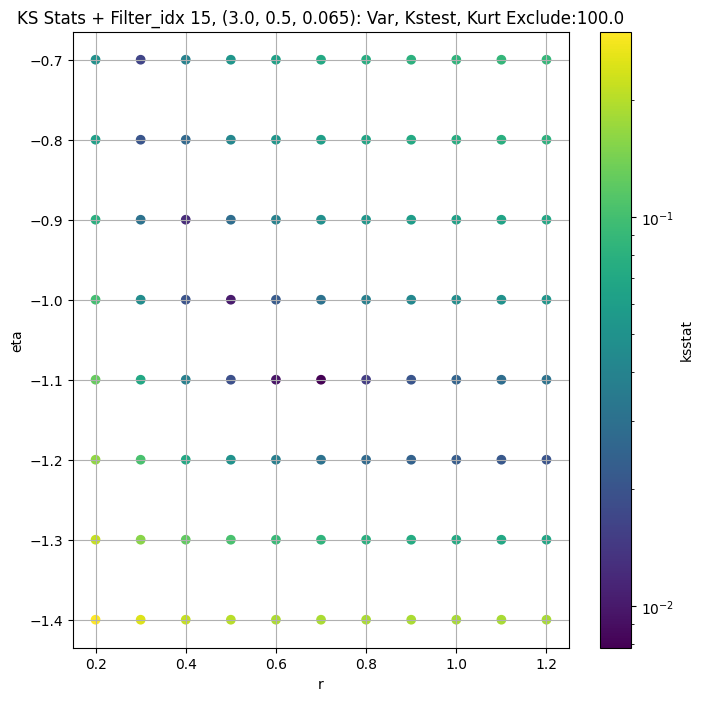

####
Filter_idx, 16: (3.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 0 0.010834051104240072 6345.5527


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 50 0.009744471244081843 5984.032


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 100 0.010369826764896284 5754.5005


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
16 200 0.01145954591861792 5394.3745
Number of samples: 100000, Without approximation : 65536000.0


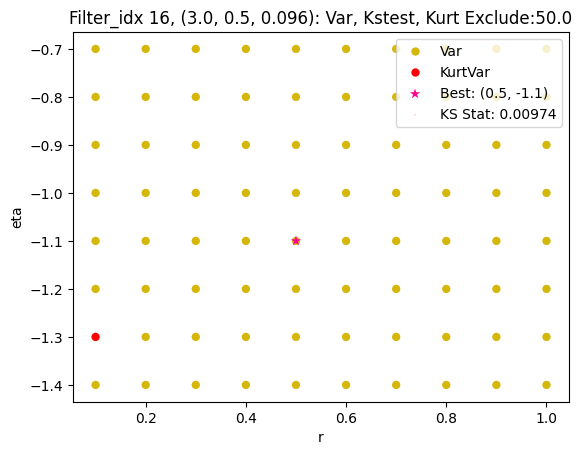

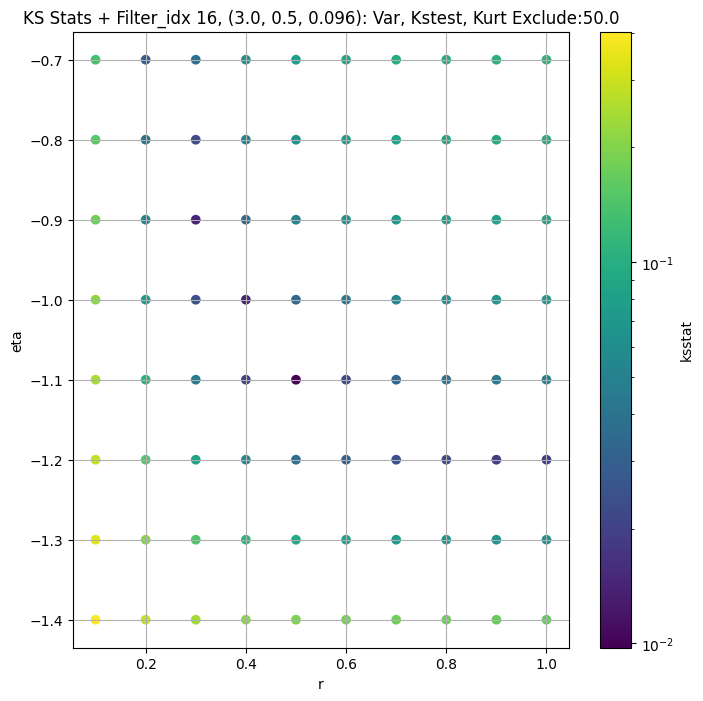

####
Filter_idx, 17: (3.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 0 0.013150299569506557 2323.7383


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 50 0.011346503892810778 2161.0562


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 100 0.010439329067632785 2059.1077


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
17 200 0.011566757215657697 1902.5211
Number of samples: 100000, Without approximation : 65536000.0


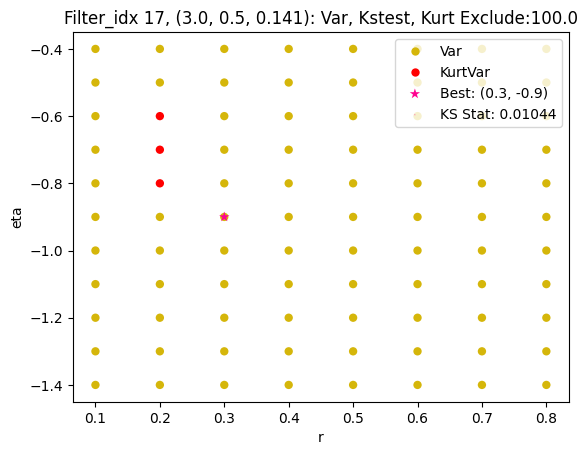

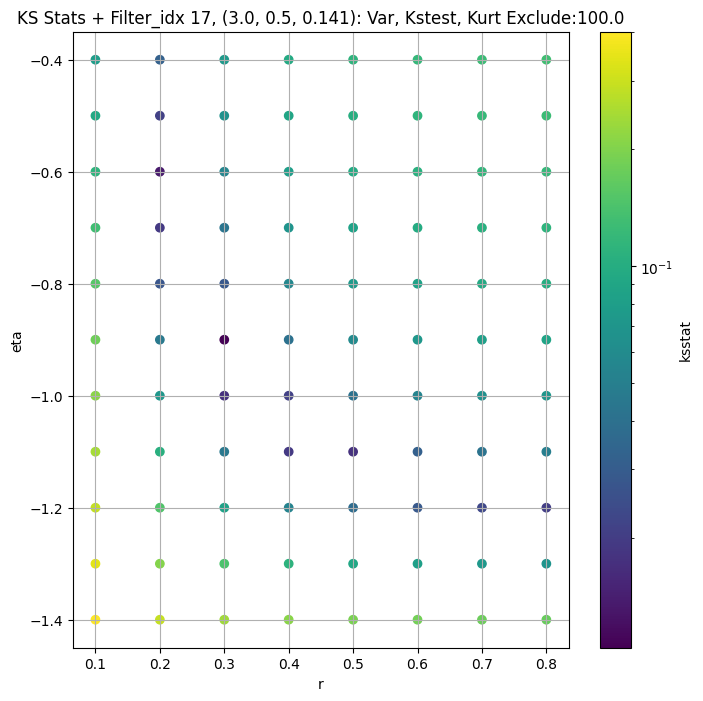

####
Filter_idx, 18: (3.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 0 0.008844911489324203 900.46747


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 50 0.008434965398894212 823.55725


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 100 0.010429225380957918 778.8207


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
18 200 0.010664672974710854 712.7946
Number of samples: 100000, Without approximation : 65536000.0


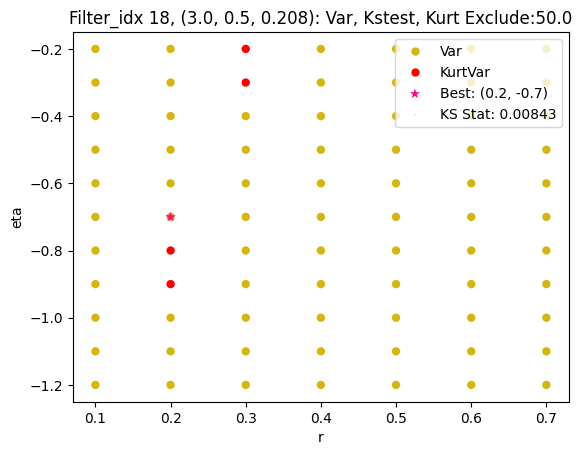

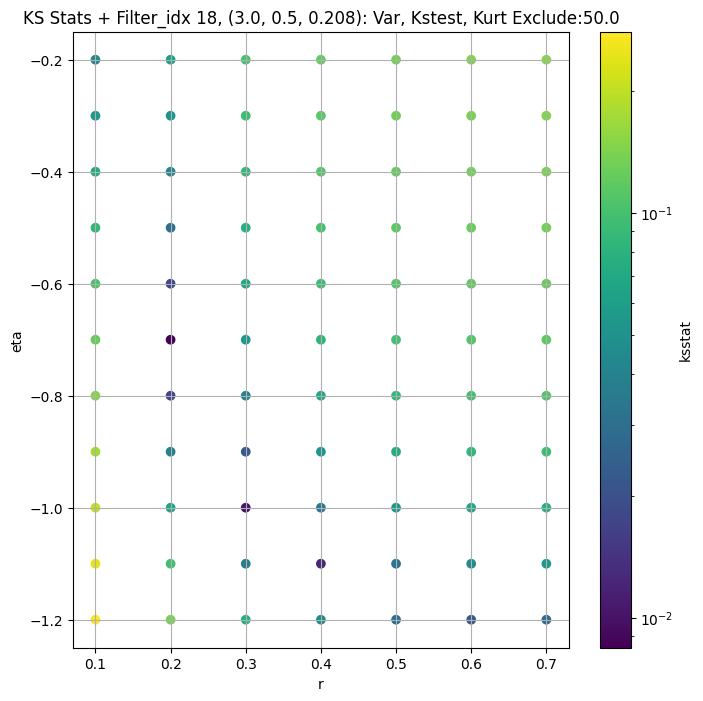

####
Filter_idx, 19: (3.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 0 0.005163939715265409 343.26465


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 50 0.007151364020731632 310.5387


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 100 0.006363294774263006 291.2368


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
19 200 0.009088281936263765 261.75238
Number of samples: 100000, Without approximation : 65536000.0


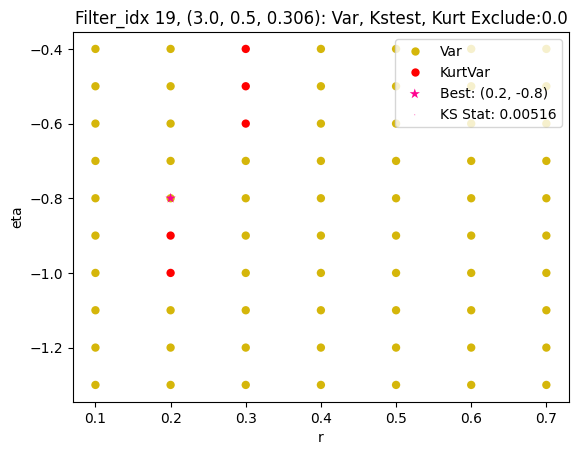

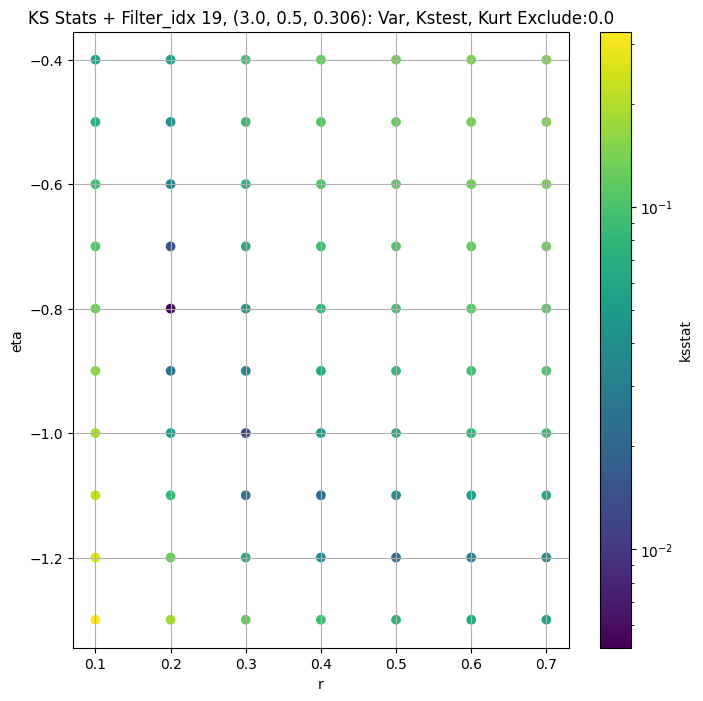

####
Filter_idx, 20: (3.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 0 0.008125240380438215 171.33374


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 50 0.01155923105676493 152.8542


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 100 0.014050475828636999 142.05898


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
20 200 0.011697392590007571 125.96528
Number of samples: 100000, Without approximation : 65536000.0


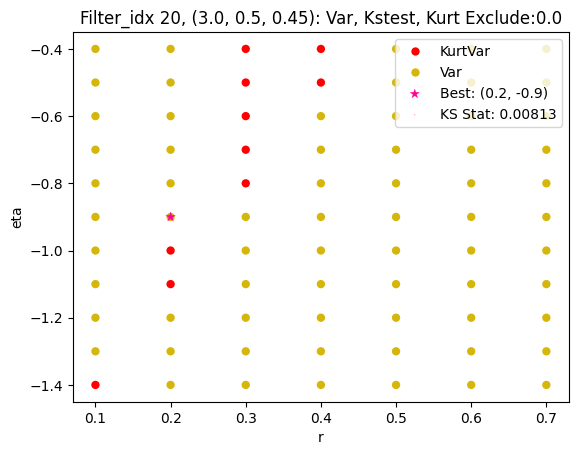

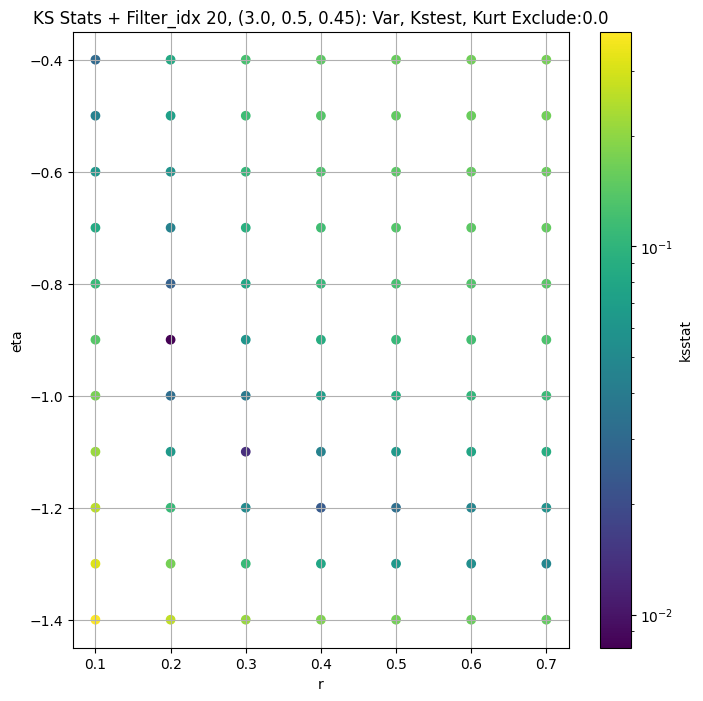

####
Filter_idx, 21: (3.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 0 0.00784432882668129 59909.387


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 50 0.006297891843876746 56689.18


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 100 0.006333588147807823 54546.797


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
21 200 0.009818606638177685 51206.56
Number of samples: 100000, Without approximation : 65536000.0


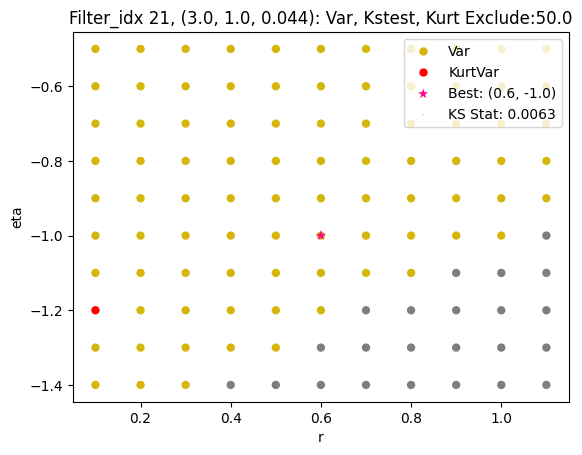

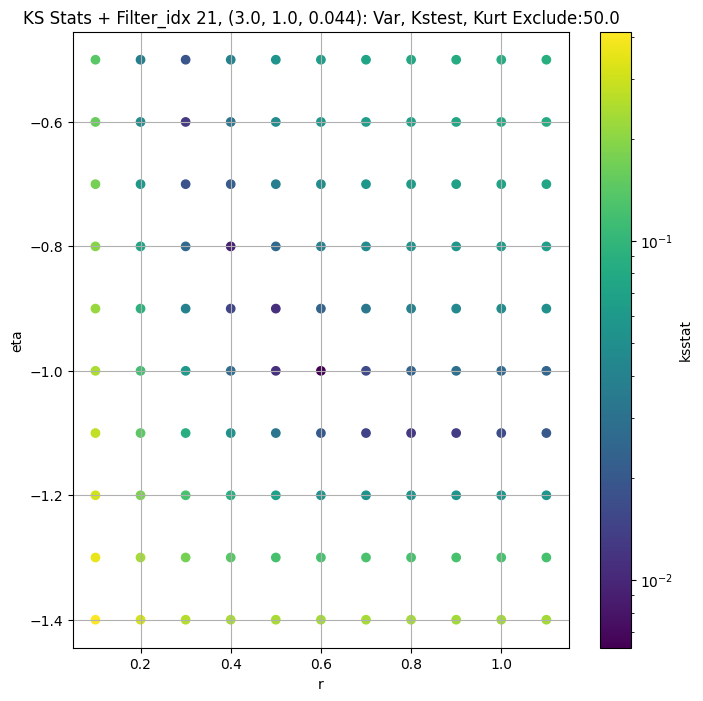

####
Filter_idx, 22: (3.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 0 0.00801592317343798 21362.357


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 50 0.009959875027659604 19970.9


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 100 0.012216944296235183 19046.166


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
22 200 0.008131476955245298 17635.11
Number of samples: 100000, Without approximation : 65536000.0


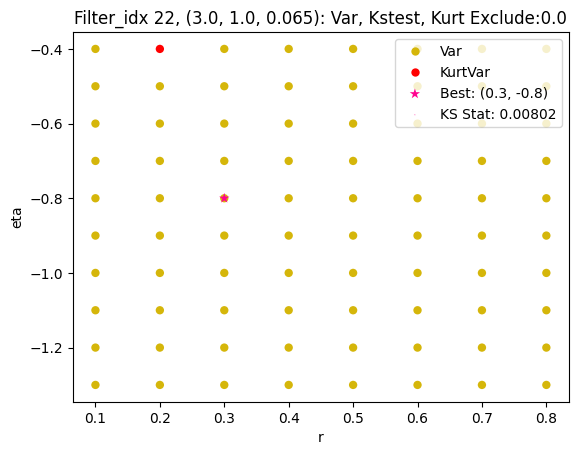

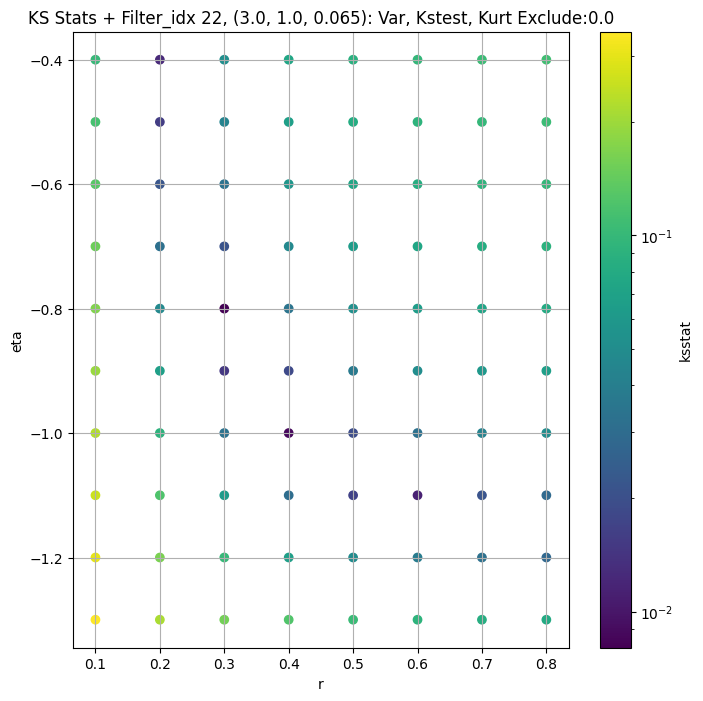

####
Filter_idx, 23: (3.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 0 0.006658444340446823 7615.371


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 50 0.009435857500330713 7021.8066


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 100 0.00951373004909406 6645.6626


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
23 200 0.009854602449180239 6086.459
Number of samples: 100000, Without approximation : 65536000.0


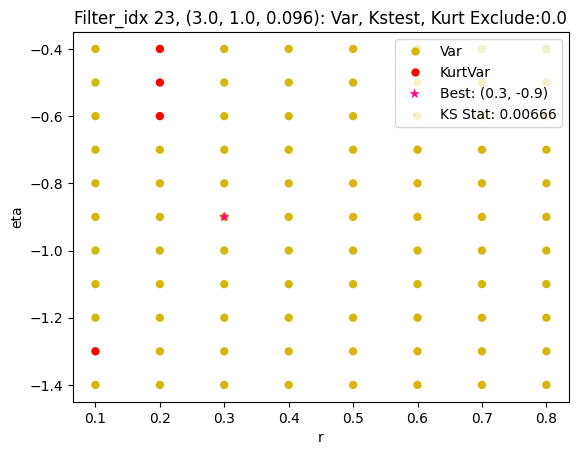

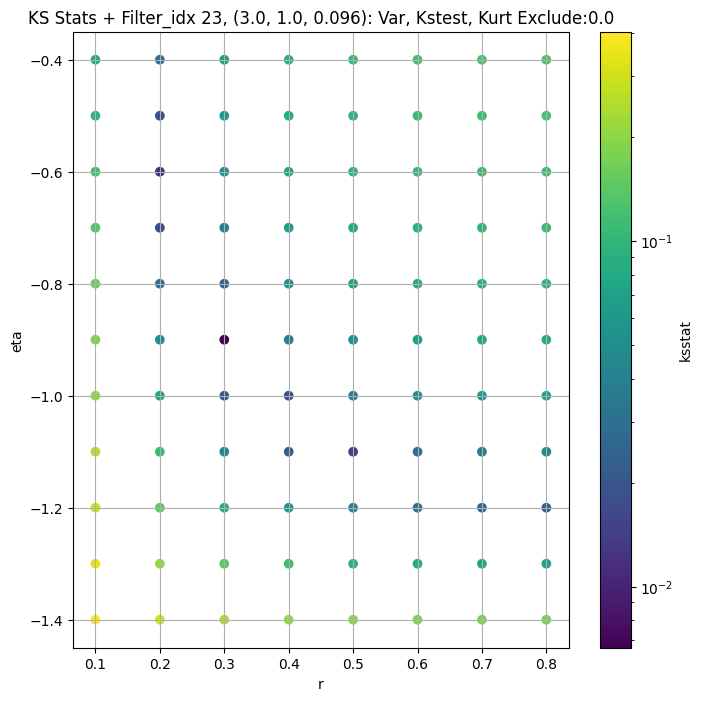

####
Filter_idx, 24: (3.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 0 0.007391740035174399 2686.8796


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 50 0.01146703691348161 2421.3337


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 100 0.010485894524609414 2263.511


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
24 200 0.010054712755401513 2041.5891
Number of samples: 100000, Without approximation : 65536000.0


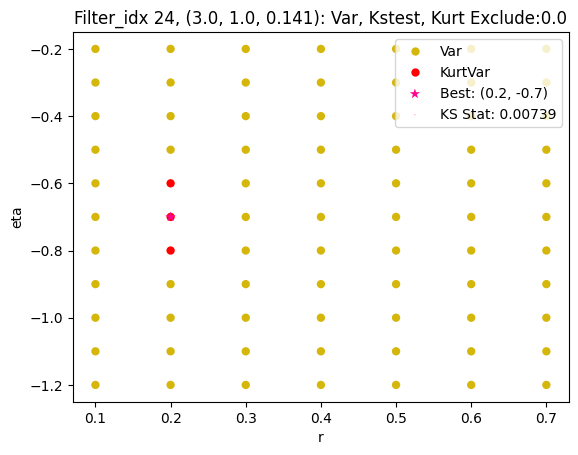

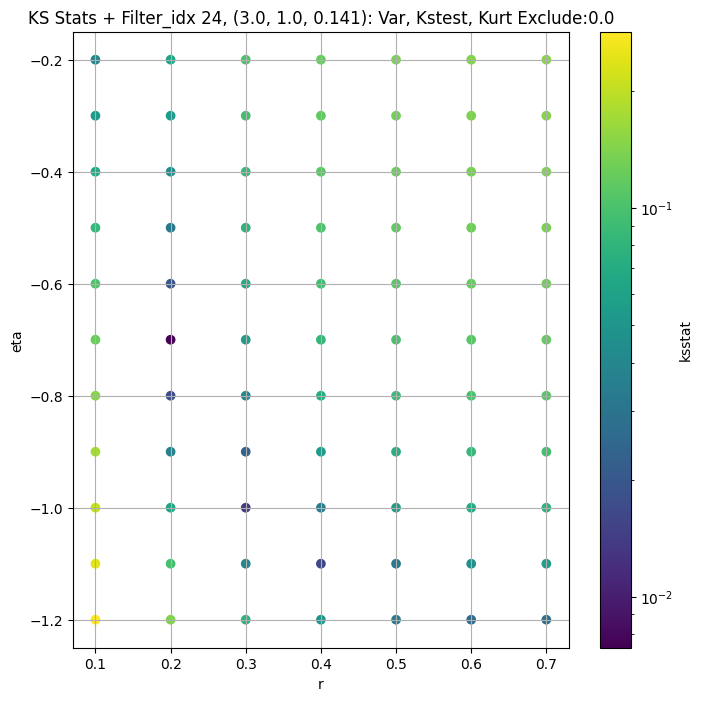

####
Filter_idx, 25: (3.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 0 0.007168122349326428 1004.39294


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 50 0.007004789746413109 886.7021


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 100 0.007640267374204424 821.33514


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
25 200 0.009155548614154574 729.2906
Number of samples: 100000, Without approximation : 65536000.0


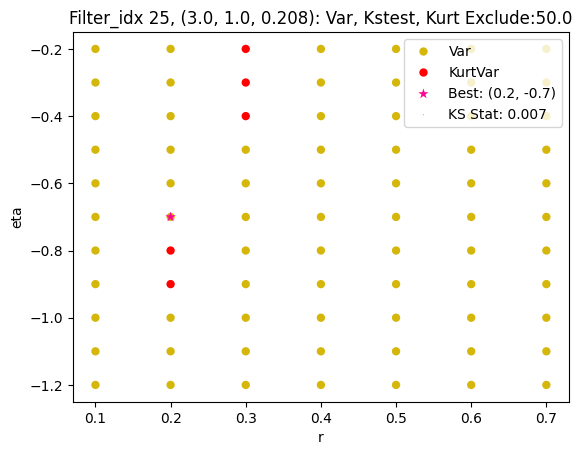

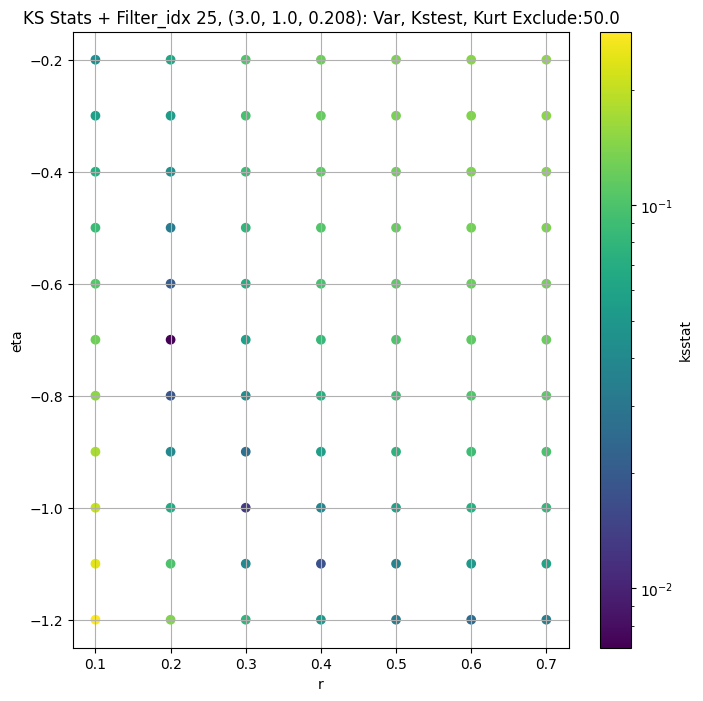

####
Filter_idx, 26: (3.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 0 0.005221398214675849 411.3971


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 50 0.007294363686463412 355.63373


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 100 0.006625584658518202 326.2119


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
26 200 0.009040056730115209 287.2305
Number of samples: 100000, Without approximation : 65536000.0


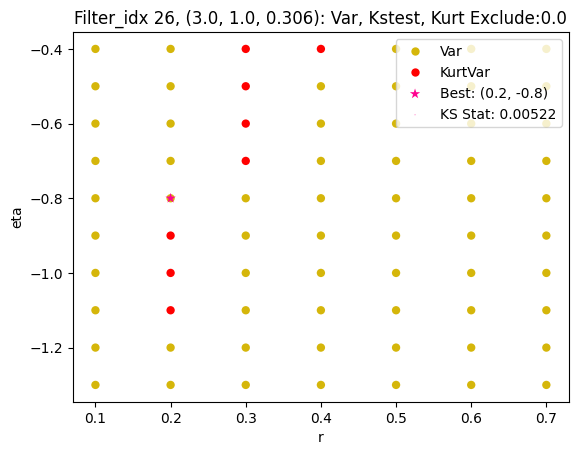

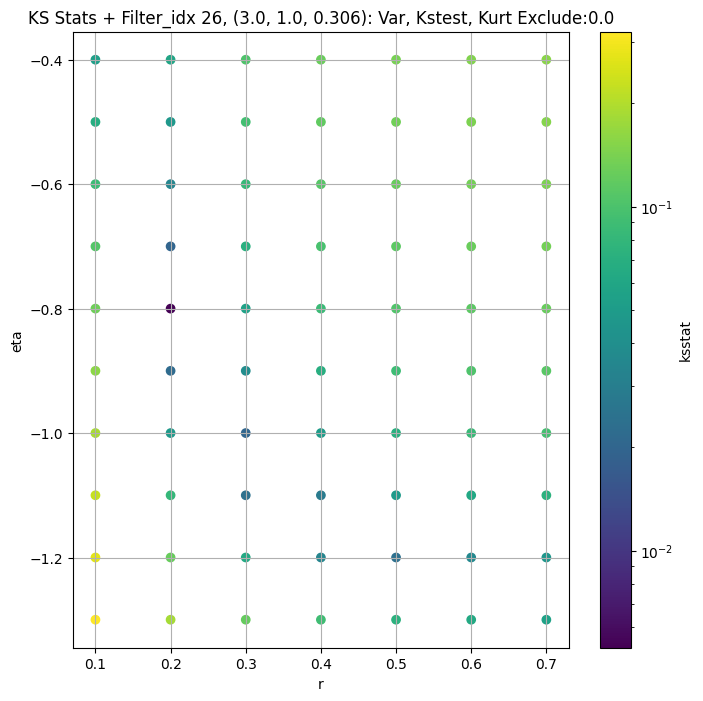

####
Filter_idx, 27: (3.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 0 0.010528688499953046 163.96483


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 50 0.0077722167073780435 136.50159


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 100 0.011133116061976311 122.553406


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
27 200 0.010620788566736816 105.5306
Number of samples: 100000, Without approximation : 65536000.0


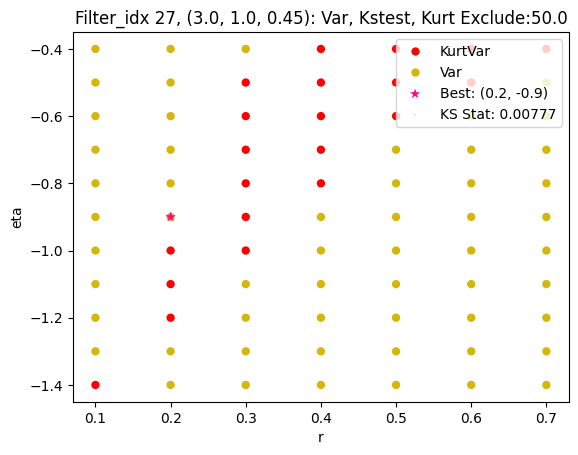

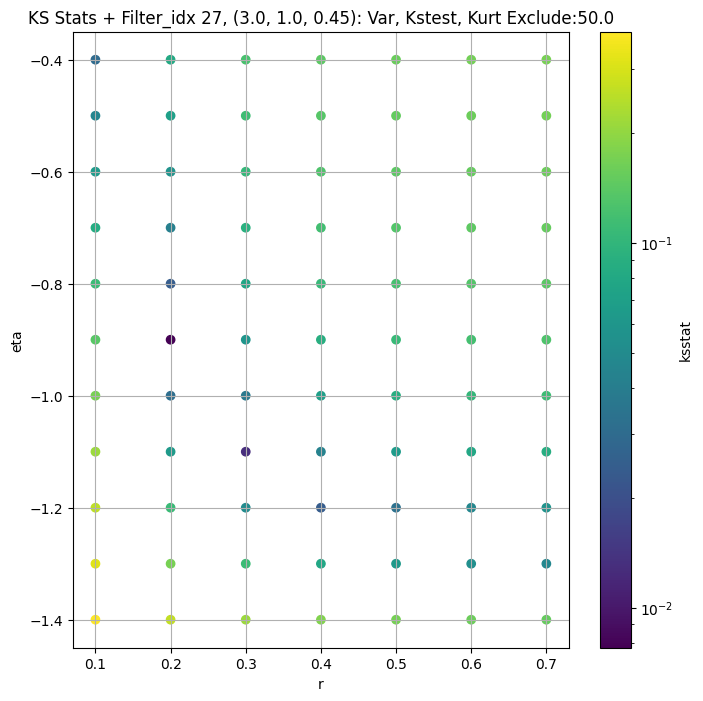

####
Filter_idx, 28: (4.0, 0.5, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 0 0.006583032335114397 46349.277


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 50 0.009271938035080474 44326.16


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 100 0.008015652715428923 43034.668


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
28 200 0.010453313116099205 40996.88
Number of samples: 100000, Without approximation : 65536000.0


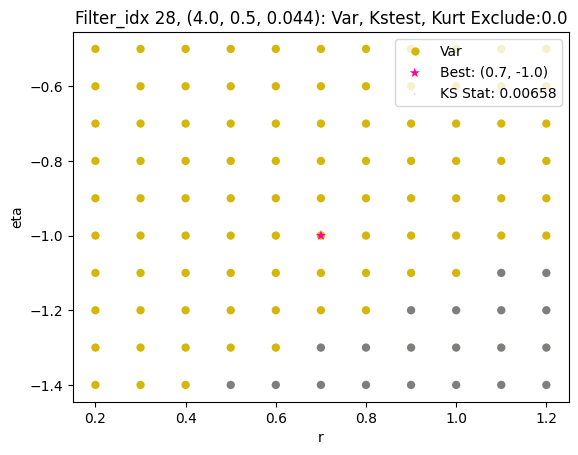

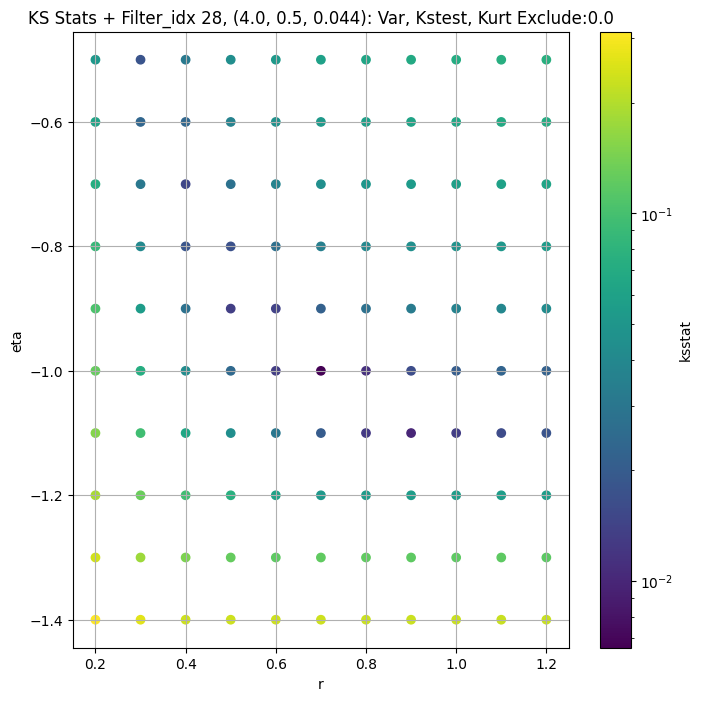

####
Filter_idx, 29: (4.0, 0.5, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 0 0.0079581547035351 17164.06


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 50 0.008951821545604366 16255.083


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 100 0.0076585705370564305 15683.57


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
29 200 0.008107488845696675 14796.015
Number of samples: 100000, Without approximation : 65536000.0


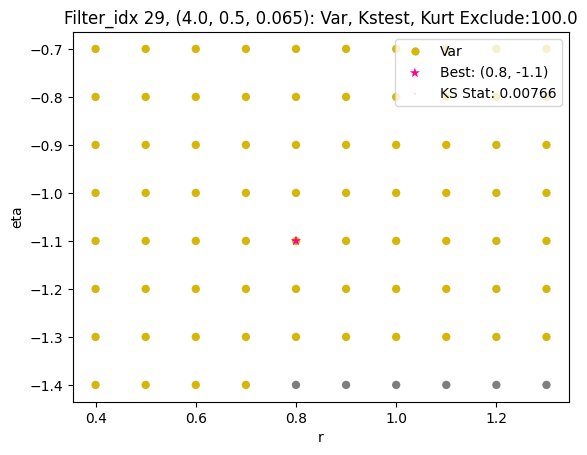

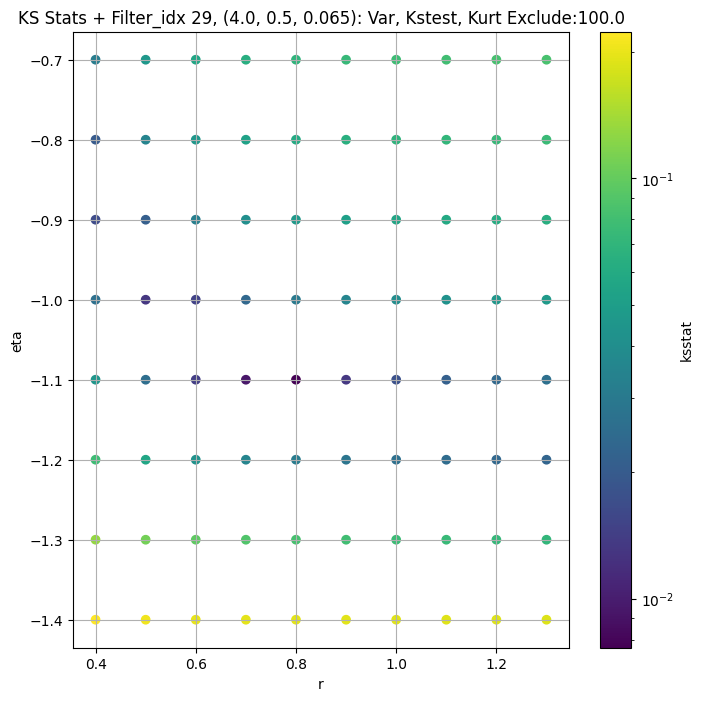

####
Filter_idx, 30: (4.0, 0.5, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 0 0.008113547258176146 5966.472


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 50 0.011271881129430117 5592.968


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 100 0.010133078163621523 5366.459


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
30 200 0.010232027610277972 5018.609
Number of samples: 100000, Without approximation : 65536000.0


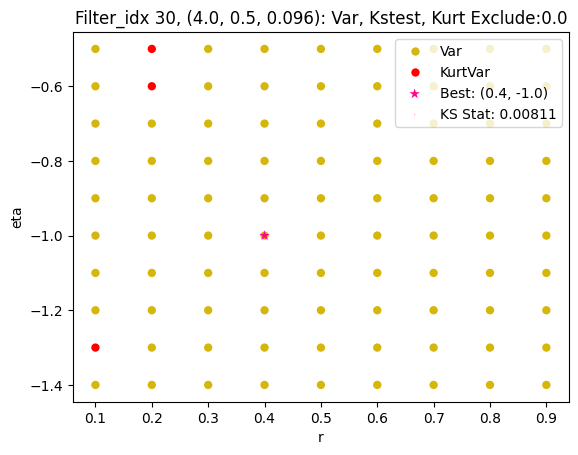

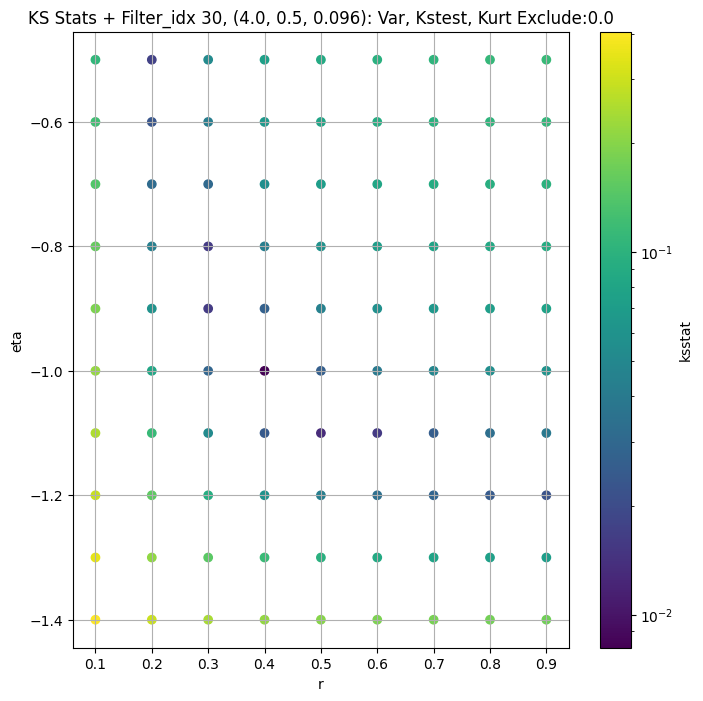

####
Filter_idx, 31: (4.0, 0.5, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 0 0.014078649731443682 2055.4995


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 50 0.013654115121157218 1896.9146


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 100 0.011530406900124524 1802.0267


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
31 200 0.013770450623184494 1660.4397
Number of samples: 100000, Without approximation : 65536000.0


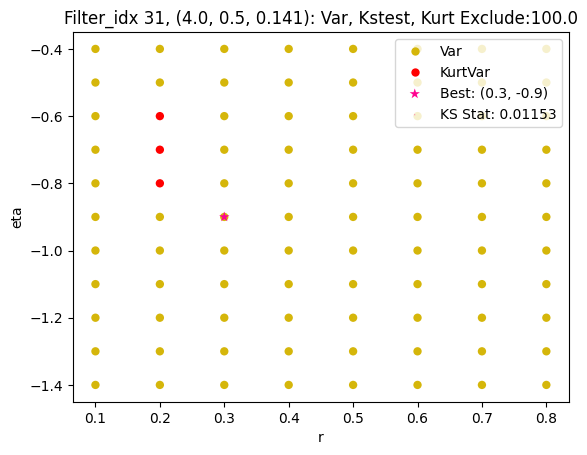

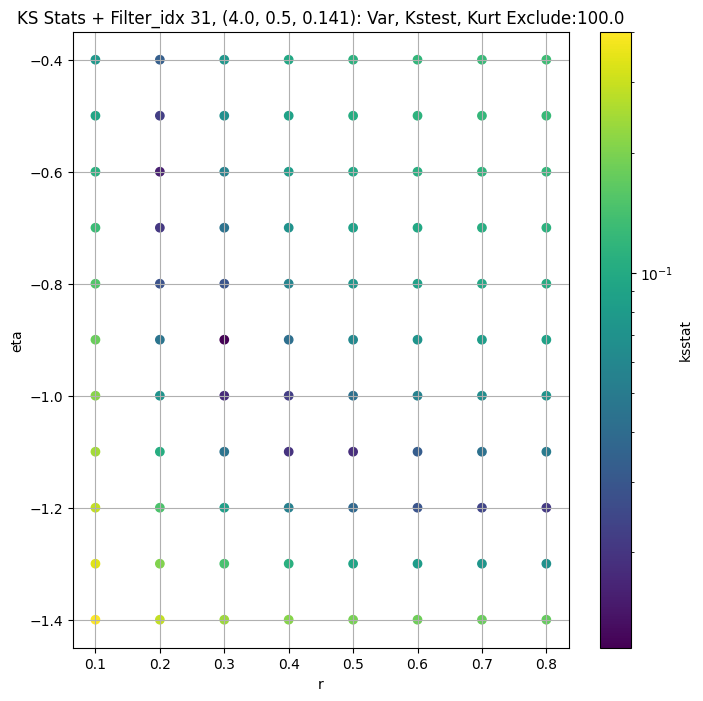

####
Filter_idx, 32: (4.0, 0.5, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 0 0.006734774217793116 839.61536


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 50 0.00987376298179806 757.1035


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 100 0.011201630155215192 713.0312


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
32 200 0.01035881694250329 650.4184
Number of samples: 100000, Without approximation : 65536000.0


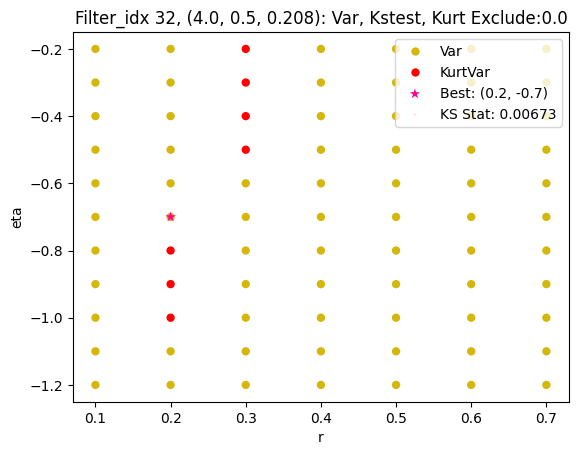

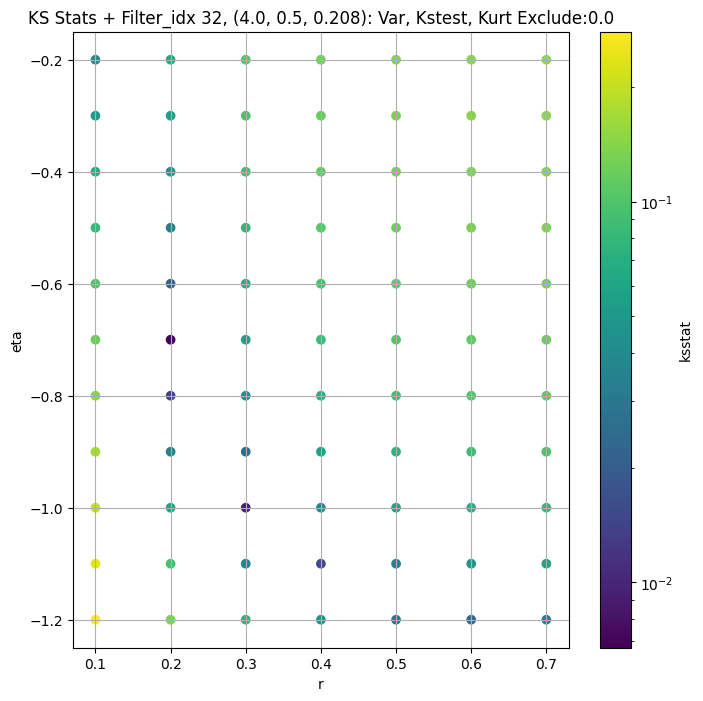

####
Filter_idx, 33: (4.0, 0.5, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 0 0.0053596382632886685 343.61234


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 50 0.008575146432130865 306.50983


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 100 0.006472234722832759 286.83572


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
33 200 0.008155430217664184 258.94946
Number of samples: 100000, Without approximation : 65536000.0


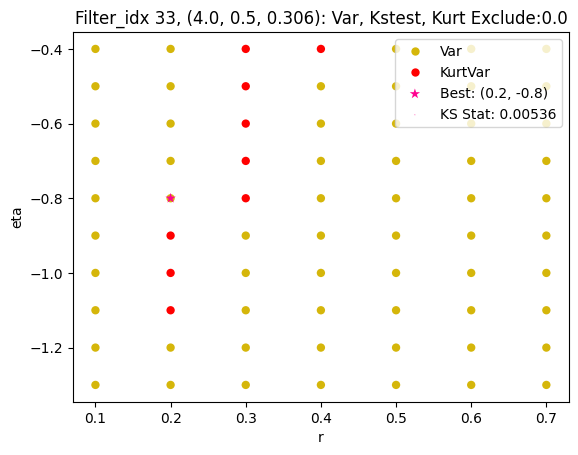

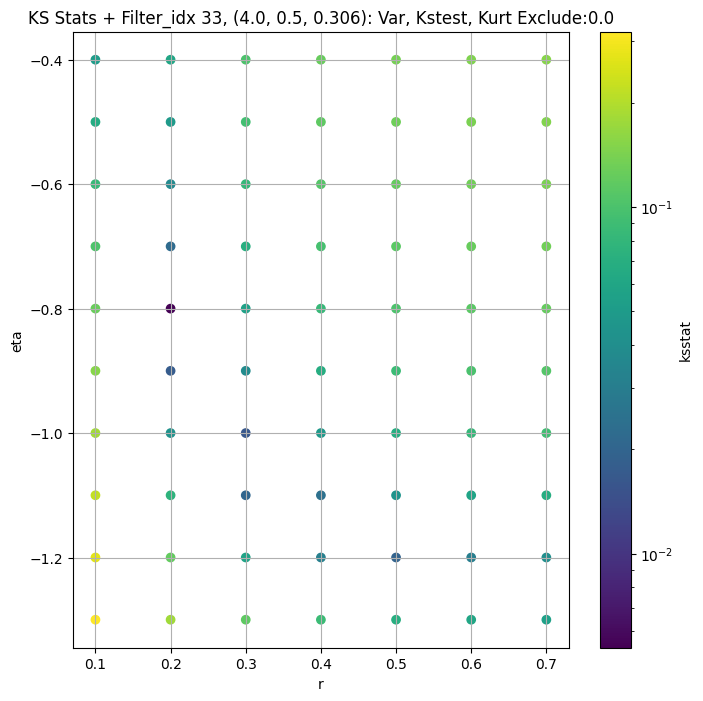

####
Filter_idx, 34: (4.0, 0.5, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 0 0.013523191781082772 155.92847


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 50 0.017705345416170193 138.5095


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 100 0.016181087673654226 128.55435


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
34 200 0.012518085001464674 114.01704
Number of samples: 100000, Without approximation : 65536000.0


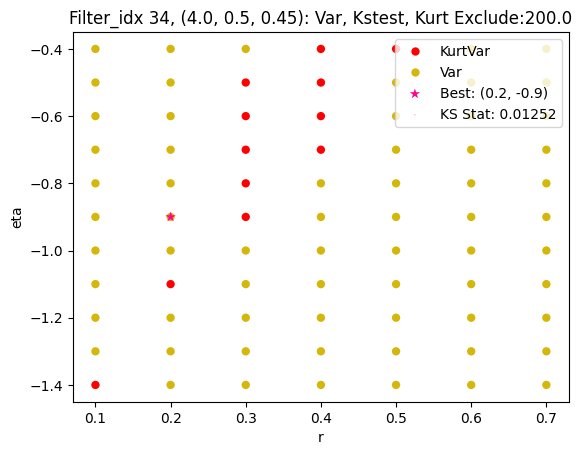

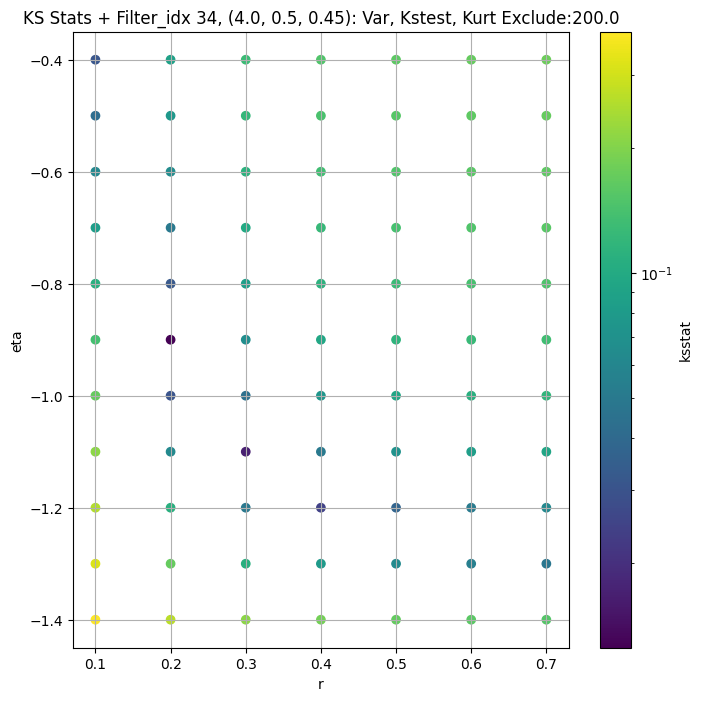

####
Filter_idx, 35: (4.0, 1.0, 0.044)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 0 0.006863412815981906 54964.81


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 50 0.003998780051777673 51426.98


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 100 0.004472271320925814 49263.562


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
35 200 0.005393050093096374 45974.367
Number of samples: 100000, Without approximation : 65536000.0


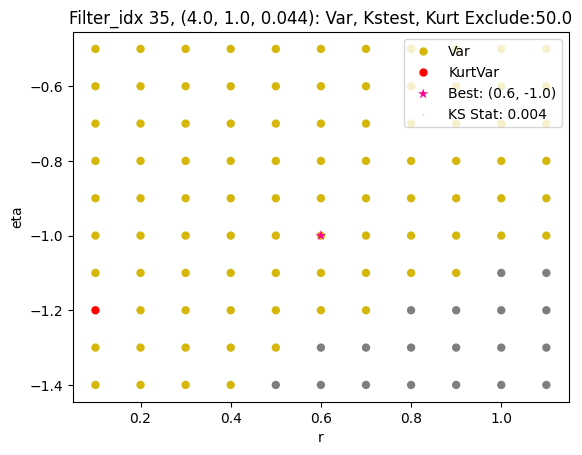

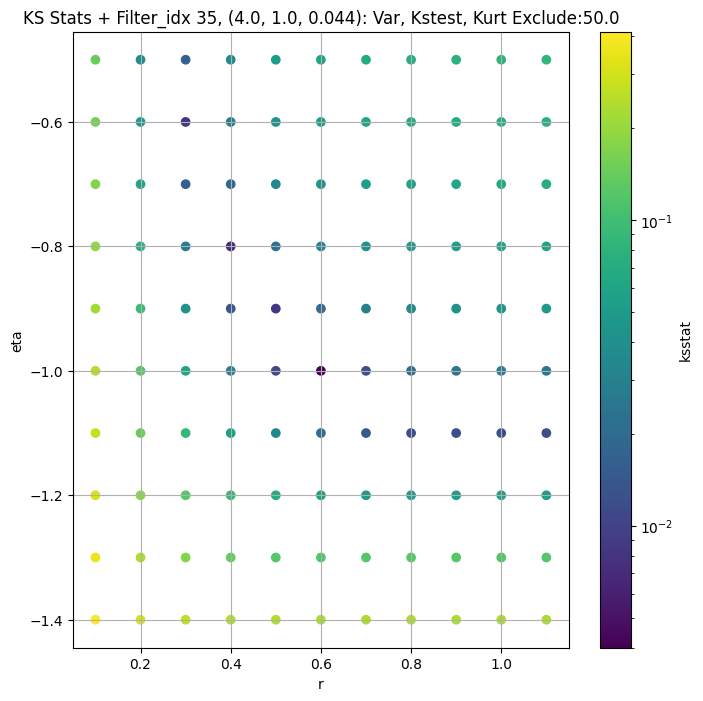

####
Filter_idx, 36: (4.0, 1.0, 0.065)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 0 0.006578909645295783 18656.621


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 50 0.007708764588301609 17314.135


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 100 0.010586671800323355 16440.568


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
36 200 0.008578671570184382 15119.879
Number of samples: 100000, Without approximation : 65536000.0


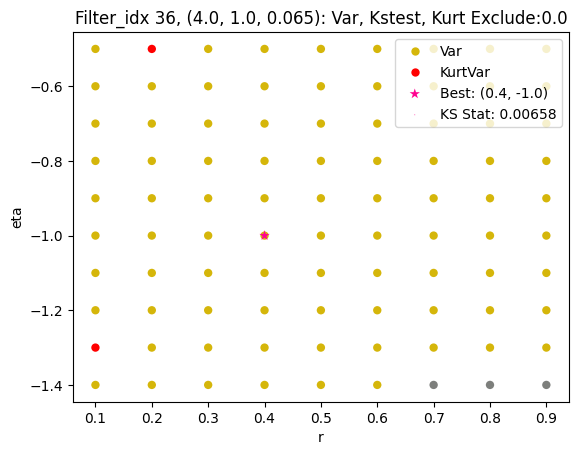

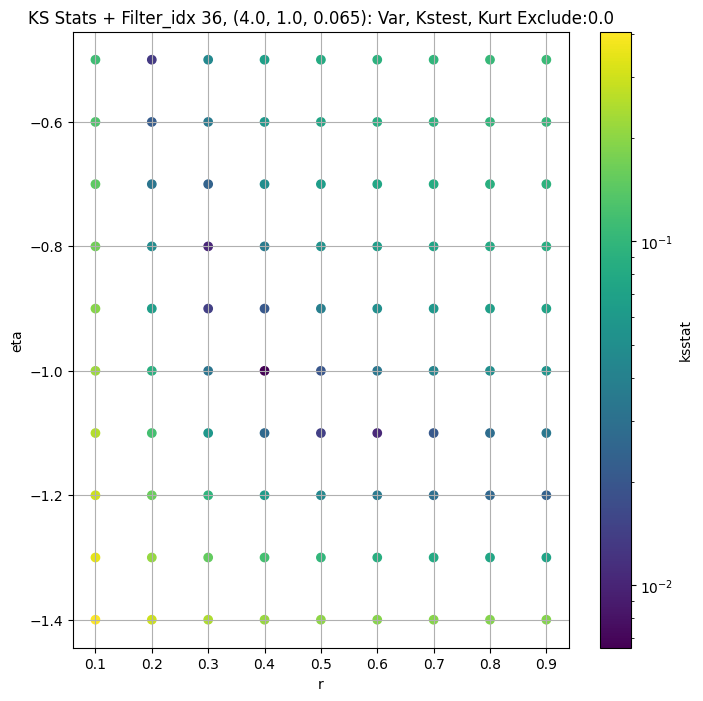

####
Filter_idx, 37: (4.0, 1.0, 0.096)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 0 0.011008011537087081 6984.451


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 50 0.007847070190286187 6267.1772


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 100 0.006479176602721903 5872.866


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
37 200 0.008620634747503464 5304.6655
Number of samples: 100000, Without approximation : 65536000.0


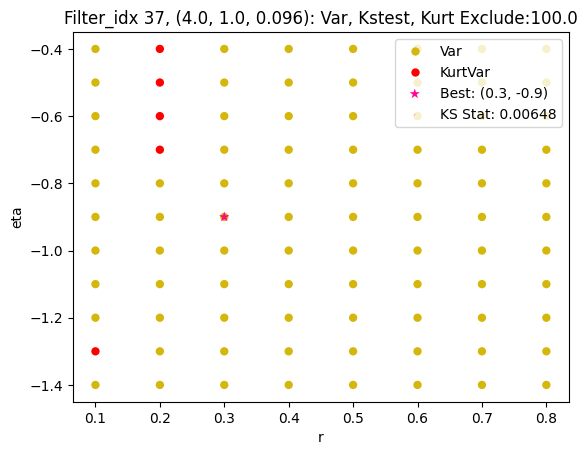

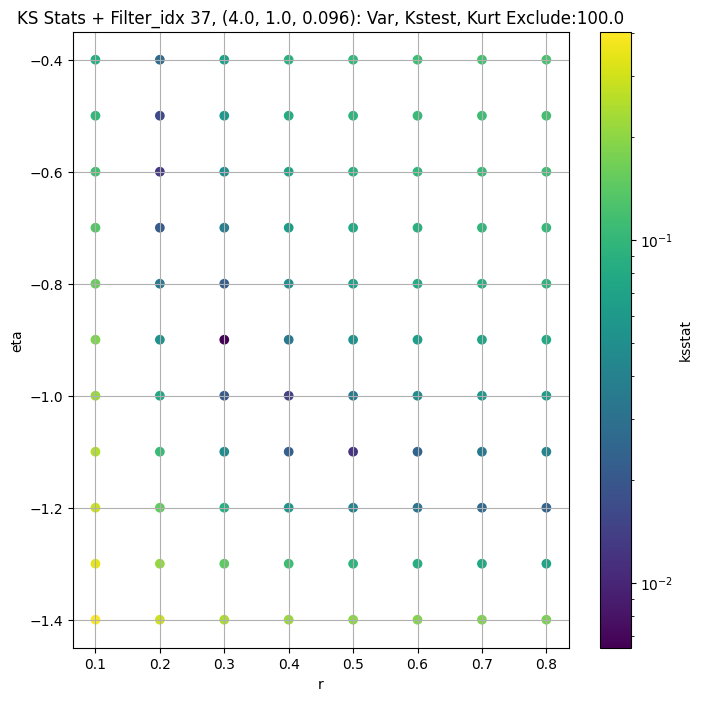

####
Filter_idx, 38: (4.0, 1.0, 0.141)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 0 0.0075616647679424 2525.5208


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 50 0.008593669443812568 2244.842


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 100 0.011576602330327868 2084.1926


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
38 200 0.008252368154128775 1861.3833
Number of samples: 100000, Without approximation : 65536000.0


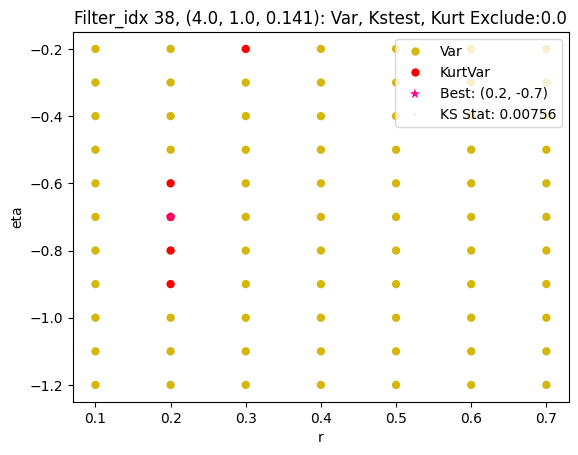

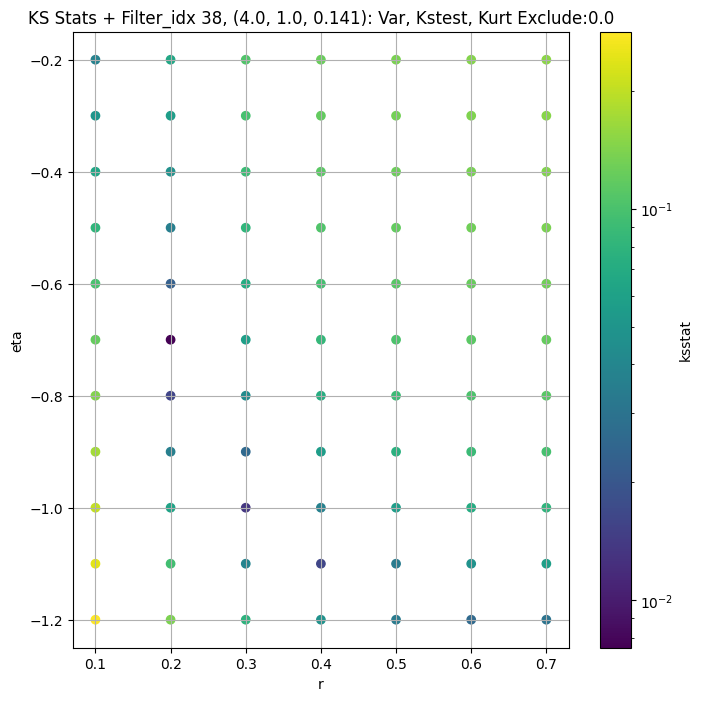

####
Filter_idx, 39: (4.0, 1.0, 0.208)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 0 0.004622094615111982 935.8056


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 50 0.007044917220593749 808.9379


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 100 0.005237322295216562 742.5196


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
39 200 0.008873520059841433 651.1439
Number of samples: 100000, Without approximation : 65536000.0


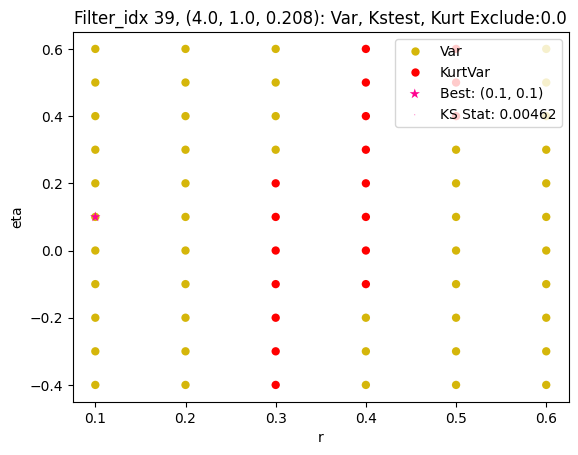

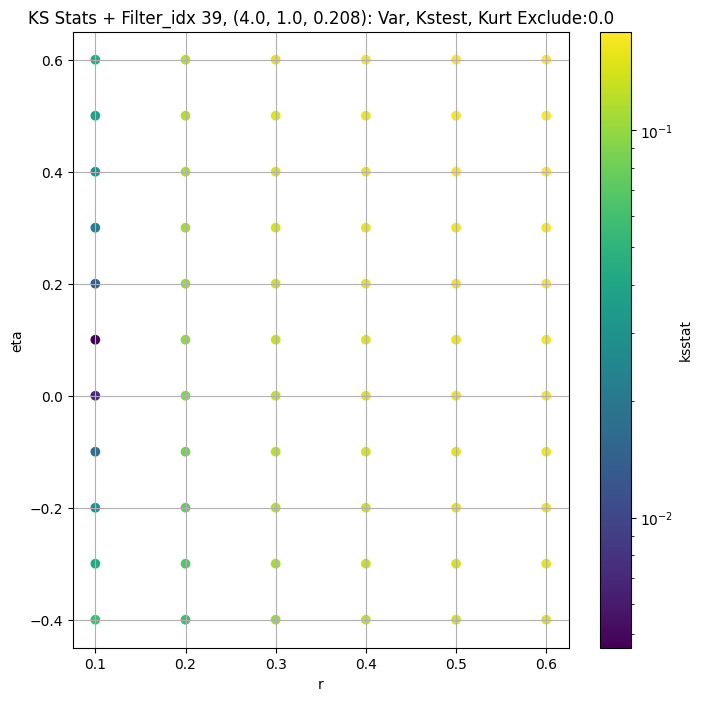

####
Filter_idx, 40: (4.0, 1.0, 0.306)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 0 0.004509793742455706 408.25516


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 50 0.0041155911750957175 346.18604


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 100 0.0043878536837469555 313.97714


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
40 200 0.005466762069883613 271.2839
Number of samples: 100000, Without approximation : 65536000.0


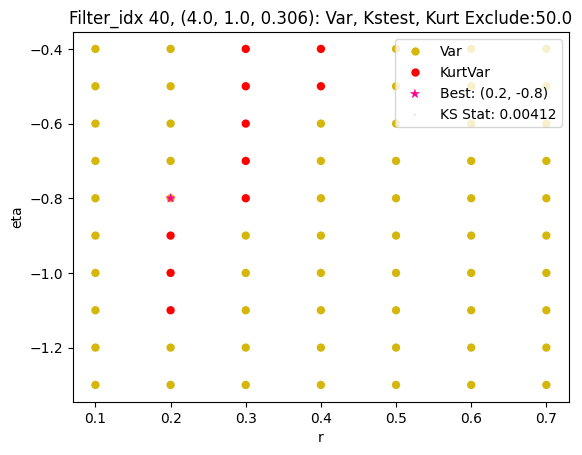

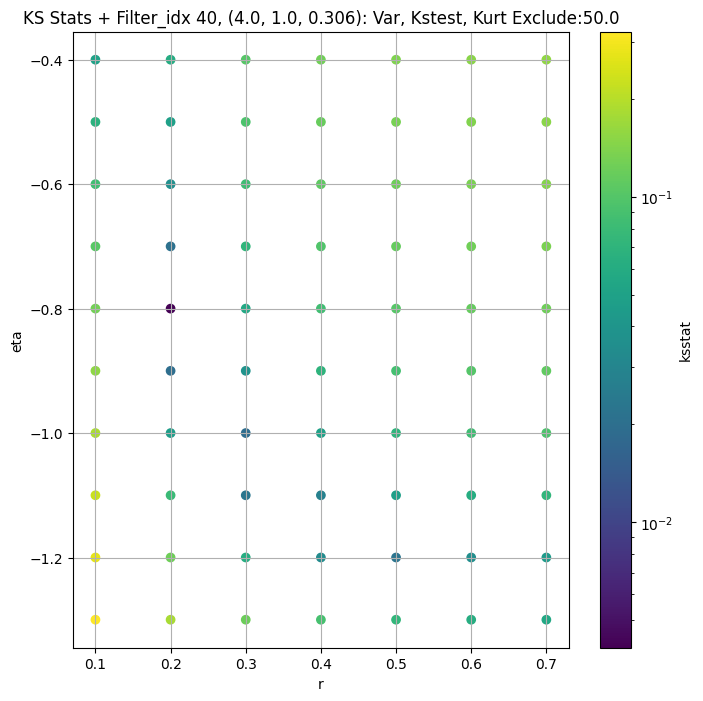

####
Filter_idx, 41: (4.0, 1.0, 0.45)


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 0 0.011014748314264244 161.35173


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 50 0.013864914730972178 132.46962


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 100 0.011873309446216784 117.86723


  0%|          | 0/12760 [00:00<?, ?it/s]

Finding Minimum after computing 12760 CDFs
41 200 0.011780182338179873 99.98548
Number of samples: 100000, Without approximation : 65536000.0


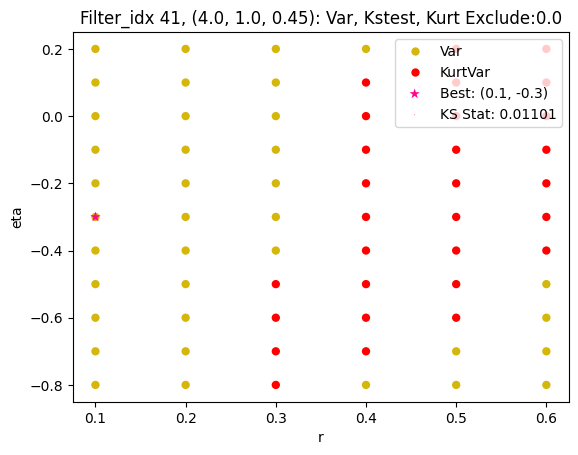

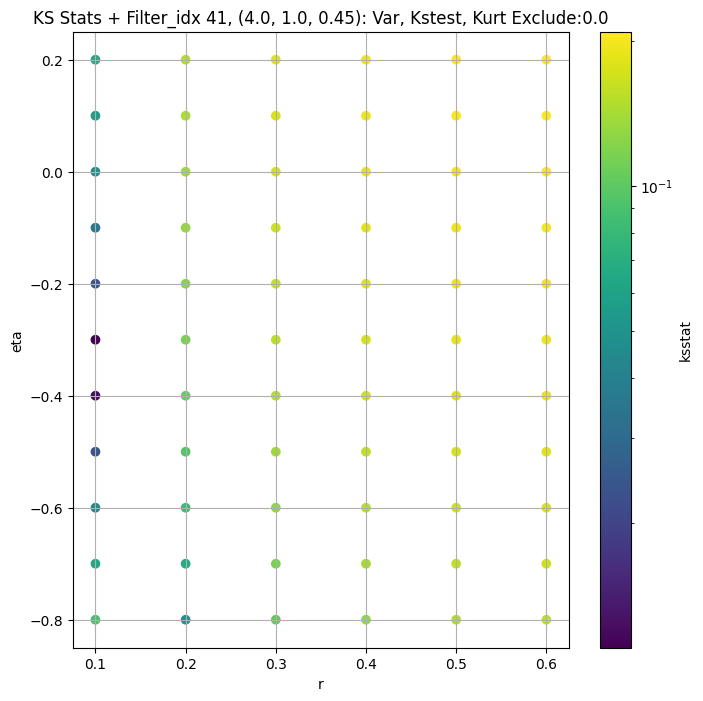

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,initial_r,initial_eta,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05
filter_idx,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",55335.40000,43910.880000,67200.02000,4.569961,2.753132,10.063652,65536000.0,"(2.0, 0.5, 0.044)",0.009377,0.8,-1.0,8.054667e+04,50.0,53534.94500,0.000168
1,"(2.0, 0.5, 0.065)",19047.67000,14847.801000,24242.93000,6.379718,3.746185,14.553737,65536000.0,"(2.0, 0.5, 0.065)",0.006850,0.7,-1.1,2.968734e+04,0.0,19047.67000,0.000168
2,"(2.0, 0.5, 0.096)",6874.37450,5331.145000,8745.57600,7.939266,4.336729,17.756517,65536000.0,"(2.0, 0.5, 0.096)",0.007515,0.6,-1.1,7.818248e+03,0.0,6874.37450,0.000168
3,"(2.0, 0.5, 0.141)",2517.88000,1859.195700,3329.25050,11.032557,5.883101,26.747358,65536000.0,"(2.0, 0.5, 0.141)",0.009173,0.5,-1.1,1.748528e+03,0.0,2517.88000,0.000168
4,"(2.0, 0.5, 0.208)",960.38640,676.863200,1276.19180,13.725231,7.874681,37.101093,65536000.0,"(2.0, 0.5, 0.208)",0.009045,0.3,-0.9,2.139619e+01,100.0,858.60690,0.000168
5,"(2.0, 0.5, 0.306)",337.90594,225.185470,464.41925,17.738790,8.973111,45.261600,65536000.0,"(2.0, 0.5, 0.306)",0.007586,0.3,-1.0,1.176462e+01,50.0,312.76904,0.000168
6,"(2.0, 0.5, 0.45)",228.05840,158.856740,316.73297,16.143604,8.750346,45.505930,65536000.0,"(2.0, 0.5, 0.45)",0.010307,0.4,-1.1,6.060490e+01,100.0,201.41135,0.000168
7,"(2.0, 1.0, 0.044)",75053.41000,60645.383000,93151.82000,5.436268,3.062418,13.906753,65536000.0,"(2.0, 1.0, 0.044)",0.007652,0.6,-0.9,4.988344e+04,0.0,75053.41000,0.000168
8,"(2.0, 1.0, 0.065)",27106.73800,20925.596000,34942.88700,7.330939,3.835541,21.208311,65536000.0,"(2.0, 1.0, 0.065)",0.004748,0.6,-1.0,2.301723e+04,0.0,27106.73800,0.000168


In [12]:
master_df_combo_path = Path(os.path.join(CWD, "CSVs", "master_df_combo.csv"))
rEtaKsstats_dict_path = Path(os.path.join(CWD, "cache", "rEtaKsstats_dict.pickle"))

rEtaKsstats_dict = dict()

if RERUN or not master_df_combo_path.exists():
    sorted_params = sorted(all_cdfs)
    ksstats_dict = dict()

    for i, group in enumerate(GROUPS): # TODO For quick testing purposes
        print(f"####\n{GROUP.capitalize()}, {group}: {str(filter_group_map[group])}")
        sample = group_data_map[group]
        if len(sample) == 0:
            continue
        group_cdfs_df = all_cdfs_df.copy()
        master_df.loc[group, 'kstest_stat_initial'] = 1

        for j in range(len(EXCLUDE_CUTOFFS)):

            exclude_cutoff = EXCLUDE_CUTOFFS[j]
            exclude_cutoff = int(exclude_cutoff)

            if exclude_cutoff == 0:
                augmented_var = np.var(group_data_map[group]) 
            else:
                augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])
                if augmented_var == np.var(group_data_map[group]):
                    continue 
                
            group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
            ksstats, initial_param, min_stat = gridsearch(sample, all_cdfs, debug=True, scales=group_cdfs_df['scale'])
            augmented_var_df.loc[group, f"kstest_stat_{exclude_cutoff}"] = min_stat
            group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] = ksstats
            
            print(group, exclude_cutoff, min_stat, augmented_var)
            
            if (min_stat < master_df.loc[group, 'kstest_stat_initial']) and not np.isclose(min_stat, master_df.loc[group, 'kstest_stat_initial'], 1e-6):
                inital_min_stat = min_stat
                inital_best_param = initial_param
                master_df.loc[group, 'kstest_stat_initial'] = min_stat
                initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                master_df.loc[group, 'initial_r'], master_df.loc[group, 'initial_eta'] = initial_param
                master_df.loc[group, 'initial_scale'] = initial_scale
                master_df.loc[group, 'initial_exclude_cutoff'] = exclude_cutoff
                master_df.loc[group, 'best_augmented_var'] = augmented_var
        
        ksstats = group_cdfs_df[f"ksstat_exclude_{int(master_df.loc[group, 'initial_exclude_cutoff'])}"]
            
        print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
        
        cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
        master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

        best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

        group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
        group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

        group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

        group_dict = {'r' : group_cdfs_df['r'], 'eta' : group_cdfs_df['eta']}
        group_dict.update({f'ksstat_exclude_{exclude_cutoff}' : group_cdfs_df[f'ksstat_exclude_{exclude_cutoff}'] for exclude_cutoff in EXCLUDE_CUTOFFS[:j+1]})
        rEtaKsstats_dict[group] = group_dict

        cols = ['pass_var', 'pass_kstest', 'pass_kurt']

        fig = combo_test_plot(group_cdfs_df, cols, 
                            plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: {', '.join([col[5:].capitalize() for col in cols])} Exclude:{master_df.loc[group, 'initial_exclude_cutoff']}", 
                            target_var = None,
                            best_param = inital_best_param,
                            best_ksstat=inital_min_stat
                            )
        
        fig.figure.savefig(os.path.join(CWD, "plots", f"full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)

        # Optional: 
        # Create plots of bootstrapped variance and kurtosis for varying confidence intervals
        # fig_var = create_ci_scatter_plot(group_cdfs_df, var_values_dict, metric='variance', group=group)
        # fig_kurt = create_ci_scatter_plot(group_cdfs_df, kurt_values_dict, metric='kurtosis', group=group)

        # fig_var.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_var)
        # fig_kurt.savefig(os.path.join(CWD, "plots", f"ci_scatter_variance_{GROUP}_{group}_bootstrap{n_bootstrap}.jpg"), bbox_inches='tight')
        # plt.close(fig_kurt)

    # new: add parameter information
    master_df.insert(0, 'params', master_df.index.map(filter_group_map))

    master_df.to_csv(master_df_combo_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)
    augmented_var_df.to_csv(augmented_var_df_path)

augmented_var_df = pd.read_csv(augmented_var_df_path, index_col=GROUP)
master_df = pd.read_csv(master_df_combo_path, index_col=GROUP)
rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df

## Optimization

In [13]:
master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
master_df[f'best_r'] = master_df['initial_r']
master_df[f'best_eta'] = master_df['initial_eta']
master_df[f'best_scale'] = master_df['initial_scale']
master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

Filter_idx 0, (2.0, 0.5, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 50.0 + 100 = 150, ksstat: 0.00964741792274093, var: 51261.921875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 50.0 + 75 = 125, ksstat: 0.009052421675893263, var: 51774.375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 50.0 + 50 = 100, ksstat: 0.008857943259708997, var: 52317.87890625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 50.0 + 25 = 75, ksstat: 0.008255587191653146, var: 52899.30078125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 50.0 + 0 = 50, ksstat: 0.008255587191653146, var: 53534.9453125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 50.0 + -25 = 25, ksstat: 0.008255587191653146, var: 54266.5


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 0, 50.0 + -50 = 0, ksstat: 0.007650069884566846, var: 55335.3984375
Number of samples: 100000, Without approximation : 65536000.0


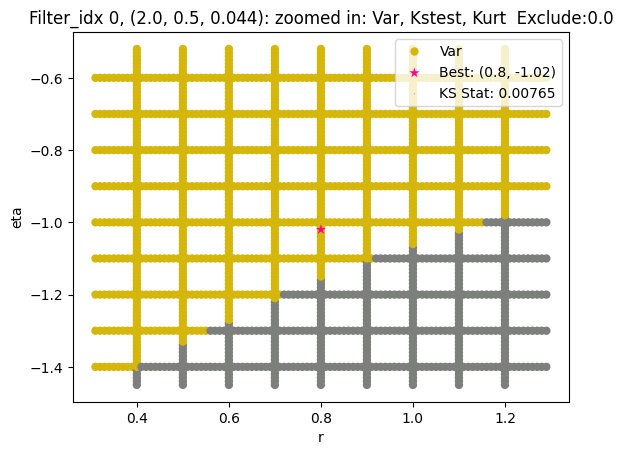

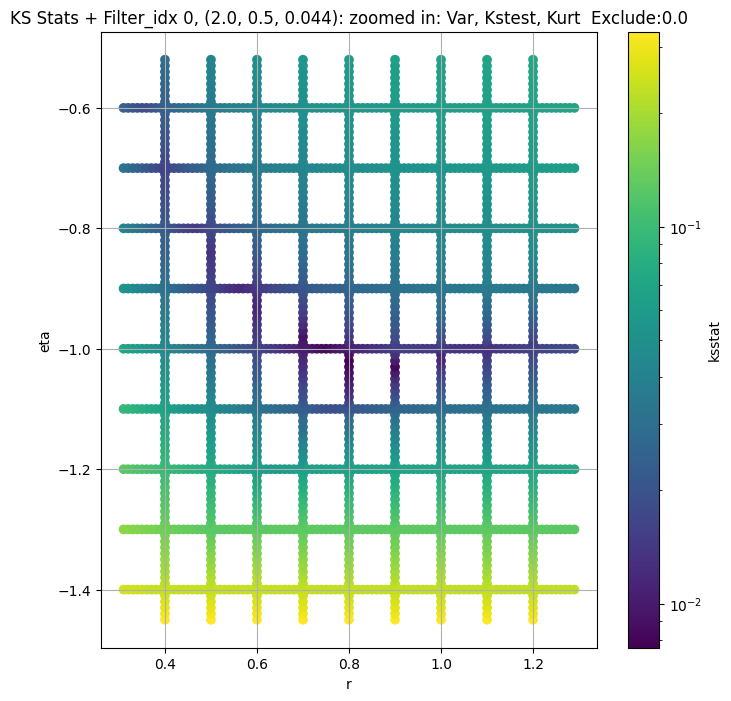

Filter_idx 1, (2.0, 0.5, 0.065):


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 1, 0.0 + 100 = 100, ksstat: 0.00616408434815776, var: 17796.328125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 1, 0.0 + 75 = 75, ksstat: 0.006434172151808193, var: 18035.4609375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 1, 0.0 + 50 = 50, ksstat: 0.0063253241723488784, var: 18298.376953125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 1, 0.0 + 25 = 25, ksstat: 0.005517345908666663, var: 18597.369140625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 1, 0.0 + 0 = 0, ksstat: 0.005591983283592672, var: 19047.669921875
Number of samples: 100000, Without approximation : 65536000.0


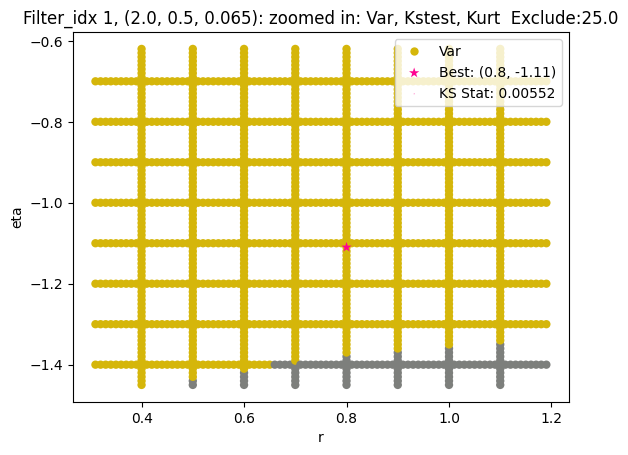

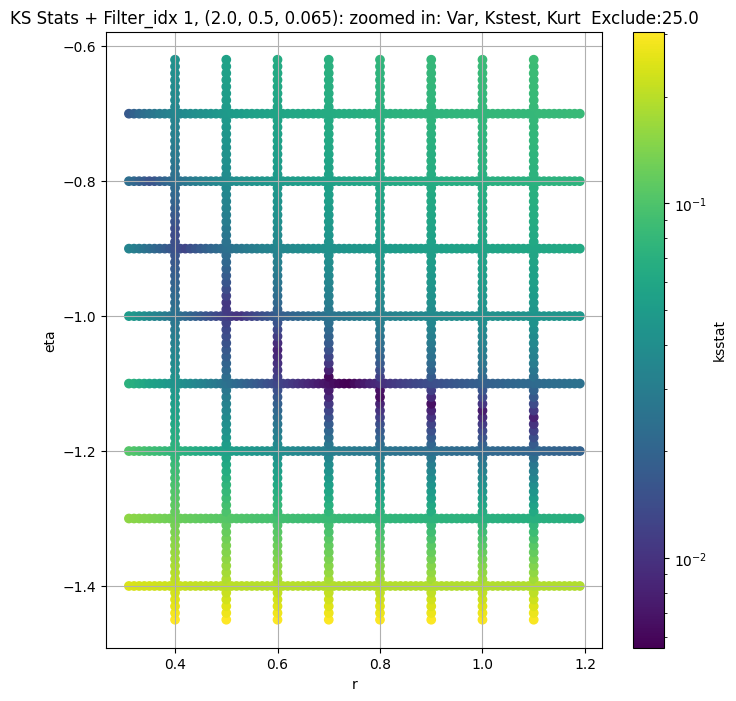

Filter_idx 2, (2.0, 0.5, 0.096):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 0.0 + 100 = 100, ksstat: 0.007289545511088055, var: 6363.77783203125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 0.0 + 75 = 75, ksstat: 0.006910970787671666, var: 6462.26025390625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 0.0 + 50 = 50, ksstat: 0.007002258846717124, var: 6569.1982421875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 0.0 + 25 = 25, ksstat: 0.006485854019114001, var: 6692.85888671875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 2, 0.0 + 0 = 0, ksstat: 0.007135949777636319, var: 6874.37451171875
Number of samples: 100000, Without approximation : 65536000.0


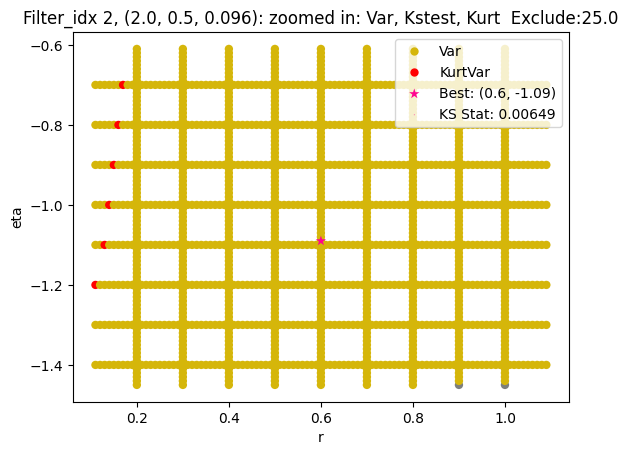

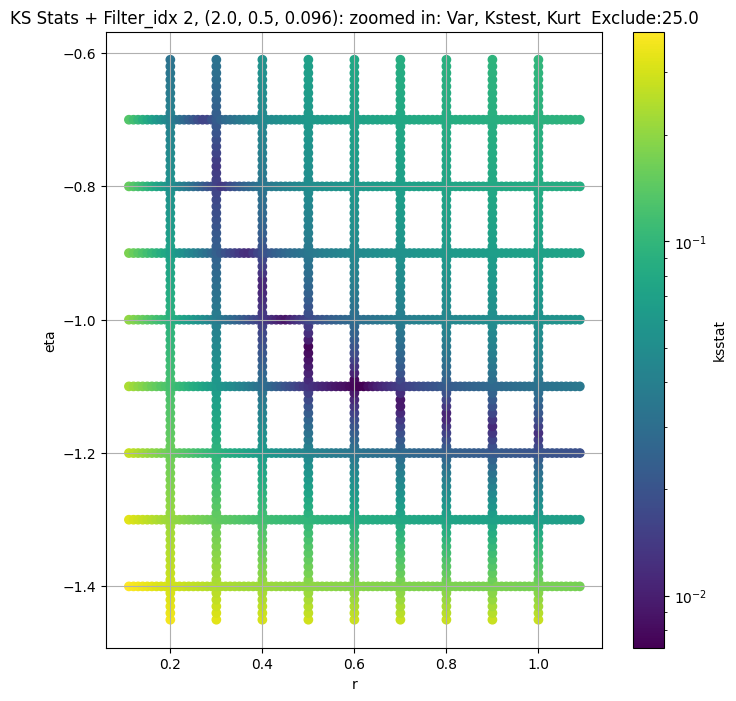

Filter_idx 3, (2.0, 0.5, 0.141):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 0.0 + 100 = 100, ksstat: 0.008673285196913016, var: 2282.41259765625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 0.0 + 75 = 75, ksstat: 0.008568183603813284, var: 2326.818115234375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 0.0 + 50 = 50, ksstat: 0.008262157027907113, var: 2375.74609375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 0.0 + 25 = 25, ksstat: 0.008200735403760429, var: 2432.115234375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 3, 0.0 + 0 = 0, ksstat: 0.007212723224030895, var: 2517.8798828125
Number of samples: 100000, Without approximation : 65536000.0


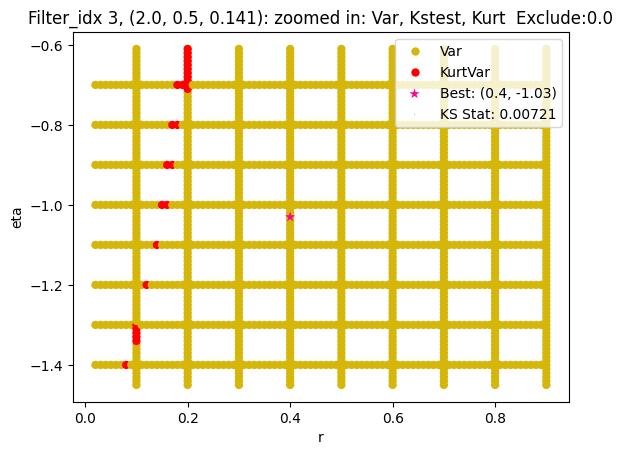

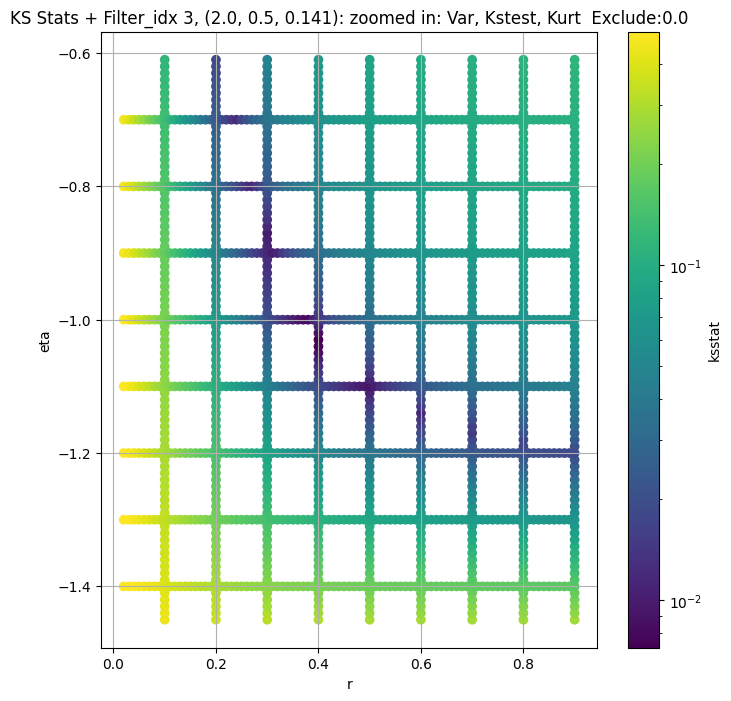

Filter_idx 4, (2.0, 0.5, 0.208):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + 100 = 200, ksstat: 0.007711036517847769, var: 796.6046752929688


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + 75 = 175, ksstat: 0.008143020137255812, var: 810.686279296875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + 50 = 150, ksstat: 0.007787393262230456, var: 825.5840454101562


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + 25 = 125, ksstat: 0.007416759540289031, var: 841.4937133789062


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + 0 = 100, ksstat: 0.006802800435680045, var: 858.6068725585938


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + -25 = 75, ksstat: 0.006368994575897707, var: 877.1549072265625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + -50 = 50, ksstat: 0.006823965941403665, var: 898.0994873046875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + -75 = 25, ksstat: 0.006409784432961141, var: 922.9041748046875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 4, 100.0 + -100 = 0, ksstat: 0.005809800424967038, var: 960.3864135742188
Number of samples: 100000, Without approximation : 65536000.0


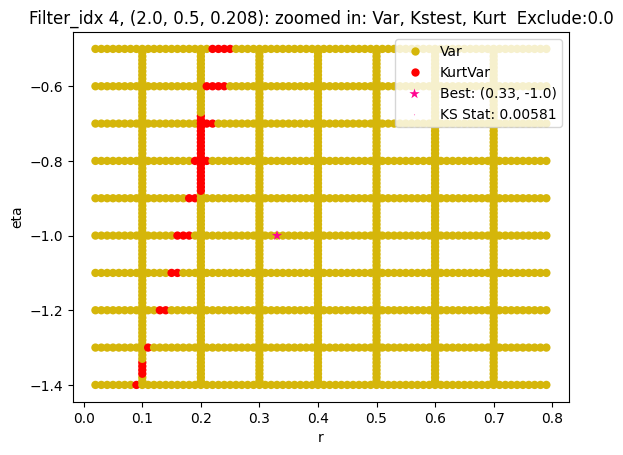

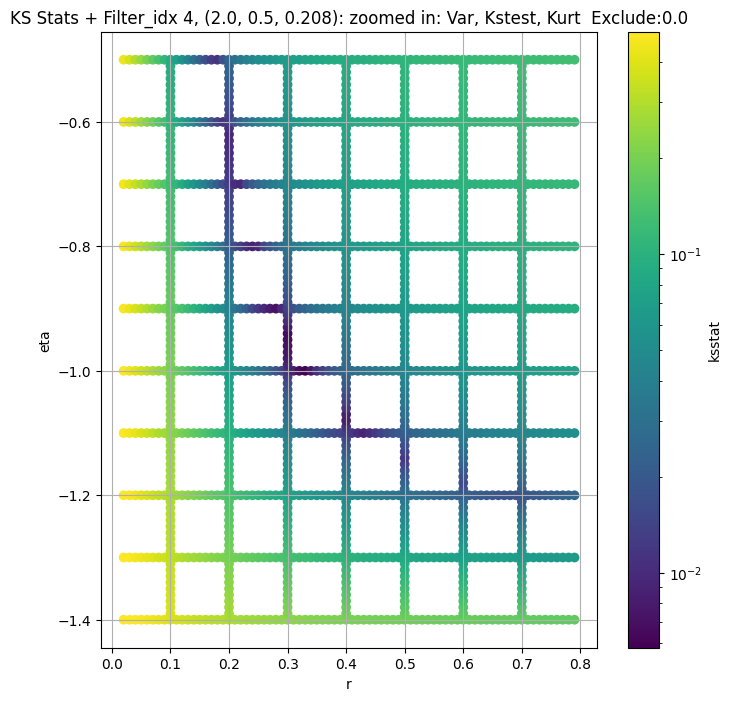

Filter_idx 5, (2.0, 0.5, 0.306):


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 5, 50.0 + 100 = 150, ksstat: 0.0075843682442320315, var: 281.8500061035156


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 5, 50.0 + 75 = 125, ksstat: 0.007582589742178902, var: 288.5711975097656


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 5, 50.0 + 50 = 100, ksstat: 0.007583053513954496, var: 295.86163330078125


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 5, 50.0 + 25 = 75, ksstat: 0.007583542833551671, var: 303.8572998046875


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 5, 50.0 + 0 = 50, ksstat: 0.007584065950090646, var: 312.76904296875


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 5, 50.0 + -25 = 25, ksstat: 0.007586916626273199, var: 322.8714294433594


  0%|          | 0/1304 [00:00<?, ?it/s]

Finding Minimum after computing 1304 CDFs
filter_idx 5, 50.0 + -50 = 0, ksstat: 0.007585291469476341, var: 337.90594482421875
Number of samples: 100000, Without approximation : 65536000.0


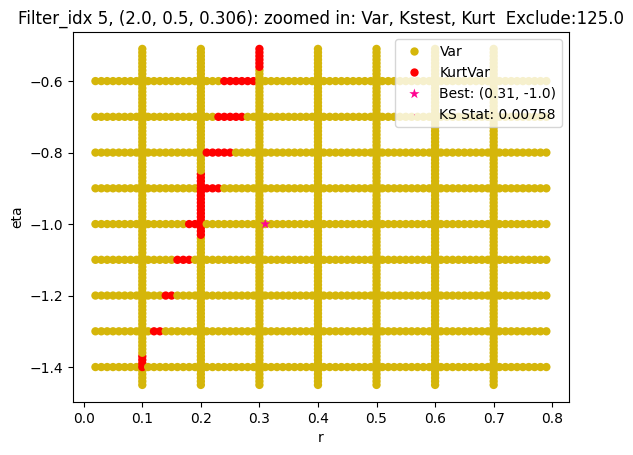

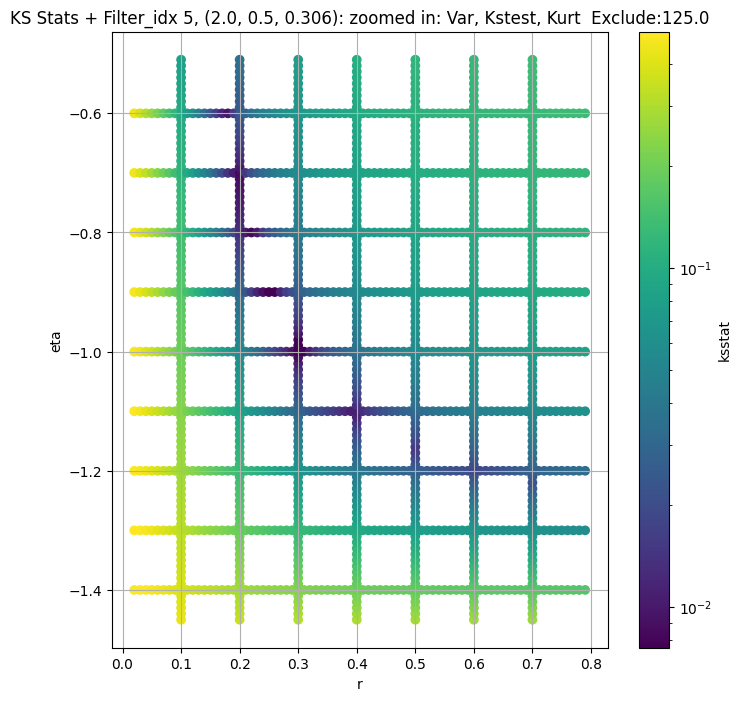

Filter_idx 6, (2.0, 0.5, 0.45):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 100.0 + 100 = 200, ksstat: 0.010298368048351603, var: 184.80809020996094


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 100.0 + 75 = 175, ksstat: 0.010297245718356662, var: 188.53025817871094


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 100.0 + 50 = 150, ksstat: 0.010297689647952801, var: 192.50730895996094


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 100.0 + 25 = 125, ksstat: 0.010298151781997722, var: 196.7826385498047


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 100.0 + 0 = 100, ksstat: 0.010298635430835423, var: 201.41134643554688


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 100.0 + -25 = 75, ksstat: 0.010307633275372319, var: 206.485107421875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 100.0 + -50 = 50, ksstat: 0.010296362101768208, var: 212.14166259765625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 100.0 + -75 = 25, ksstat: 0.010297000728142991, var: 218.49008178710938


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 6, 100.0 + -100 = 0, ksstat: 0.010296053115649184, var: 228.0583953857422
Number of samples: 100000, Without approximation : 65536000.0


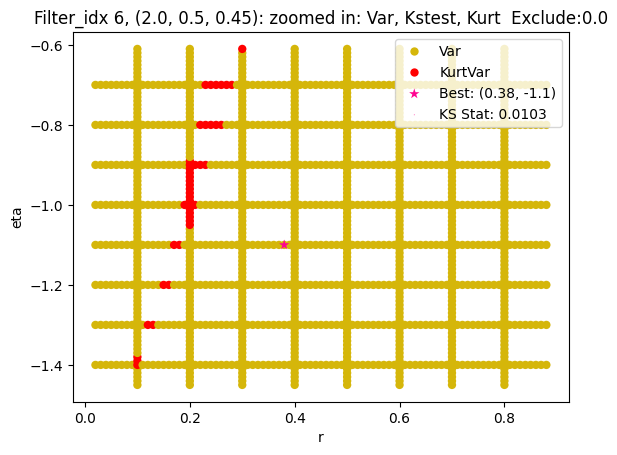

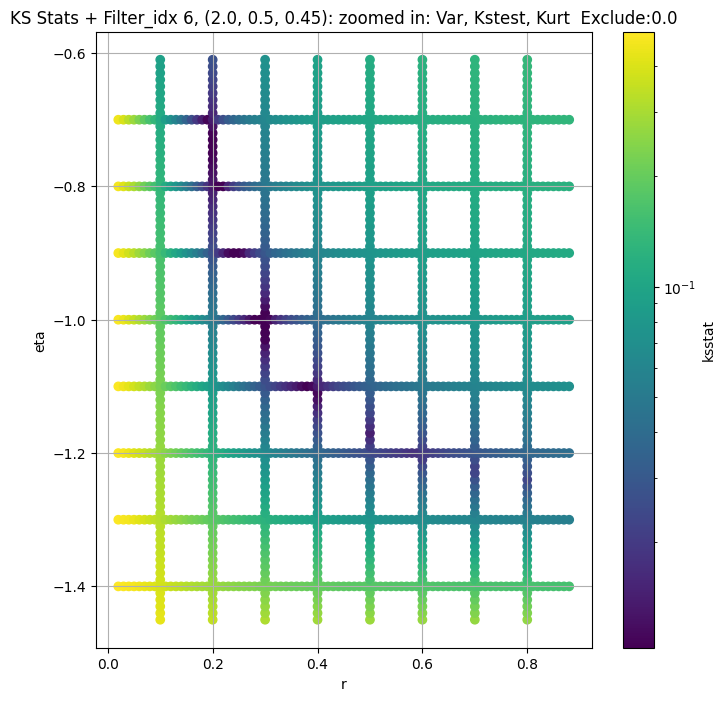

Filter_idx 7, (2.0, 1.0, 0.044):


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 7, 0.0 + 100 = 100, ksstat: 0.005520168353716957, var: 70305.6328125


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 7, 0.0 + 75 = 75, ksstat: 0.004955763367246124, var: 71221.40625


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 7, 0.0 + 50 = 50, ksstat: 0.005230838338588062, var: 72229.5546875


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 7, 0.0 + 25 = 25, ksstat: 0.005230838338588062, var: 73373.265625


  0%|          | 0/1800 [00:00<?, ?it/s]

Finding Minimum after computing 1800 CDFs
filter_idx 7, 0.0 + 0 = 0, ksstat: 0.004739258092807508, var: 75053.40625
Number of samples: 100000, Without approximation : 65536000.0


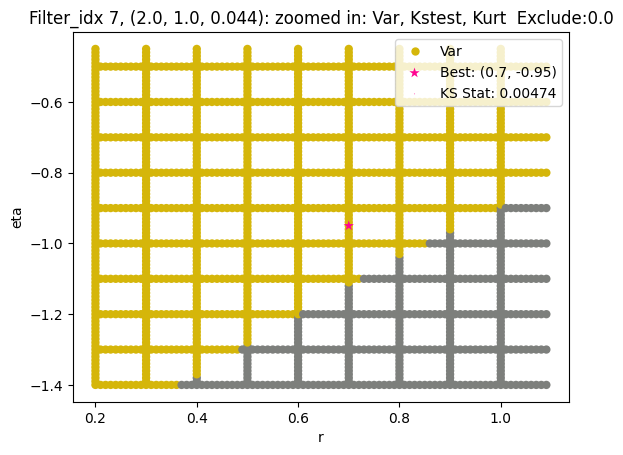

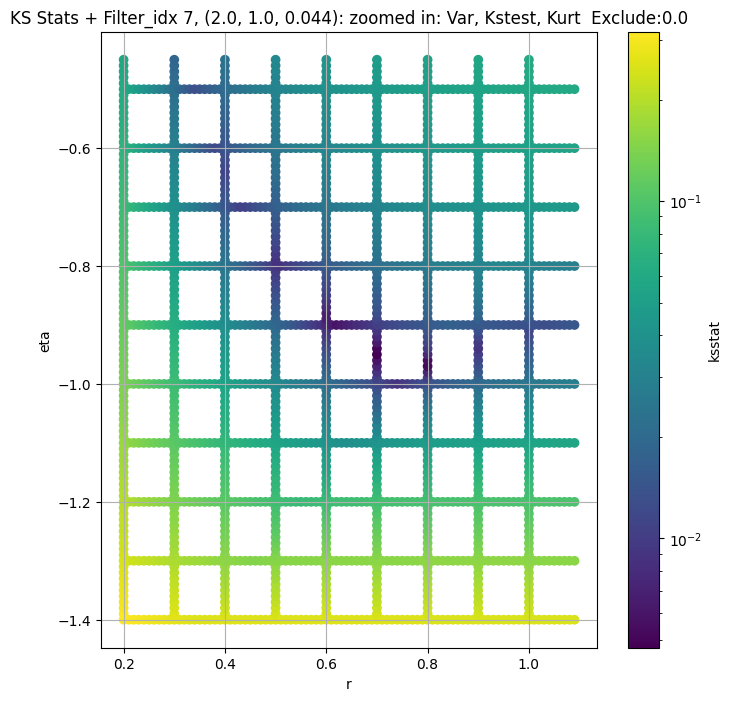

Filter_idx 8, (2.0, 1.0, 0.065):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 0.0 + 100 = 100, ksstat: 0.004239193558826959, var: 25059.2421875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 0.0 + 75 = 75, ksstat: 0.003908796203210829, var: 25443.62890625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 0.0 + 50 = 50, ksstat: 0.0038002949368909356, var: 25870.931640625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 0.0 + 25 = 25, ksstat: 0.0034258300222187454, var: 26364.05859375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 8, 0.0 + 0 = 0, ksstat: 0.003147788438383703, var: 27106.73828125
Number of samples: 100000, Without approximation : 65536000.0


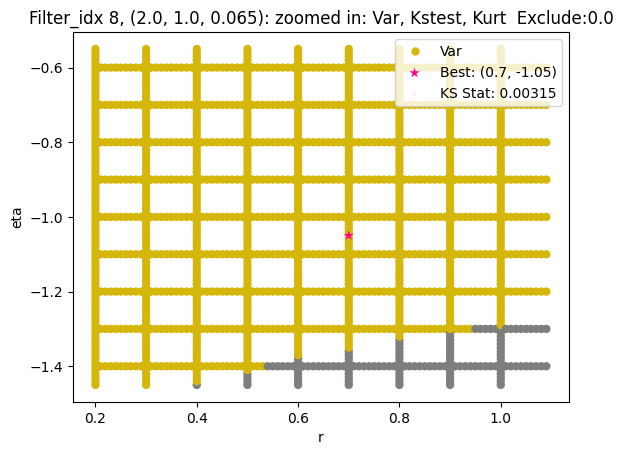

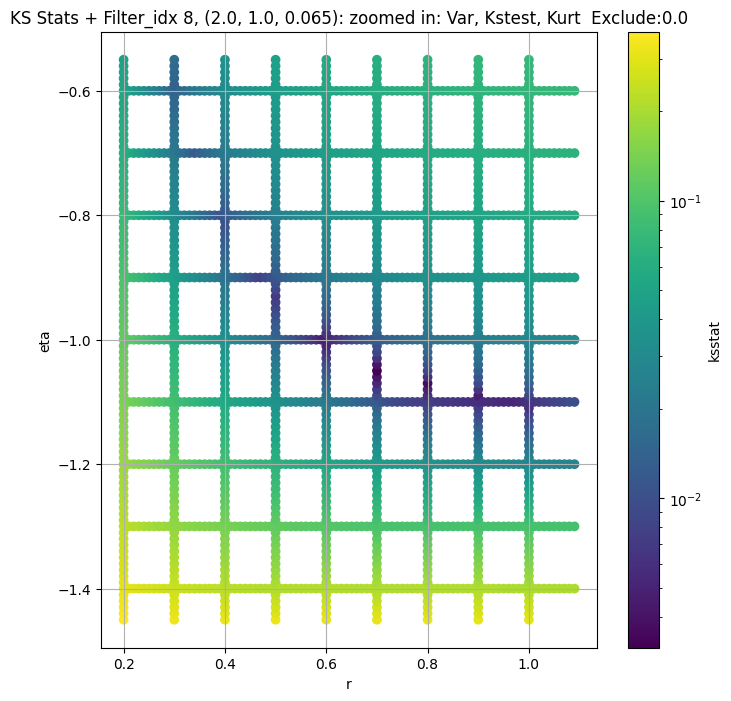

Filter_idx 9, (2.0, 1.0, 0.096):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + 100 = 300, ksstat: 0.006409201561501782, var: 7651.435546875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + 75 = 275, ksstat: 0.006102048987546405, var: 7745.48779296875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + 50 = 250, ksstat: 0.0057892832447675735, var: 7843.63525390625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + 25 = 225, ksstat: 0.005705032203272342, var: 7946.21826171875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + 0 = 200, ksstat: 0.00563180503355111, var: 8054.158203125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + -25 = 175, ksstat: 0.005285947751239473, var: 8168.5478515625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + -50 = 150, ksstat: 0.005110273443438618, var: 8290.7060546875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + -75 = 125, ksstat: 0.004926012641021771, var: 8422.33984375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 9, 200.0 + -100 = 100, ksstat: 0.0048136564535794235, var: 8565.4912109375
Number of samples: 100000, Without approximation : 65536000.0


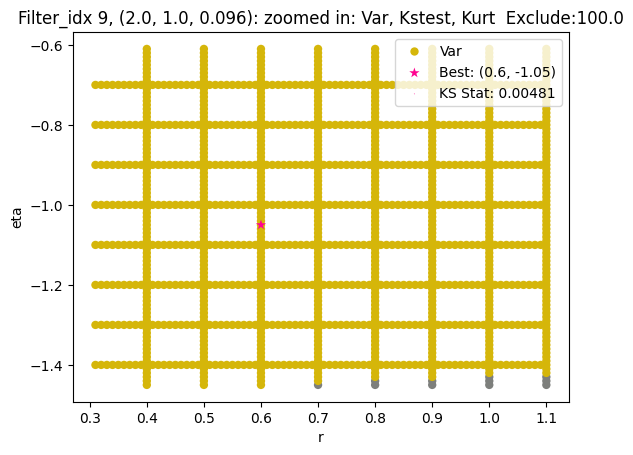

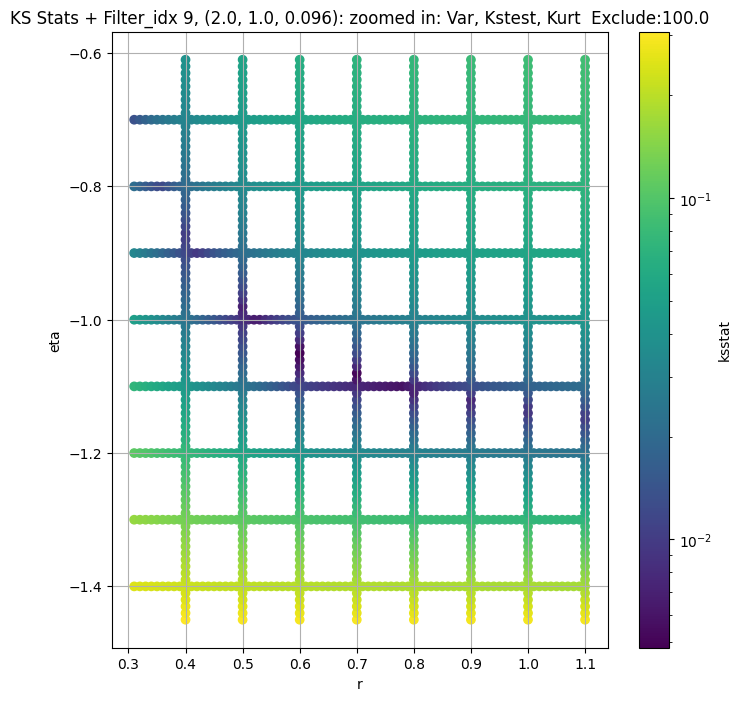

Filter_idx 10, (2.0, 1.0, 0.141):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 100 = 100, ksstat: 0.006053512783778747, var: 3136.80224609375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 75 = 75, ksstat: 0.005719368704428074, var: 3207.29541015625


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 50 = 50, ksstat: 0.005806593601731469, var: 3288.096435546875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 25 = 25, ksstat: 0.005393634165371086, var: 3384.01416015625


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 10, 0.0 + 0 = 0, ksstat: 0.0044400043418066915, var: 3532.969482421875
Number of samples: 100000, Without approximation : 65536000.0


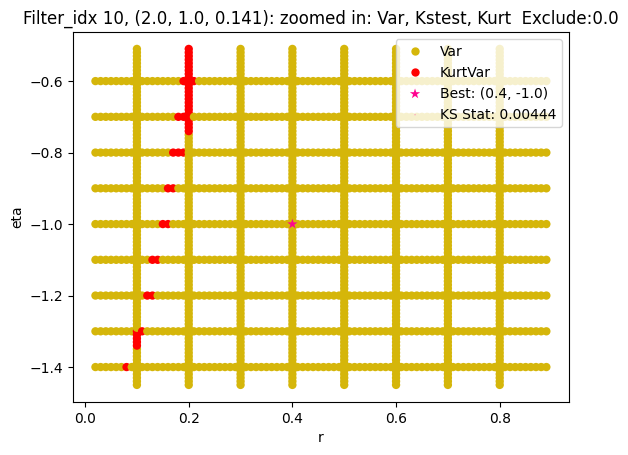

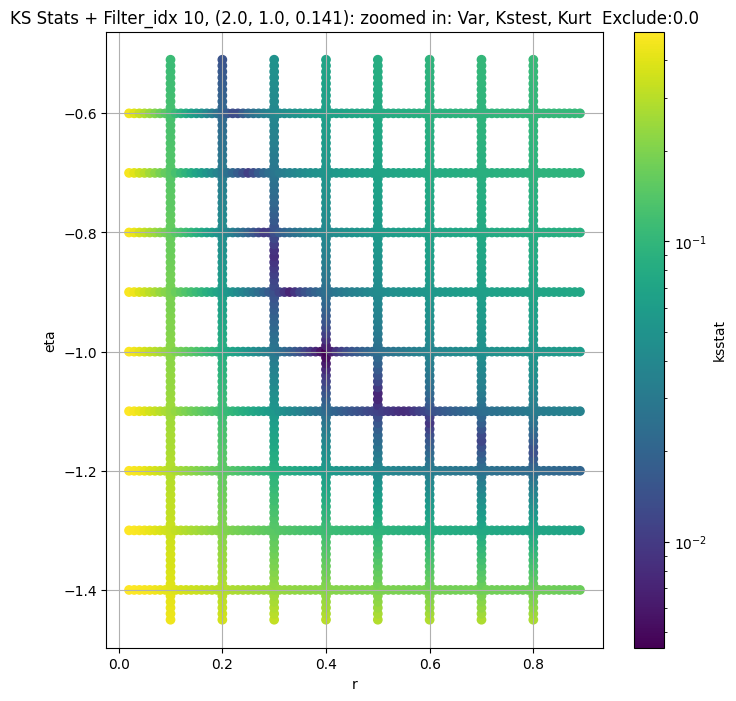

Filter_idx 11, (2.0, 1.0, 0.208):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 11, 0.0 + 100 = 100, ksstat: 0.005481701944424211, var: 1166.0758056640625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 11, 0.0 + 75 = 75, ksstat: 0.004730069365162758, var: 1194.4383544921875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 11, 0.0 + 50 = 50, ksstat: 0.004804831788488929, var: 1226.7791748046875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 11, 0.0 + 25 = 25, ksstat: 0.004485544329616786, var: 1266.17333984375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 11, 0.0 + 0 = 0, ksstat: 0.0043268466936743355, var: 1327.3878173828125
Number of samples: 100000, Without approximation : 65536000.0


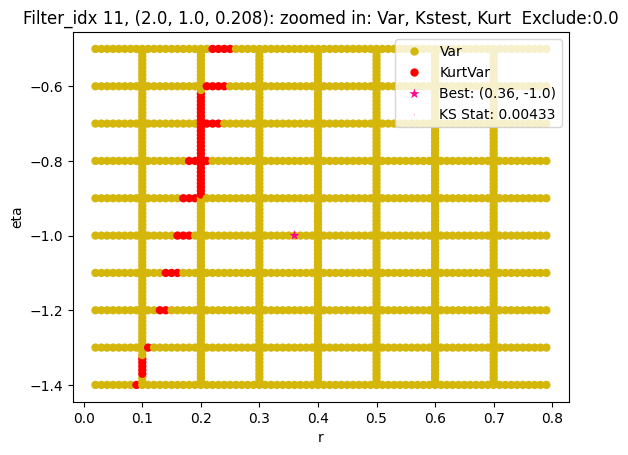

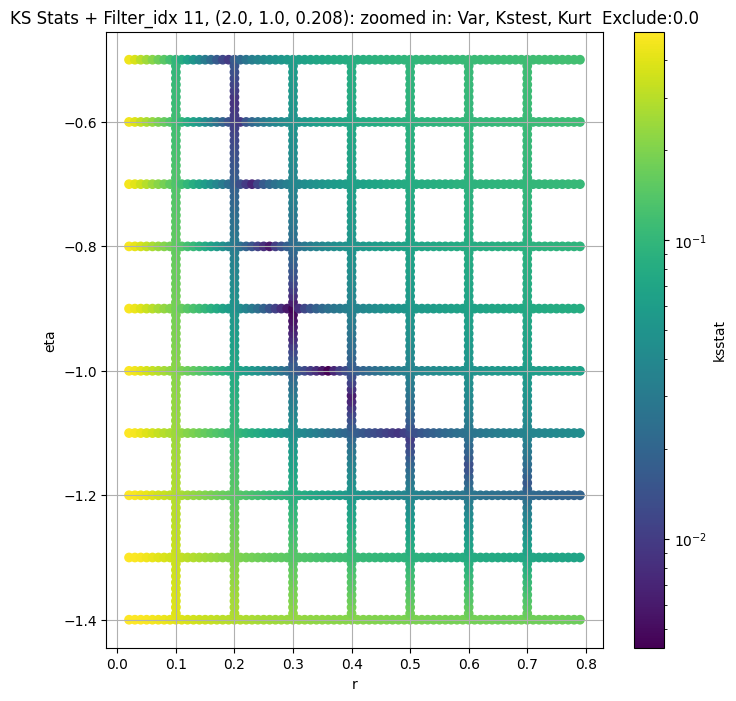

Filter_idx 12, (2.0, 1.0, 0.306):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 12, 0.0 + 100 = 100, ksstat: 0.005498245492736198, var: 415.4661865234375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 12, 0.0 + 75 = 75, ksstat: 0.005498552553315661, var: 427.4479064941406


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 12, 0.0 + 50 = 50, ksstat: 0.00549889506667306, var: 441.43487548828125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 12, 0.0 + 25 = 25, ksstat: 0.005498089622390068, var: 458.6914978027344


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 12, 0.0 + 0 = 0, ksstat: 0.005498724380682274, var: 486.47039794921875
Number of samples: 100000, Without approximation : 65536000.0


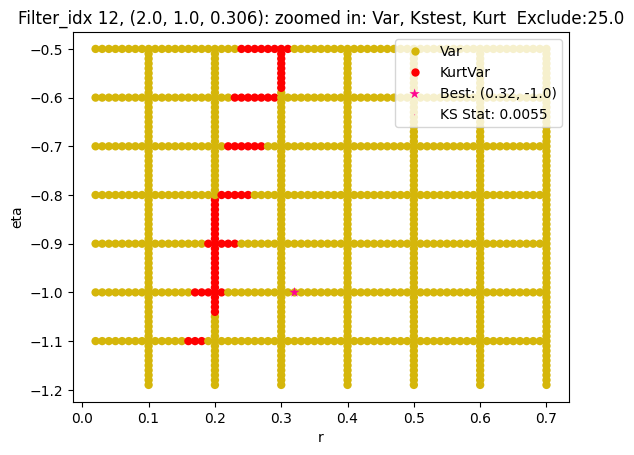

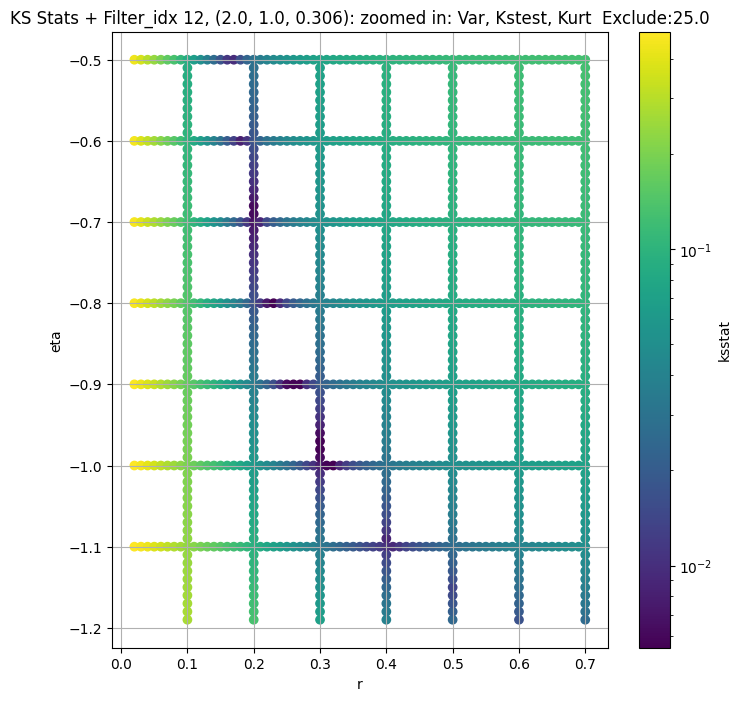

Filter_idx 13, (2.0, 1.0, 0.45):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + 100 = 300, ksstat: 0.00949302485290604, var: 162.6150665283203


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + 75 = 275, ksstat: 0.00949129806206872, var: 166.2704620361328


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + 50 = 250, ksstat: 0.009492085457470045, var: 170.14849853515625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + 25 = 225, ksstat: 0.009492894319609313, var: 174.27525329589844


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + 0 = 200, ksstat: 0.009493726982005124, var: 178.6822509765625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + -25 = 175, ksstat: 0.009494586914271075, var: 183.411376953125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + -50 = 150, ksstat: 0.009490143185900801, var: 188.51602172851562


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + -75 = 125, ksstat: 0.009491150921434599, var: 194.07533264160156


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 13, 200.0 + -100 = 100, ksstat: 0.009489214176217398, var: 200.18023681640625
Number of samples: 100000, Without approximation : 65536000.0


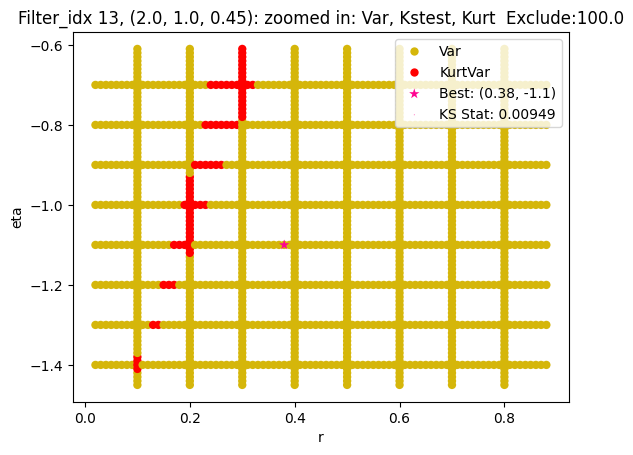

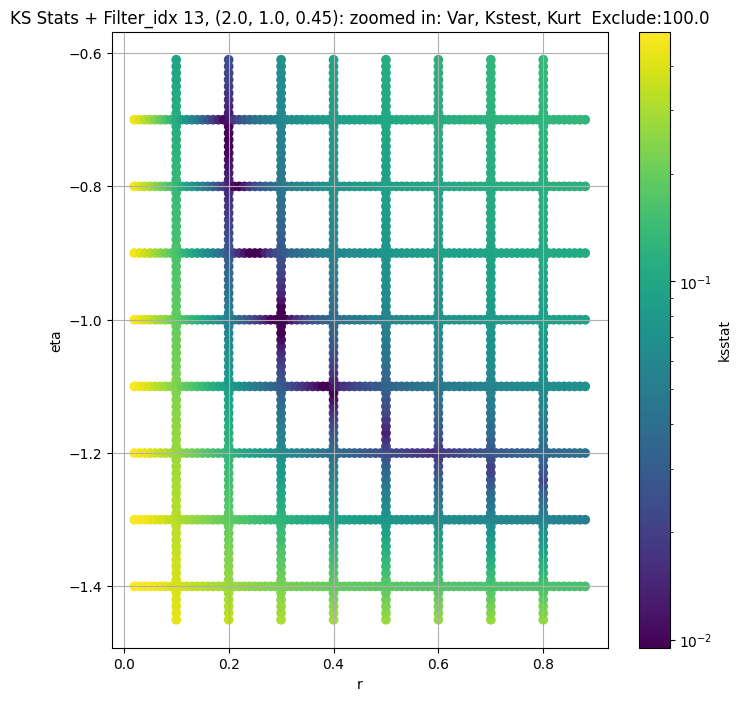

Filter_idx 14, (3.0, 0.5, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 14, 0.0 + 100 = 100, ksstat: 0.0060287633756164125, var: 46086.9765625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 14, 0.0 + 75 = 75, ksstat: 0.005471701378508109, var: 46684.90234375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 14, 0.0 + 50 = 50, ksstat: 0.0053524708419025735, var: 47342.234375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 14, 0.0 + 25 = 25, ksstat: 0.0051699343919005755, var: 48094.69140625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 14, 0.0 + 0 = 0, ksstat: 0.00466895176162585, var: 49222.93359375
Number of samples: 100000, Without approximation : 65536000.0


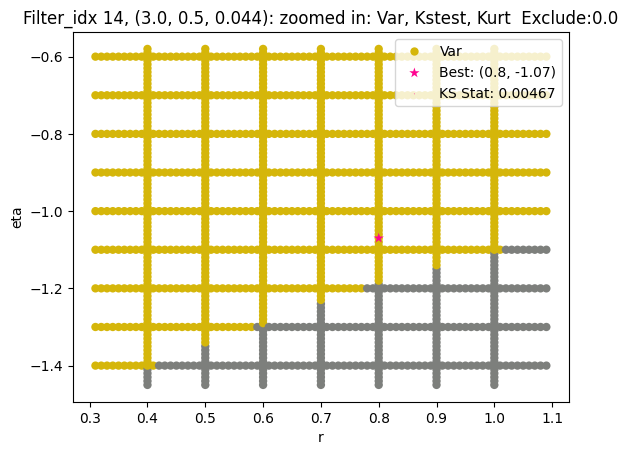

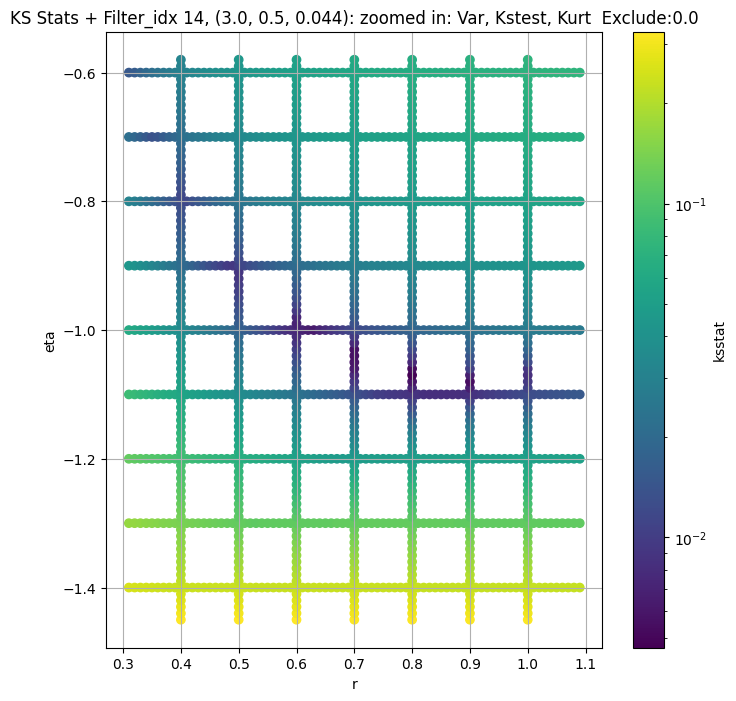

Filter_idx 15, (3.0, 0.5, 0.065):


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 100.0 + 100 = 200, ksstat: 0.0076924749465976106, var: 15676.6025390625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 100.0 + 75 = 175, ksstat: 0.007366174488321331, var: 15876.2275390625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 100.0 + 50 = 150, ksstat: 0.0071348169201851525, var: 16087.076171875


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 100.0 + 25 = 125, ksstat: 0.006829035096204139, var: 16311.1845703125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 100.0 + 0 = 100, ksstat: 0.006912196060565146, var: 16551.12109375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 100.0 + -25 = 75, ksstat: 0.006927798432515564, var: 16811.92578125


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 100.0 + -50 = 50, ksstat: 0.006310951706888113, var: 17102.6015625


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 100.0 + -75 = 25, ksstat: 0.006287760182597246, var: 17440.55859375


  0%|          | 0/1570 [00:00<?, ?it/s]

Finding Minimum after computing 1570 CDFs
filter_idx 15, 100.0 + -100 = 0, ksstat: 0.006539848196450149, var: 17971.001953125
Number of samples: 100000, Without approximation : 65536000.0


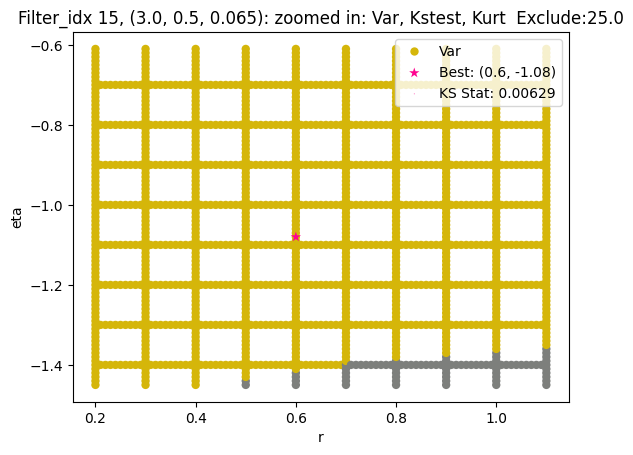

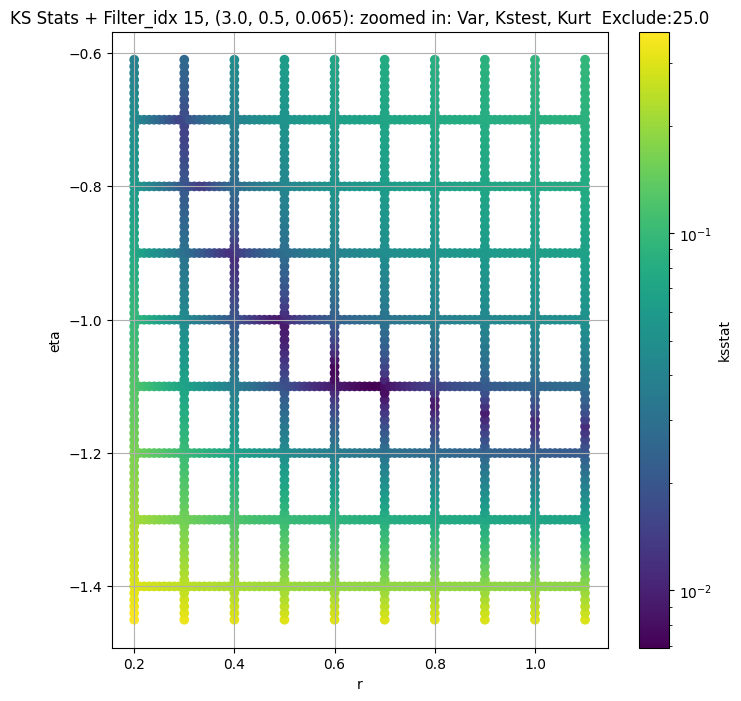

Filter_idx 16, (3.0, 0.5, 0.096):


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 16, 50.0 + 100 = 150, ksstat: 0.009051567427349694, var: 5562.97509765625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 16, 50.0 + 75 = 125, ksstat: 0.008797353382836492, var: 5655.17333984375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 16, 50.0 + 50 = 100, ksstat: 0.008955375953783595, var: 5754.50048828125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 16, 50.0 + 25 = 75, ksstat: 0.008785624382297574, var: 5862.80517578125


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 16, 50.0 + 0 = 50, ksstat: 0.008427932343190392, var: 5984.0322265625


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 16, 50.0 + -25 = 25, ksstat: 0.00786157793482356, var: 6126.396484375


  0%|          | 0/1477 [00:00<?, ?it/s]

Finding Minimum after computing 1477 CDFs
filter_idx 16, 50.0 + -50 = 0, ksstat: 0.007110644905917618, var: 6345.552734375
Number of samples: 100000, Without approximation : 65536000.0


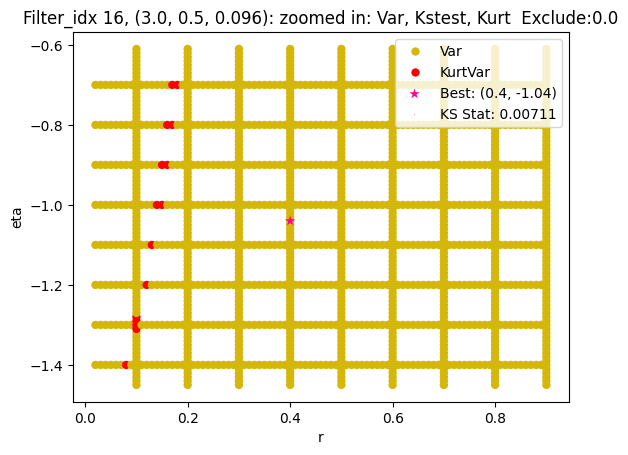

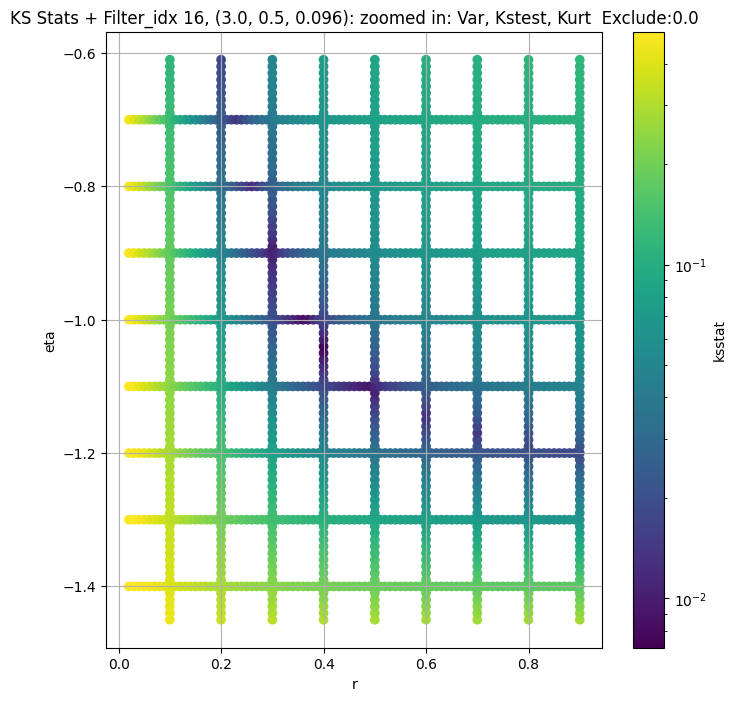

Filter_idx 17, (3.0, 0.5, 0.141):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + 100 = 200, ksstat: 0.008422432678325313, var: 1902.5211181640625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + 75 = 175, ksstat: 0.008475880451392026, var: 1937.939697265625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + 50 = 150, ksstat: 0.008229533874151006, var: 1975.5885009765625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + 25 = 125, ksstat: 0.008225253004584876, var: 2015.7236328125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + 0 = 100, ksstat: 0.007471160214567743, var: 2059.107666015625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + -25 = 75, ksstat: 0.007709340012117205, var: 2107.06591796875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + -50 = 50, ksstat: 0.007189051158432047, var: 2161.05615234375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + -75 = 25, ksstat: 0.007002313443353891, var: 2225.5400390625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 17, 100.0 + -100 = 0, ksstat: 0.006857968815782323, var: 2323.73828125
Number of samples: 100000, Without approximation : 65536000.0


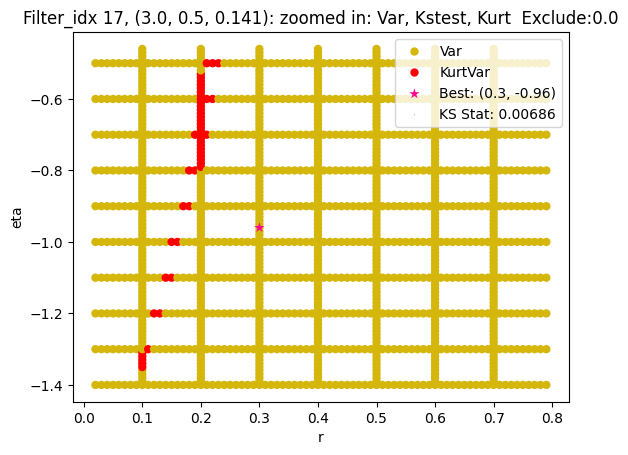

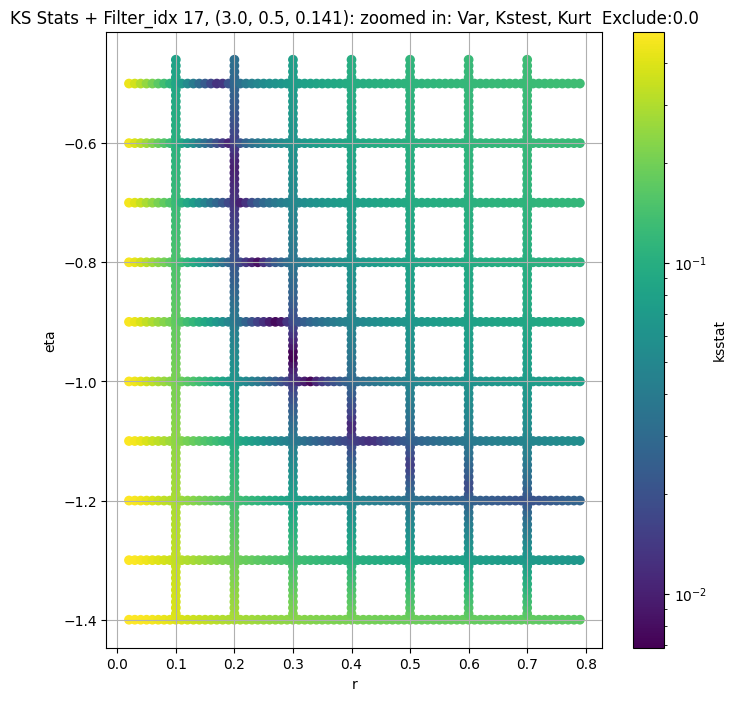

Filter_idx 18, (3.0, 0.5, 0.208):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 18, 50.0 + 100 = 150, ksstat: 0.007450387712942111, var: 743.3327026367188


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 18, 50.0 + 75 = 125, ksstat: 0.007028628351878112, var: 760.25390625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 18, 50.0 + 50 = 100, ksstat: 0.006583300330169406, var: 778.8206787109375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 18, 50.0 + 25 = 75, ksstat: 0.006948014461975793, var: 799.5992431640625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 18, 50.0 + 0 = 50, ksstat: 0.00639716060403786, var: 823.5572509765625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 18, 50.0 + -25 = 25, ksstat: 0.006338425836750788, var: 852.574462890625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 18, 50.0 + -50 = 0, ksstat: 0.005967214579421731, var: 900.4674682617188
Number of samples: 100000, Without approximation : 65536000.0


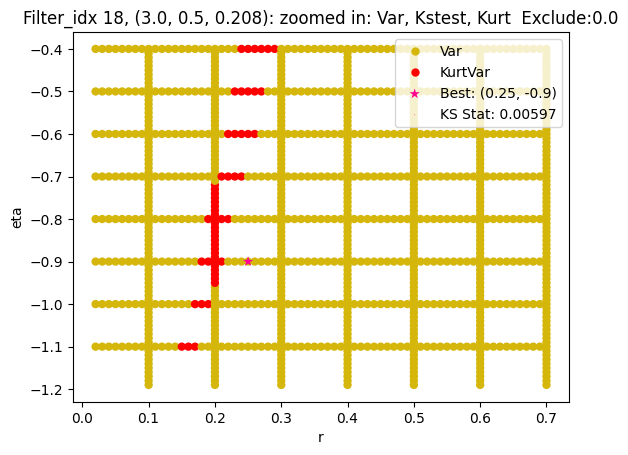

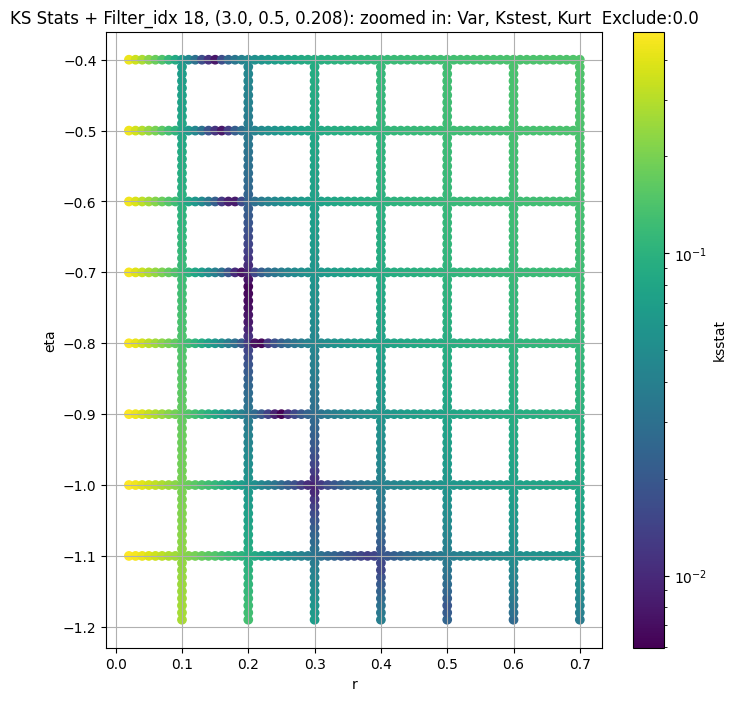

Filter_idx 19, (3.0, 0.5, 0.306):


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 19, 0.0 + 100 = 100, ksstat: 0.005339295920399834, var: 291.2367858886719


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 19, 0.0 + 75 = 75, ksstat: 0.0053214297681527314, var: 300.2413024902344


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 19, 0.0 + 50 = 50, ksstat: 0.004372358383305075, var: 310.5386962890625


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 19, 0.0 + 25 = 25, ksstat: 0.004284092507669812, var: 323.00079345703125


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 19, 0.0 + 0 = 0, ksstat: 0.004948784100231696, var: 343.2646484375
Number of samples: 100000, Without approximation : 65536000.0


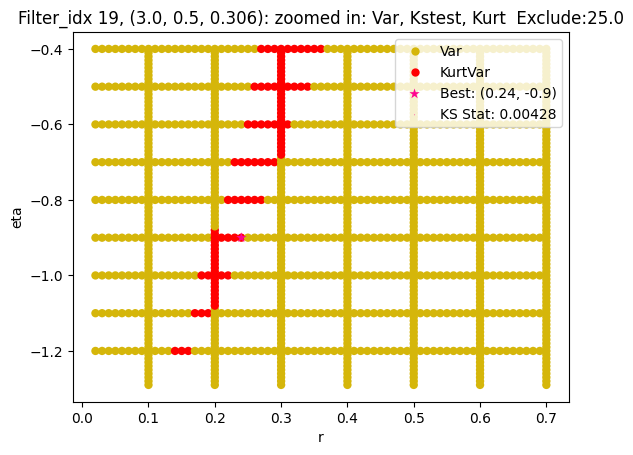

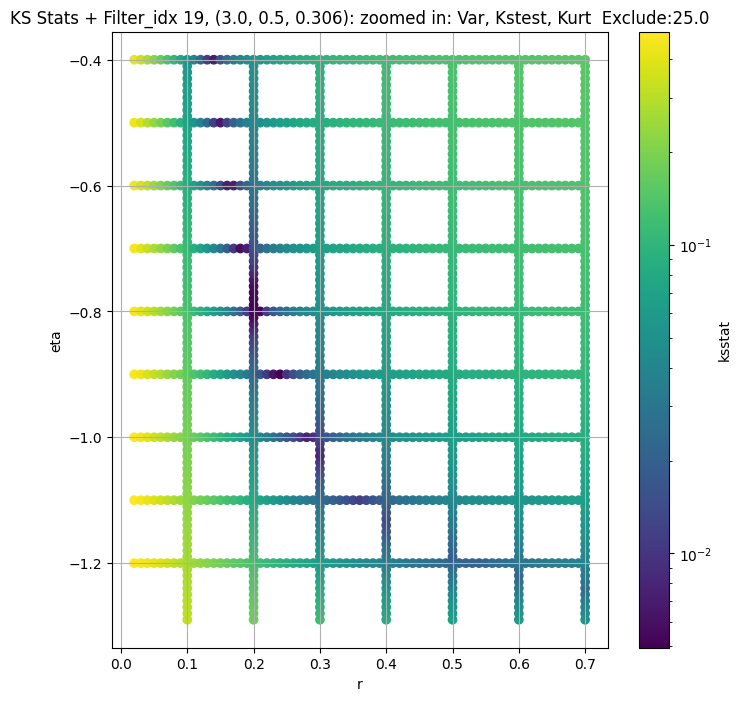

Filter_idx 20, (3.0, 0.5, 0.45):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 0.0 + 100 = 100, ksstat: 0.00934192389018218, var: 142.05897521972656


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 0.0 + 75 = 75, ksstat: 0.008614224188912445, var: 147.13162231445312


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 0.0 + 50 = 50, ksstat: 0.007537441402714173, var: 152.8542022705078


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 0.0 + 25 = 25, ksstat: 0.007601798316194341, var: 159.49066162109375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 20, 0.0 + 0 = 0, ksstat: 0.007509603448172697, var: 171.333740234375
Number of samples: 100000, Without approximation : 65536000.0


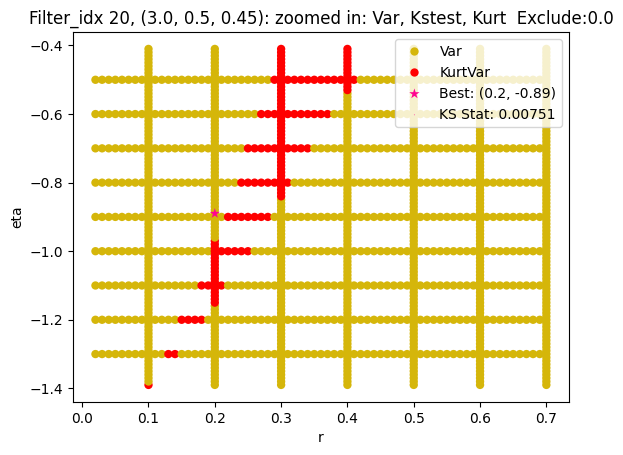

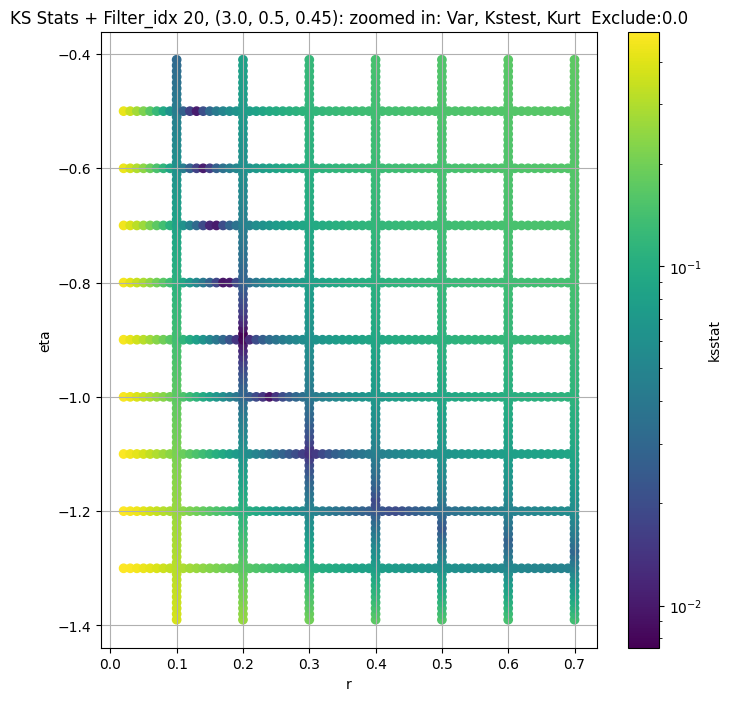

Filter_idx 21, (3.0, 1.0, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 100 = 150, ksstat: 0.005875328790438117, var: 52760.72265625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 75 = 125, ksstat: 0.00570290508226301, var: 53619.83203125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 50 = 100, ksstat: 0.0058218170705194305, var: 54546.796875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 25 = 75, ksstat: 0.005360588734113866, var: 55560.81640625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + 0 = 50, ksstat: 0.004726696931148688, var: 56689.1796875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + -25 = 25, ksstat: 0.004493658776137943, var: 57989.40234375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 21, 50.0 + -50 = 0, ksstat: 0.004634639136217478, var: 59909.38671875
Number of samples: 100000, Without approximation : 65536000.0


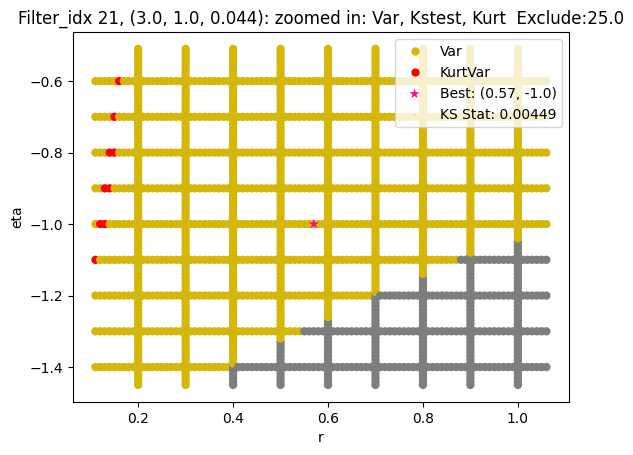

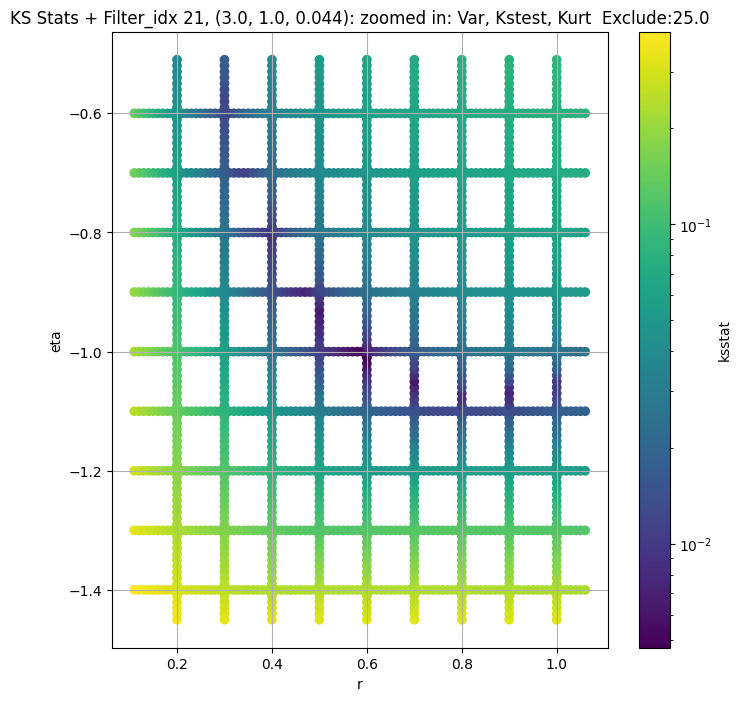

Filter_idx 22, (3.0, 1.0, 0.065):


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 22, 0.0 + 100 = 100, ksstat: 0.006728537252117195, var: 19046.166015625


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 22, 0.0 + 75 = 75, ksstat: 0.006329216928162351, var: 19483.44921875


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 22, 0.0 + 50 = 50, ksstat: 0.006247686399602603, var: 19970.900390625


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 22, 0.0 + 25 = 25, ksstat: 0.00590850252215025, var: 20534.80078125


  0%|          | 0/1332 [00:00<?, ?it/s]

Finding Minimum after computing 1332 CDFs
filter_idx 22, 0.0 + 0 = 0, ksstat: 0.005494771103355112, var: 21362.357421875
Number of samples: 100000, Without approximation : 65536000.0


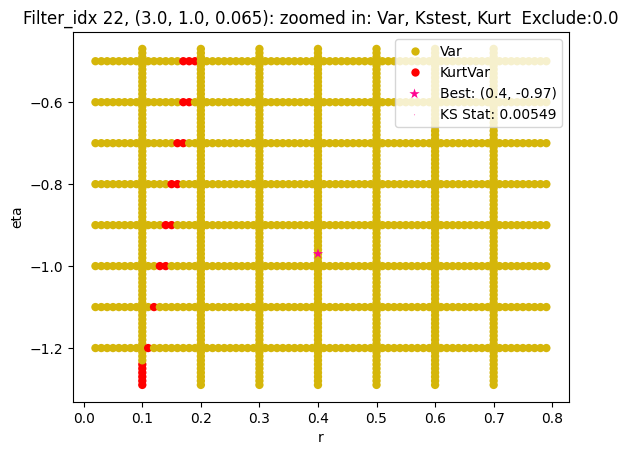

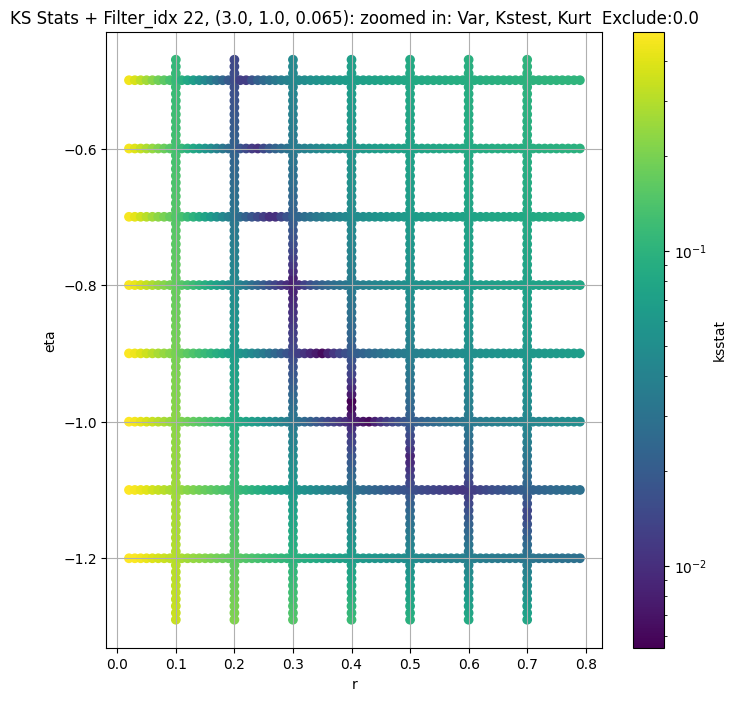

Filter_idx 23, (3.0, 1.0, 0.096):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 100 = 100, ksstat: 0.007033699546236449, var: 6645.66259765625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 75 = 75, ksstat: 0.007257714830153361, var: 6821.7783203125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 50 = 50, ksstat: 0.007537556169797732, var: 7021.806640625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 25 = 25, ksstat: 0.007379484500912581, var: 7256.3525390625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 23, 0.0 + 0 = 0, ksstat: 0.006418373901618743, var: 7615.37109375
Number of samples: 100000, Without approximation : 65536000.0


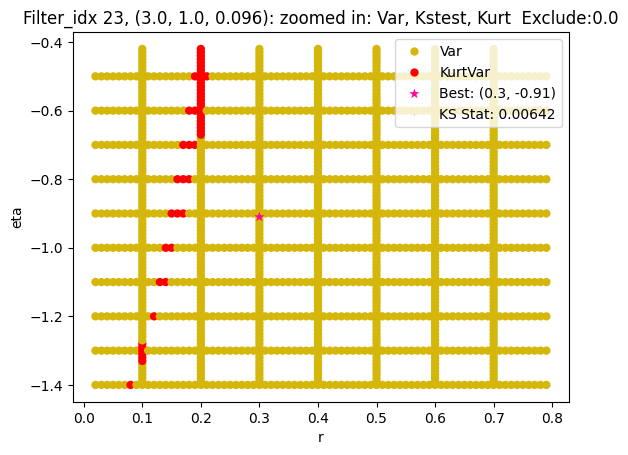

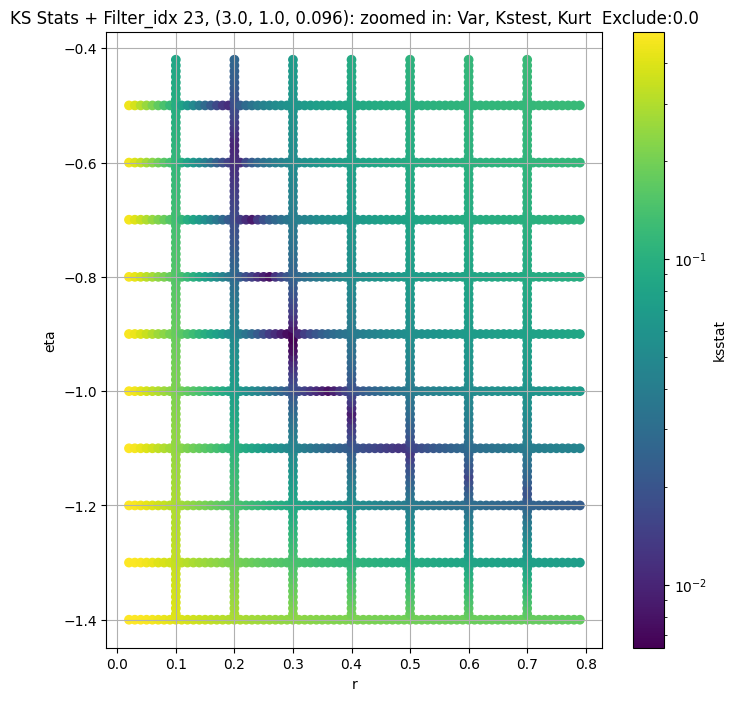

Filter_idx 24, (3.0, 1.0, 0.141):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 100 = 100, ksstat: 0.0074860480595130285, var: 2263.510986328125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 75 = 75, ksstat: 0.007284963472716566, var: 2336.435546875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 50 = 50, ksstat: 0.007296345327477027, var: 2421.333740234375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 25 = 25, ksstat: 0.006861102396353513, var: 2524.394287109375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 24, 0.0 + 0 = 0, ksstat: 0.007021044918607, var: 2686.879638671875
Number of samples: 100000, Without approximation : 65536000.0


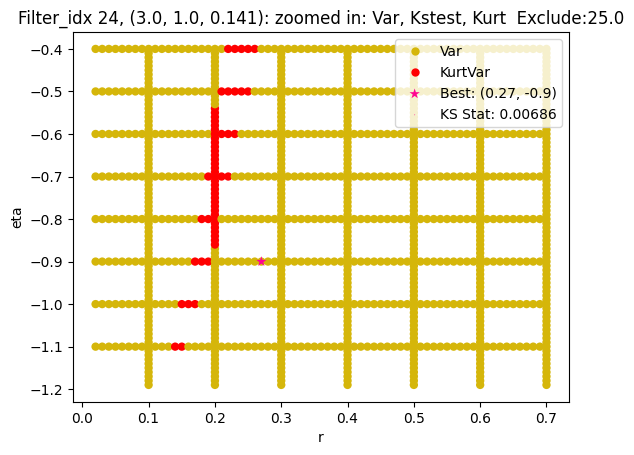

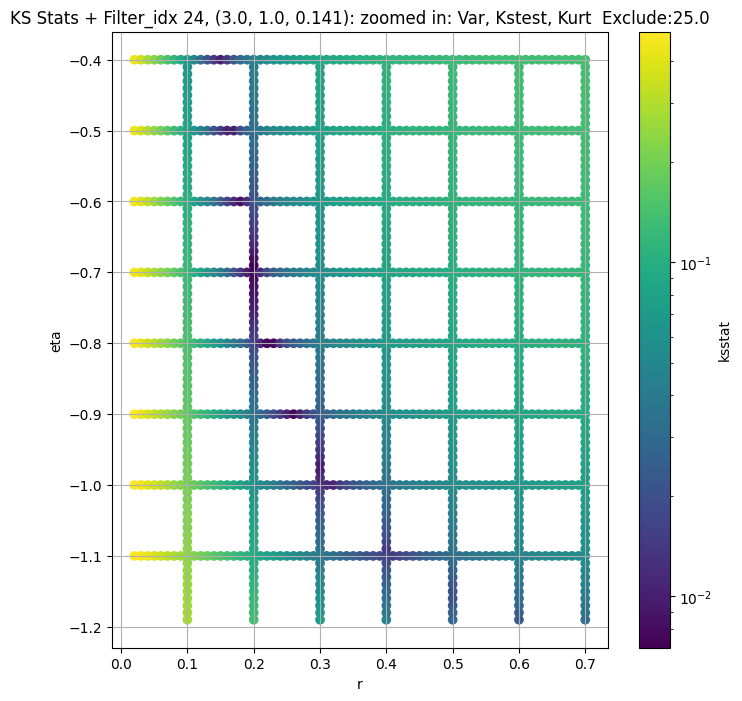

Filter_idx 25, (3.0, 1.0, 0.208):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 50.0 + 100 = 150, ksstat: 0.007167133485920685, var: 770.751953125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 50.0 + 75 = 125, ksstat: 0.0072440313860402394, var: 794.6478271484375


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 50.0 + 50 = 100, ksstat: 0.006314614858089818, var: 821.3351440429688


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 50.0 + 25 = 75, ksstat: 0.006372965046601564, var: 851.5994873046875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 50.0 + 0 = 50, ksstat: 0.005690639622438459, var: 886.7020874023438


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 50.0 + -25 = 25, ksstat: 0.005981748607885251, var: 930.8515625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 25, 50.0 + -50 = 0, ksstat: 0.00592980542203847, var: 1004.3929443359375
Number of samples: 100000, Without approximation : 65536000.0


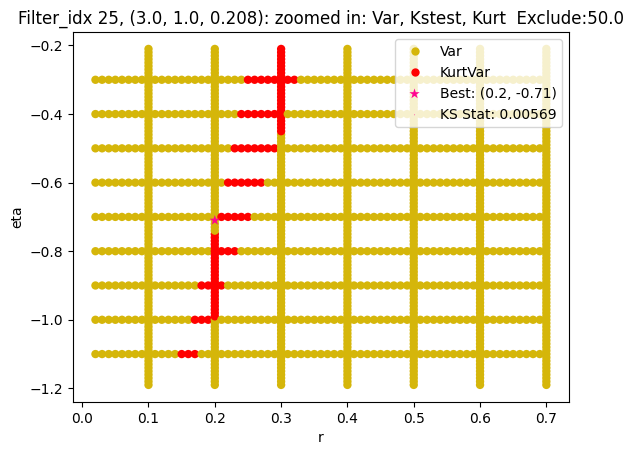

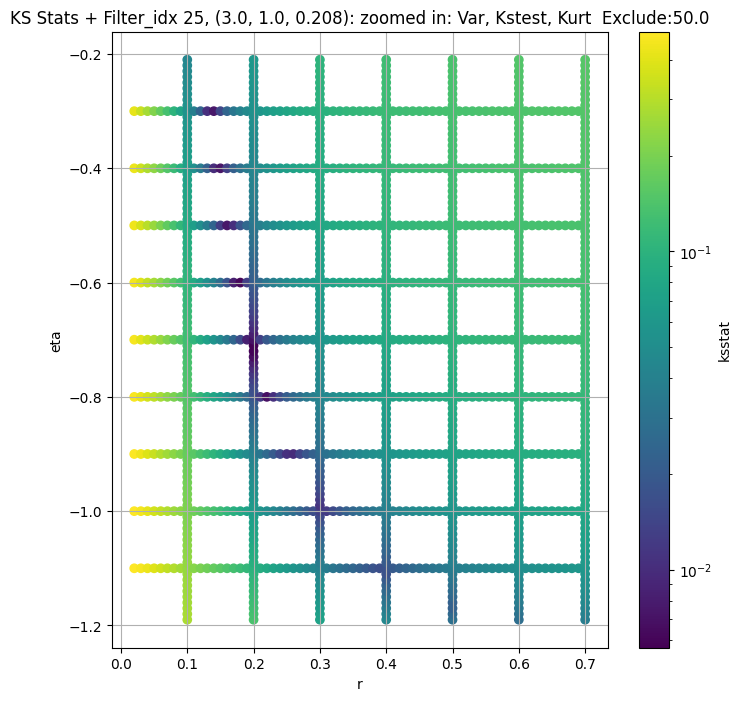

Filter_idx 26, (3.0, 1.0, 0.306):


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 0.0 + 100 = 100, ksstat: 0.0055743766467348035, var: 326.2119140625


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 0.0 + 75 = 75, ksstat: 0.0053097409775661394, var: 339.58636474609375


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 0.0 + 50 = 50, ksstat: 0.004318606867397028, var: 355.63372802734375


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 0.0 + 25 = 25, ksstat: 0.004799082091842322, var: 376.14306640625


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 26, 0.0 + 0 = 0, ksstat: 0.00400130162406831, var: 411.3970947265625
Number of samples: 100000, Without approximation : 65536000.0


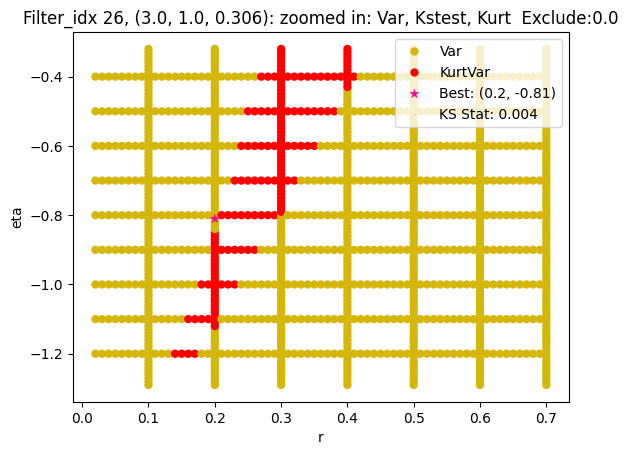

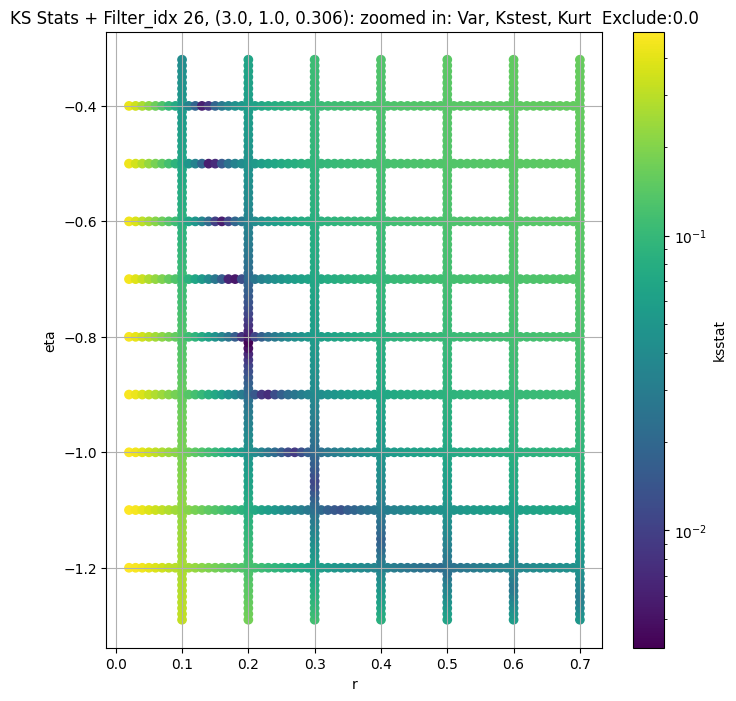

Filter_idx 27, (3.0, 1.0, 0.45):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 50.0 + 100 = 150, ksstat: 0.007752022776093548, var: 112.9042739868164


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 50.0 + 75 = 125, ksstat: 0.007271562853970126, var: 117.35385131835938


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 50.0 + 50 = 100, ksstat: 0.007307171753711983, var: 122.55340576171875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 50.0 + 25 = 75, ksstat: 0.007429151720617977, var: 128.7885284423828


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 50.0 + 0 = 50, ksstat: 0.007306355734033598, var: 136.5015869140625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 50.0 + -25 = 25, ksstat: 0.007439329174647791, var: 146.59400939941406


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 27, 50.0 + -50 = 0, ksstat: 0.008289017366582385, var: 163.96482849121094
Number of samples: 100000, Without approximation : 65536000.0


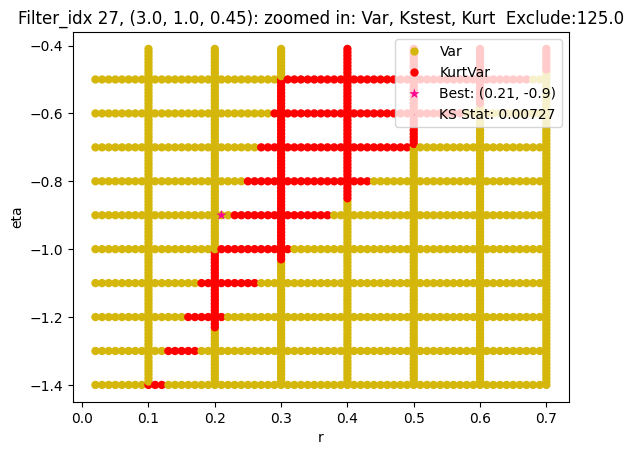

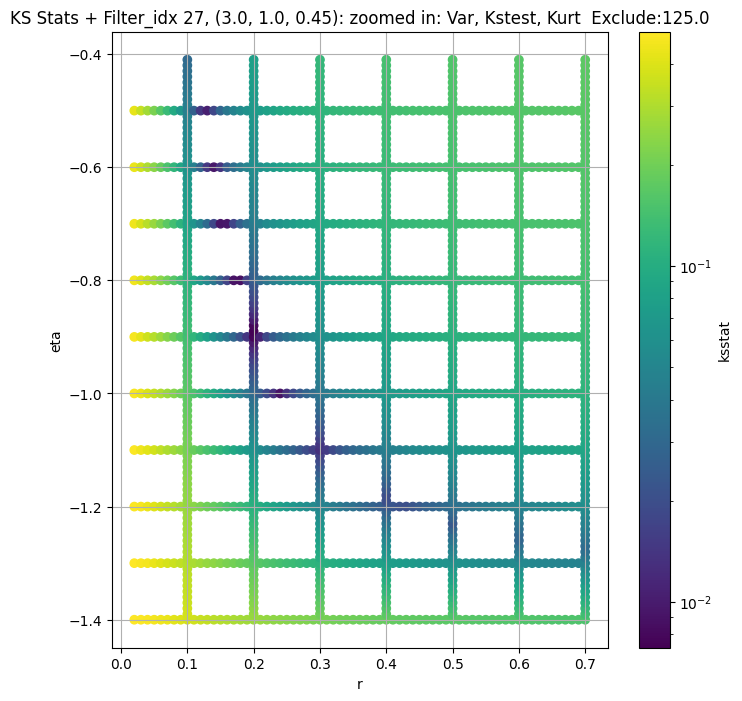

Filter_idx 28, (4.0, 0.5, 0.044):


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 28, 0.0 + 100 = 100, ksstat: 0.005712416720558111, var: 43034.66796875


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 28, 0.0 + 75 = 75, ksstat: 0.004907918394330801, var: 43646.40234375


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 28, 0.0 + 50 = 50, ksstat: 0.005172984447965101, var: 44326.16015625


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 28, 0.0 + 25 = 25, ksstat: 0.004627572227972665, var: 45106.4296875


  0%|          | 0/1760 [00:00<?, ?it/s]

Finding Minimum after computing 1760 CDFs
filter_idx 28, 0.0 + 0 = 0, ksstat: 0.004150140541065994, var: 46349.27734375
Number of samples: 100000, Without approximation : 65536000.0


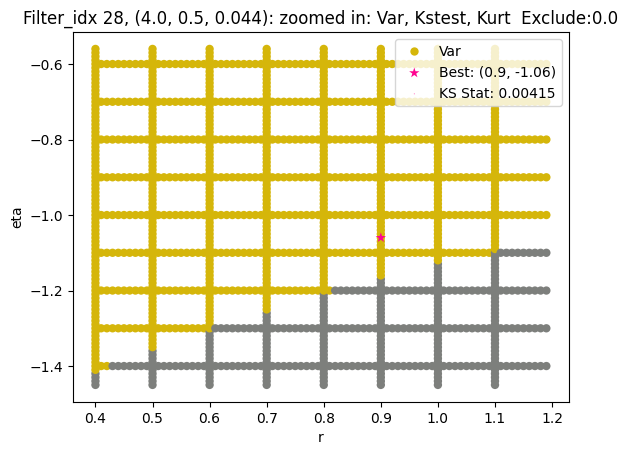

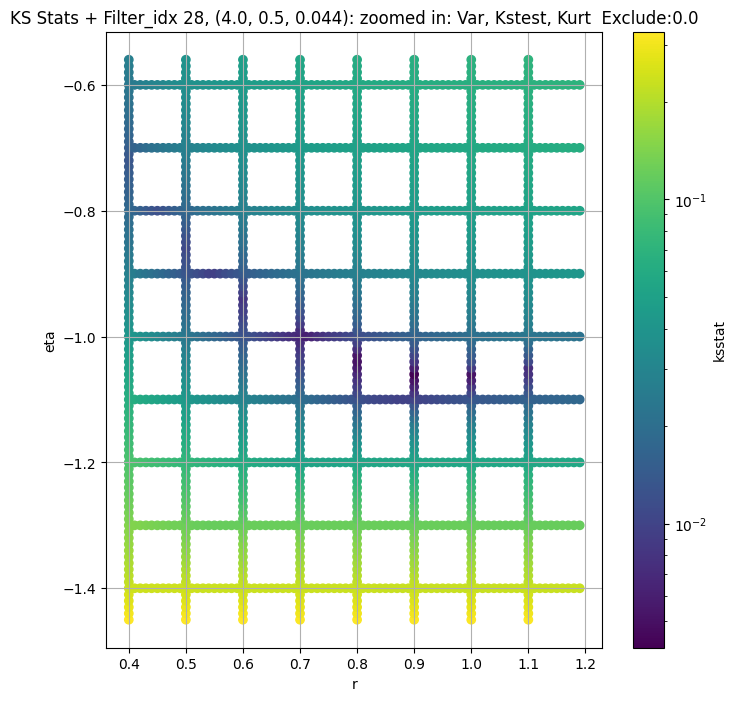

Filter_idx 29, (4.0, 0.5, 0.065):


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + 100 = 200, ksstat: 0.007322550385397364, var: 14796.0146484375


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + 75 = 175, ksstat: 0.007327934804044867, var: 14996.1533203125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + 50 = 150, ksstat: 0.007330507041755918, var: 15209.111328125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + 25 = 125, ksstat: 0.007456309382325665, var: 15437.2685546875


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + 0 = 100, ksstat: 0.007021303395778472, var: 15683.5703125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + -25 = 75, ksstat: 0.006580410258345326, var: 15953.3056640625


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + -50 = 50, ksstat: 0.007480714890797935, var: 16255.0830078125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + -75 = 25, ksstat: 0.006630550285748049, var: 16608.423828125


  0%|          | 0/1485 [00:00<?, ?it/s]

Finding Minimum after computing 1485 CDFs
filter_idx 29, 100.0 + -100 = 0, ksstat: 0.005791283509993916, var: 17164.060546875
Number of samples: 100000, Without approximation : 65536000.0


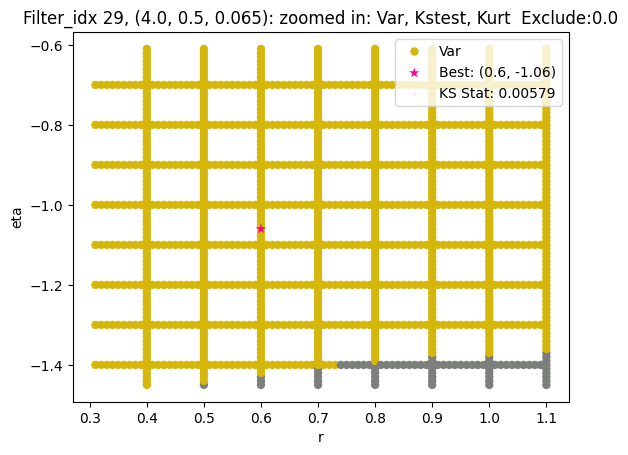

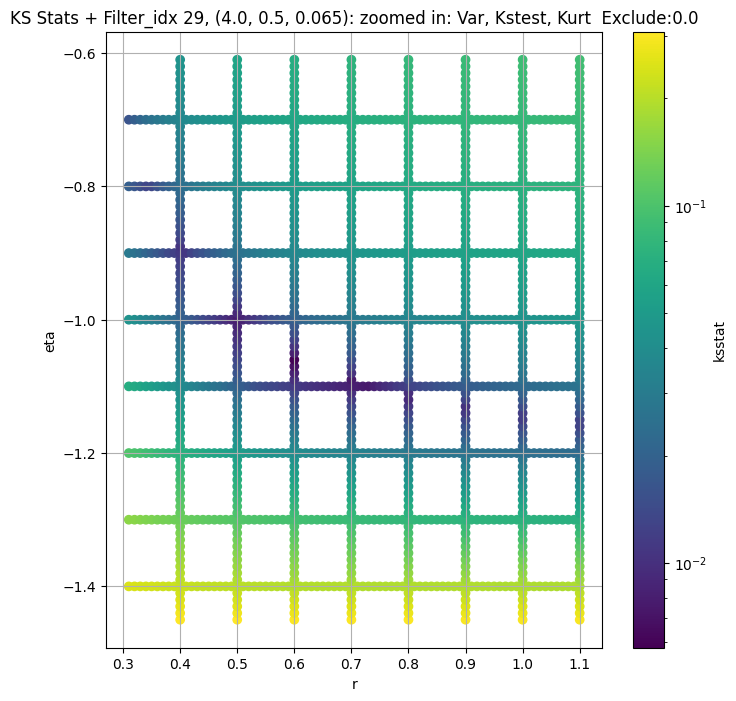

Filter_idx 30, (4.0, 0.5, 0.096):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 30, 0.0 + 100 = 100, ksstat: 0.00869194103992034, var: 5366.458984375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 30, 0.0 + 75 = 75, ksstat: 0.007920121695592308, var: 5473.1044921875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 30, 0.0 + 50 = 50, ksstat: 0.008737594351778122, var: 5592.9677734375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 30, 0.0 + 25 = 25, ksstat: 0.008366713512469759, var: 5733.91064453125


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 30, 0.0 + 0 = 0, ksstat: 0.008113547258176146, var: 5966.47216796875
Number of samples: 100000, Without approximation : 65536000.0


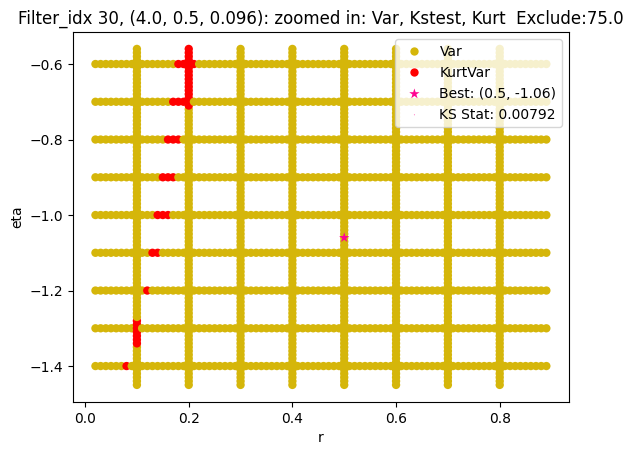

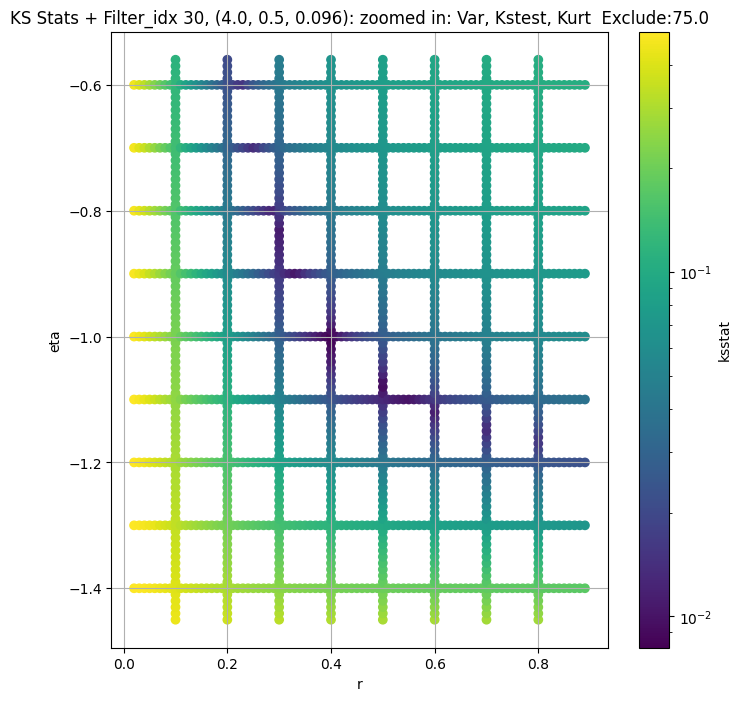

Filter_idx 31, (4.0, 0.5, 0.141):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 31, 100.0 + 100 = 200, ksstat: 0.010617210033585844, var: 1660.439697265625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 31, 100.0 + 75 = 175, ksstat: 0.01006827768894114, var: 1691.7706298828125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 31, 100.0 + 50 = 150, ksstat: 0.009742497320649968, var: 1725.5028076171875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 31, 100.0 + 25 = 125, ksstat: 0.009357538809852683, var: 1762.044189453125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 31, 100.0 + 0 = 100, ksstat: 0.00987093911687345, var: 1802.0267333984375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 31, 100.0 + -25 = 75, ksstat: 0.009524670878537811, var: 1846.4676513671875


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 31, 100.0 + -50 = 50, ksstat: 0.008817648908665654, var: 1896.91455078125


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 31, 100.0 + -75 = 25, ksstat: 0.008863644769786183, var: 1956.7777099609375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 31, 100.0 + -100 = 0, ksstat: 0.008308710297625699, var: 2055.49951171875
Number of samples: 100000, Without approximation : 65536000.0


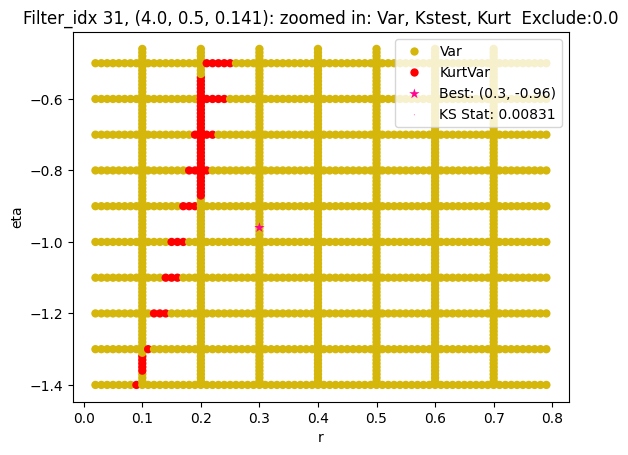

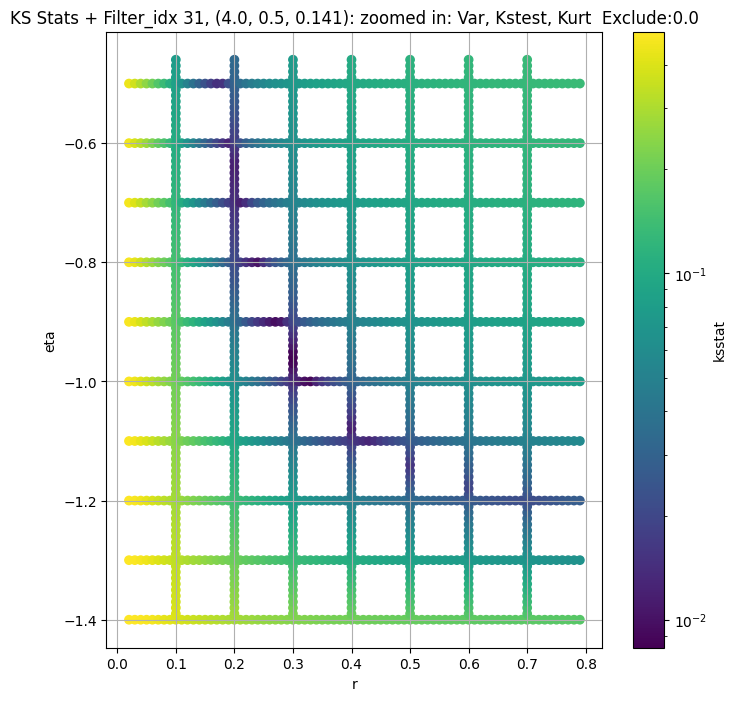

Filter_idx 32, (4.0, 0.5, 0.208):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 32, 0.0 + 100 = 100, ksstat: 0.007514575208312779, var: 713.0311889648438


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 32, 0.0 + 75 = 75, ksstat: 0.006934861473590043, var: 733.325439453125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 32, 0.0 + 50 = 50, ksstat: 0.006659025374738947, var: 757.103515625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 32, 0.0 + 25 = 25, ksstat: 0.00659963690521078, var: 786.50341796875


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 32, 0.0 + 0 = 0, ksstat: 0.0063481571358432465, var: 839.6153564453125
Number of samples: 100000, Without approximation : 65536000.0


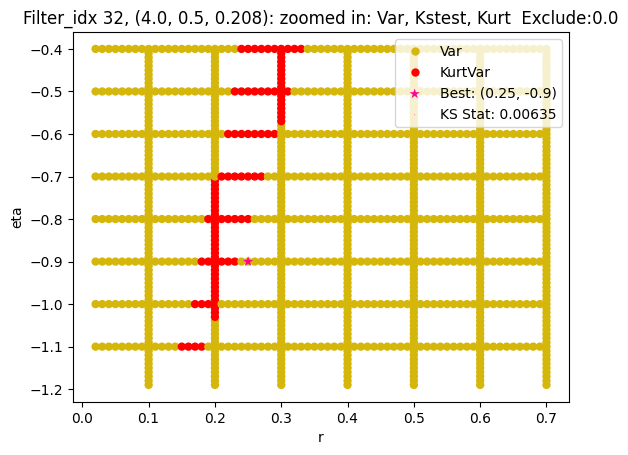

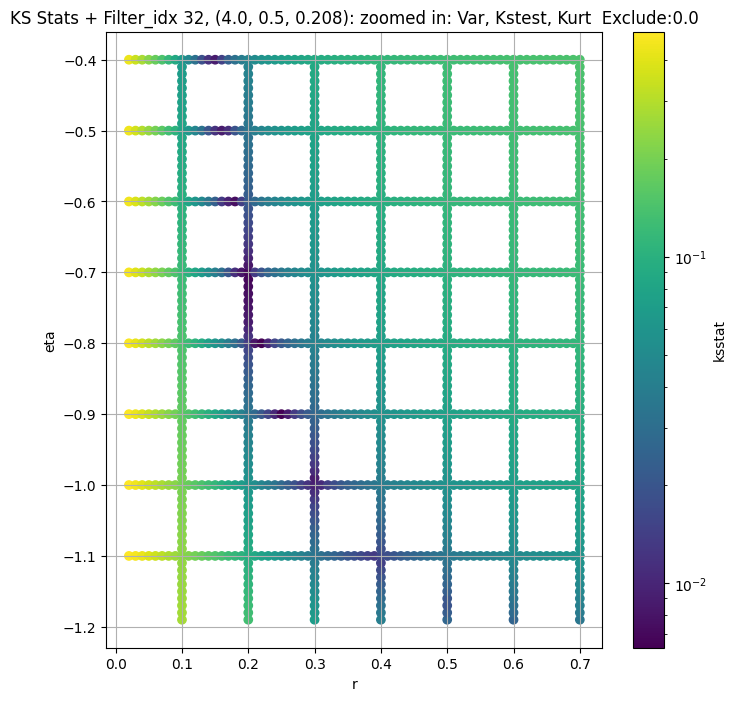

Filter_idx 33, (4.0, 0.5, 0.306):


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 33, 0.0 + 100 = 100, ksstat: 0.006075715739328302, var: 286.8357238769531


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 33, 0.0 + 75 = 75, ksstat: 0.005529883891515541, var: 295.9176025390625


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 33, 0.0 + 50 = 50, ksstat: 0.00542176735067712, var: 306.50982666015625


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 33, 0.0 + 25 = 25, ksstat: 0.004902569326590944, var: 319.48577880859375


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 33, 0.0 + 0 = 0, ksstat: 0.00438116351577416, var: 343.6123352050781
Number of samples: 100000, Without approximation : 65536000.0


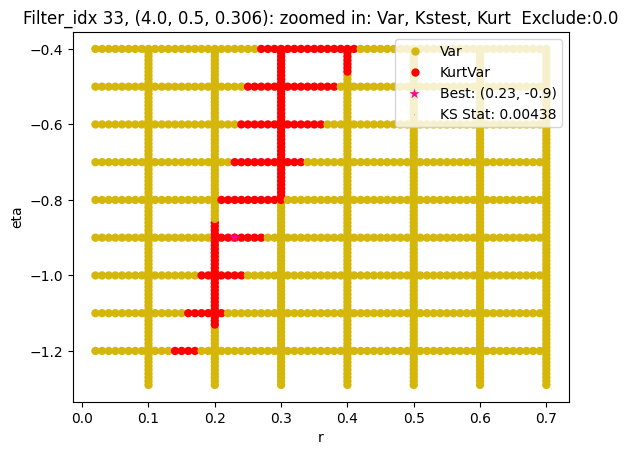

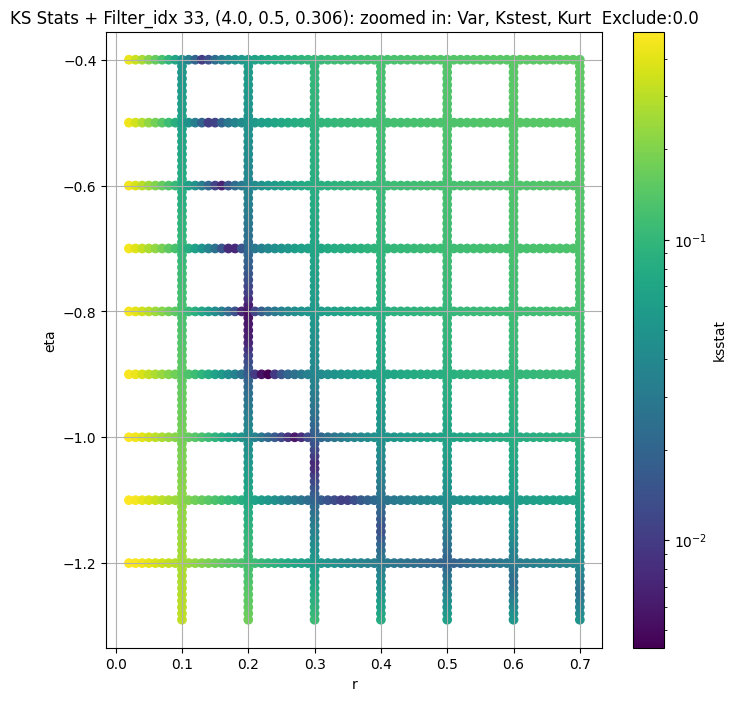

Filter_idx 34, (4.0, 0.5, 0.45):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + 100 = 300, ksstat: 0.012992883766945407, var: 103.09070587158203


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + 75 = 275, ksstat: 0.012257409154743049, var: 105.56871032714844


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + 50 = 250, ksstat: 0.011783660619619662, var: 108.20246124267578


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + 25 = 225, ksstat: 0.01288313095709459, var: 111.01087188720703


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + 0 = 200, ksstat: 0.012518085001464674, var: 114.01703643798828


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + -25 = 175, ksstat: 0.012132473493267598, var: 117.24494934082031


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + -50 = 150, ksstat: 0.011723645844026263, var: 120.719970703125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + -75 = 125, ksstat: 0.011195867903456391, var: 124.47662353515625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 34, 200.0 + -100 = 100, ksstat: 0.010481612159558895, var: 128.55435180664062
Number of samples: 100000, Without approximation : 65536000.0


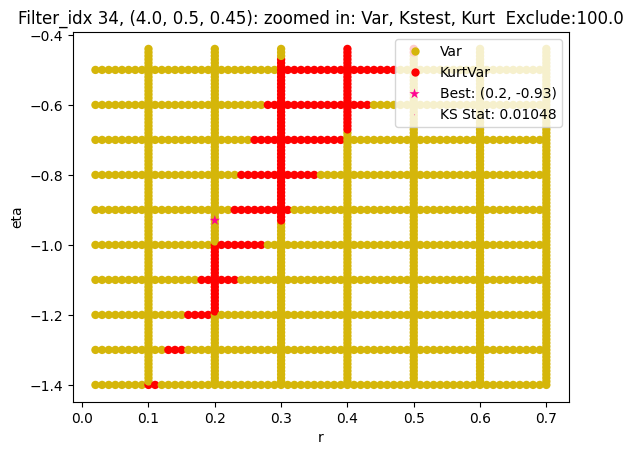

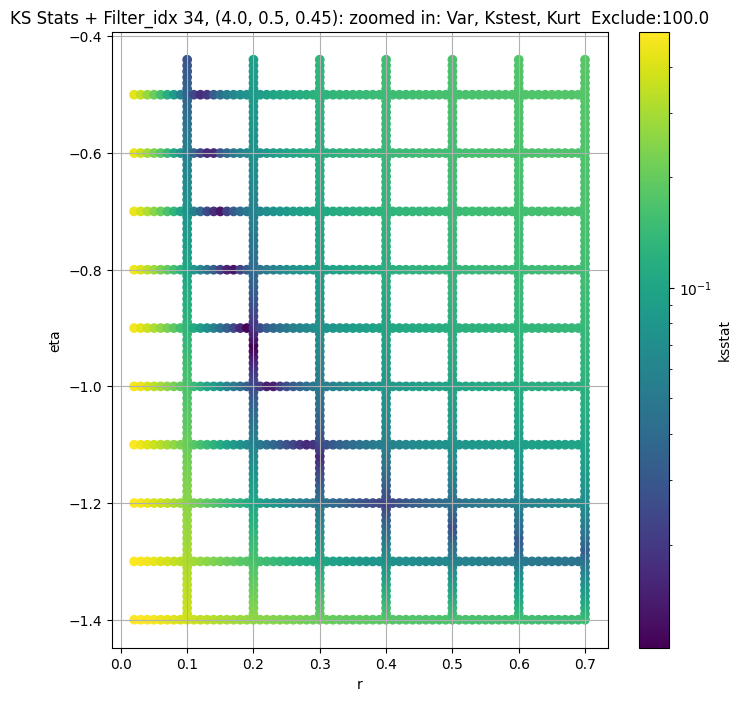

Filter_idx 35, (4.0, 1.0, 0.044):


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 50.0 + 100 = 150, ksstat: 0.003553322828037442, var: 47499.8515625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 50.0 + 75 = 125, ksstat: 0.003120953335040033, var: 48345.57421875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 50.0 + 50 = 100, ksstat: 0.0032298736511116033, var: 49263.5625


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 50.0 + 25 = 75, ksstat: 0.0026346694456426123, var: 50278.984375


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 50.0 + 0 = 50, ksstat: 0.0024868169477764157, var: 51426.98046875


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 50.0 + -25 = 25, ksstat: 0.002466137221253162, var: 52789.0703125


  0%|          | 0/1665 [00:00<?, ?it/s]

Finding Minimum after computing 1665 CDFs
filter_idx 35, 50.0 + -50 = 0, ksstat: 0.0023071303995761405, var: 54964.80859375
Number of samples: 100000, Without approximation : 65536000.0


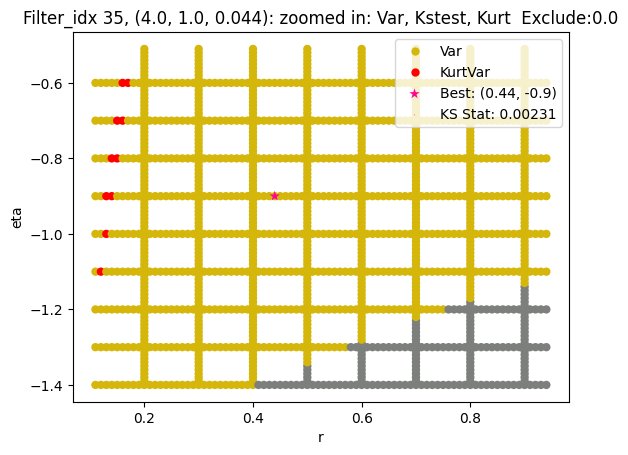

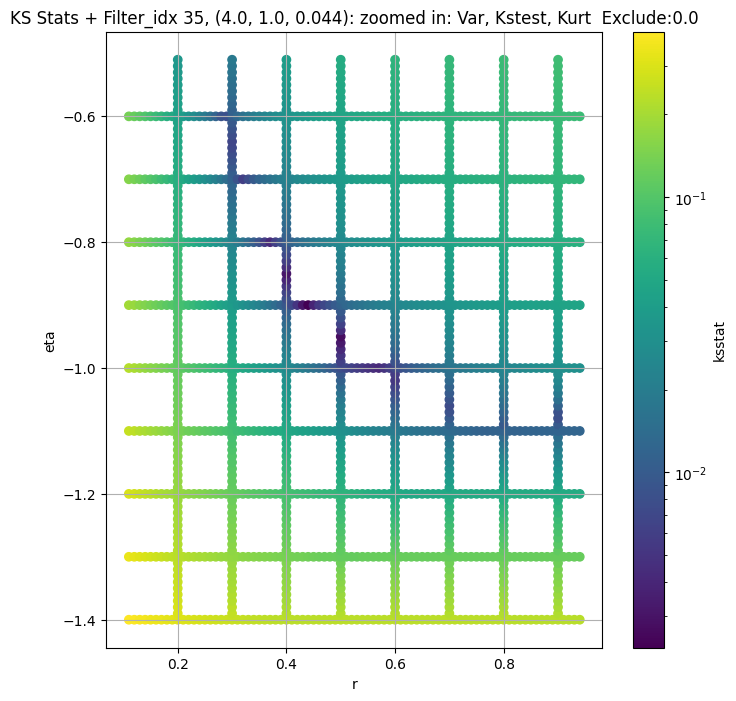

Filter_idx 36, (4.0, 1.0, 0.065):


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 36, 0.0 + 100 = 100, ksstat: 0.00494146028155934, var: 16440.568359375


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 36, 0.0 + 75 = 75, ksstat: 0.004474366661205431, var: 16852.23046875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 36, 0.0 + 50 = 50, ksstat: 0.004298093453535601, var: 17314.134765625


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 36, 0.0 + 25 = 25, ksstat: 0.004923005013277804, var: 17850.701171875


  0%|          | 0/1480 [00:00<?, ?it/s]

Finding Minimum after computing 1480 CDFs
filter_idx 36, 0.0 + 0 = 0, ksstat: 0.005111675085635814, var: 18656.62109375
Number of samples: 100000, Without approximation : 65536000.0


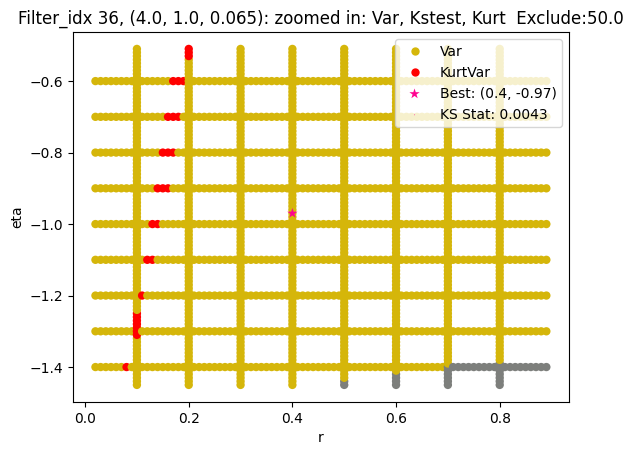

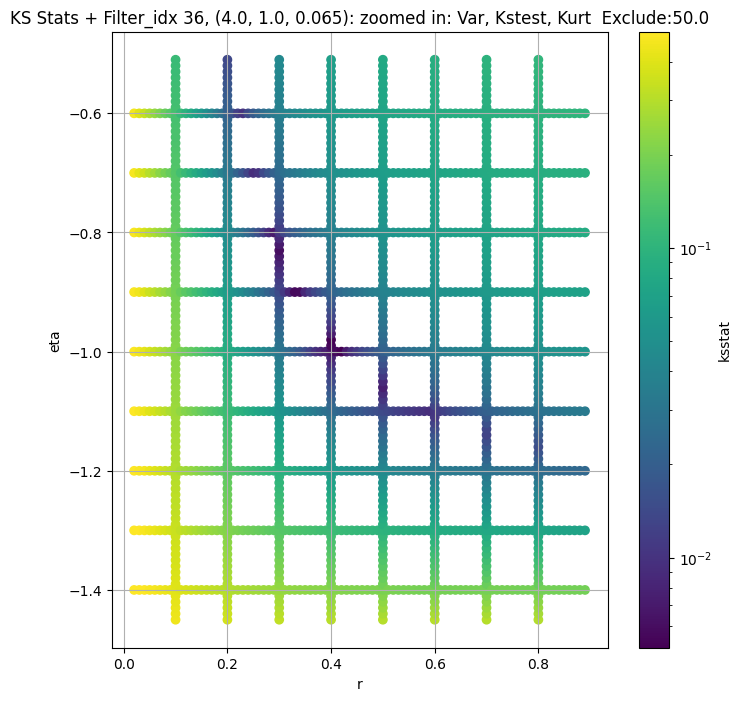

Filter_idx 37, (4.0, 1.0, 0.096):


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 100.0 + 100 = 200, ksstat: 0.007034791427595499, var: 5304.66552734375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 100.0 + 75 = 175, ksstat: 0.007365770886498146, var: 5427.92333984375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 100.0 + 50 = 150, ksstat: 0.00732333934987528, var: 5562.234375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 100.0 + 25 = 125, ksstat: 0.006737634690561989, var: 5709.5302734375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 100.0 + 0 = 100, ksstat: 0.006431408962739749, var: 5872.8662109375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 100.0 + -25 = 75, ksstat: 0.0056413841946444665, var: 6056.5400390625


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 100.0 + -50 = 50, ksstat: 0.005579738895067188, var: 6267.17724609375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 100.0 + -75 = 25, ksstat: 0.005896290304143792, var: 6519.13037109375


  0%|          | 0/1410 [00:00<?, ?it/s]

Finding Minimum after computing 1410 CDFs
filter_idx 37, 100.0 + -100 = 0, ksstat: 0.004905888841108208, var: 6984.451171875
Number of samples: 100000, Without approximation : 65536000.0


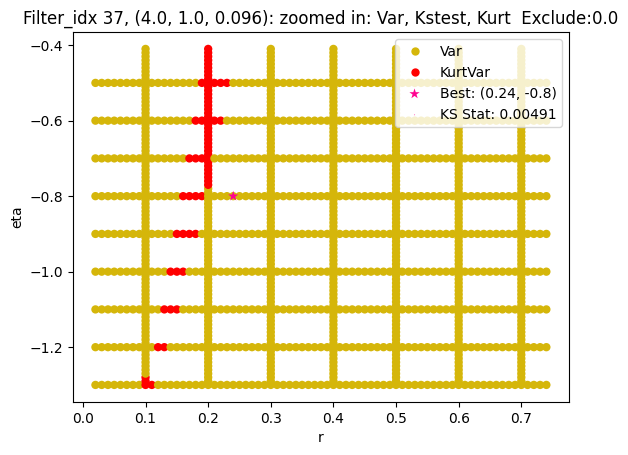

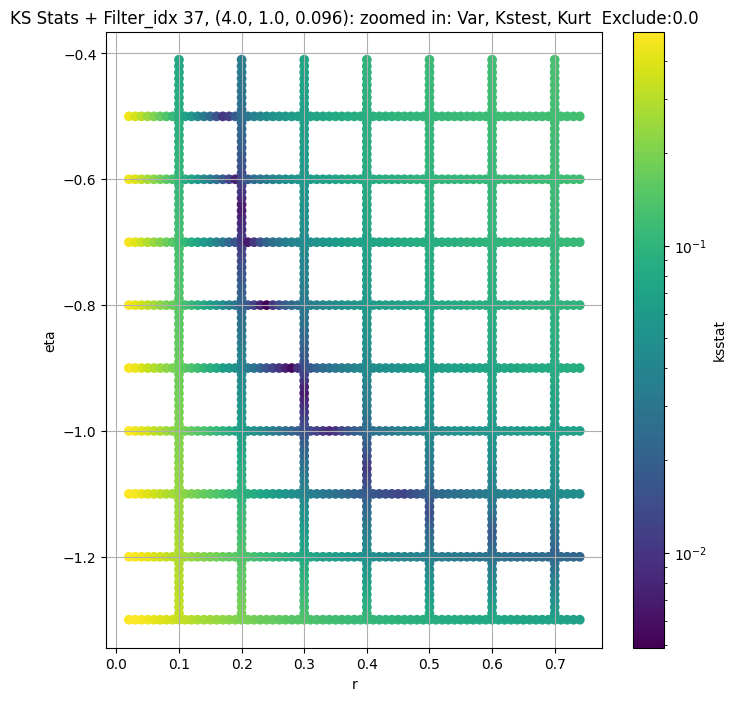

Filter_idx 38, (4.0, 1.0, 0.141):


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 0.0 + 100 = 100, ksstat: 0.006810978946667823, var: 2084.192626953125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 0.0 + 75 = 75, ksstat: 0.007031523378309146, var: 2158.210205078125


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 0.0 + 50 = 50, ksstat: 0.006198095044457008, var: 2244.842041015625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 0.0 + 25 = 25, ksstat: 0.006136562647698129, var: 2349.853515625


  0%|          | 0/1320 [00:00<?, ?it/s]

Finding Minimum after computing 1320 CDFs
filter_idx 38, 0.0 + 0 = 0, ksstat: 0.005156245879984533, var: 2525.520751953125
Number of samples: 100000, Without approximation : 65536000.0


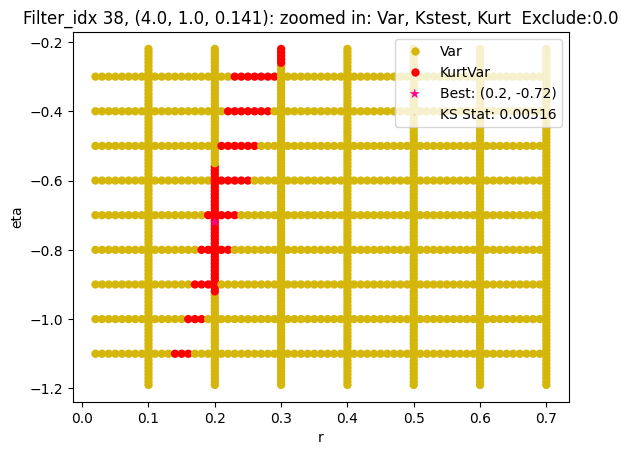

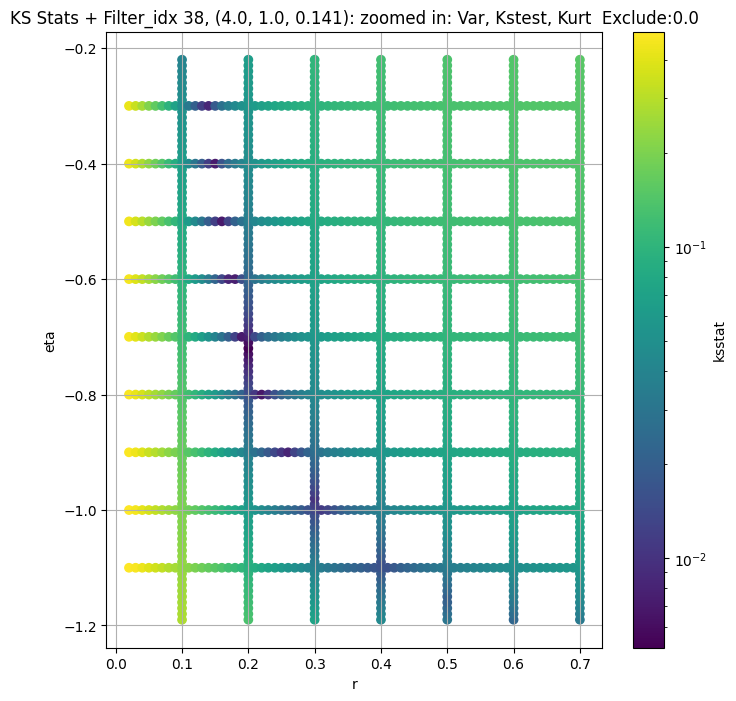

Filter_idx 39, (4.0, 1.0, 0.208):


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 39, 0.0 + 100 = 100, ksstat: 0.007048247332349378, var: 742.5195922851562


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 39, 0.0 + 75 = 75, ksstat: 0.0062706550782851145, var: 772.88623046875


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 39, 0.0 + 50 = 50, ksstat: 0.006383321798994146, var: 808.9379272460938


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 39, 0.0 + 25 = 25, ksstat: 0.005330306254491171, var: 854.9553833007812


  0%|          | 0/702 [00:00<?, ?it/s]

Finding Minimum after computing 702 CDFs
filter_idx 39, 0.0 + 0 = 0, ksstat: 0.00460849660192153, var: 935.8056030273438
Number of samples: 100000, Without approximation : 65536000.0


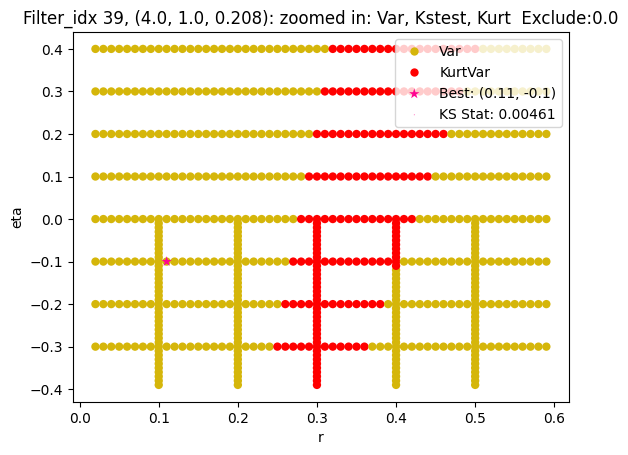

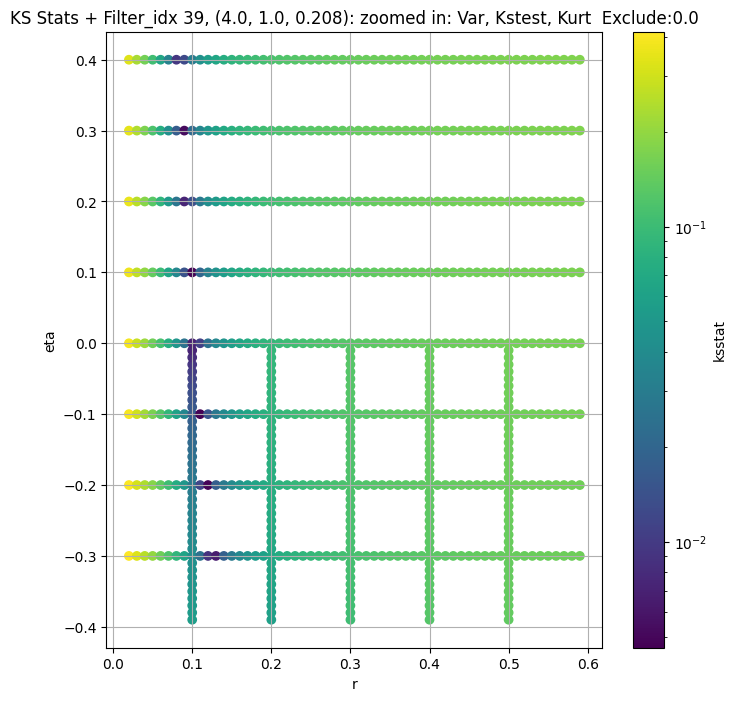

Filter_idx 40, (4.0, 1.0, 0.306):


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + 100 = 150, ksstat: 0.00469118725669666, var: 290.26708984375


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + 75 = 125, ksstat: 0.00405579555255875, var: 301.41851806640625


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + 50 = 100, ksstat: 0.004071737016974657, var: 313.9771423339844


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + 25 = 75, ksstat: 0.0034714333497368743, var: 328.5985412597656


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + 0 = 50, ksstat: 0.002817908474008011, var: 346.18603515625


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + -25 = 25, ksstat: 0.0028744833346430188, var: 368.56451416015625


  0%|          | 0/1251 [00:00<?, ?it/s]

Finding Minimum after computing 1251 CDFs
filter_idx 40, 50.0 + -50 = 0, ksstat: 0.003013866874200688, var: 408.2551574707031
Number of samples: 100000, Without approximation : 65536000.0


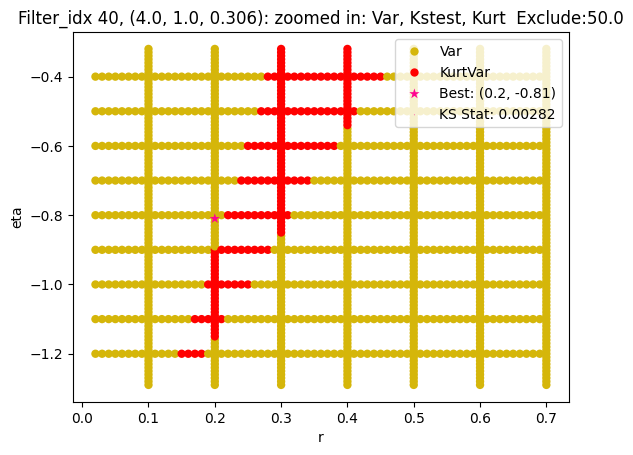

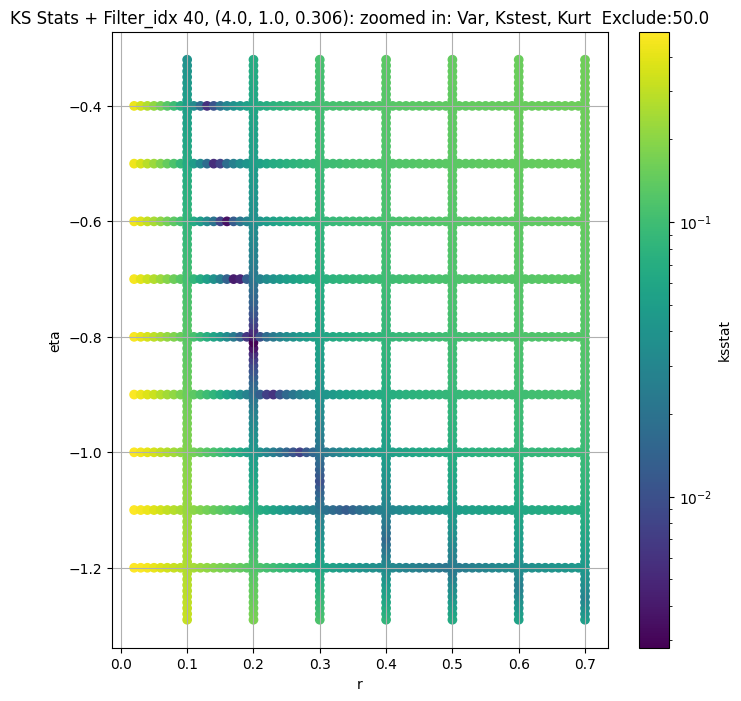

Filter_idx 41, (4.0, 1.0, 0.45):


  0%|          | 0/882 [00:00<?, ?it/s]

Finding Minimum after computing 882 CDFs
filter_idx 41, 0.0 + 100 = 100, ksstat: 0.010530915972214006, var: 117.86723327636719


  0%|          | 0/882 [00:00<?, ?it/s]

Finding Minimum after computing 882 CDFs
filter_idx 41, 0.0 + 75 = 75, ksstat: 0.009337447698419377, var: 124.36090087890625


  0%|          | 0/882 [00:00<?, ?it/s]

Finding Minimum after computing 882 CDFs
filter_idx 41, 0.0 + 50 = 50, ksstat: 0.010723872989874317, var: 132.46961975097656


  0%|          | 0/882 [00:00<?, ?it/s]

Finding Minimum after computing 882 CDFs
filter_idx 41, 0.0 + 25 = 25, ksstat: 0.008150683592226066, var: 143.10739135742188


  0%|          | 0/882 [00:00<?, ?it/s]

Finding Minimum after computing 882 CDFs
filter_idx 41, 0.0 + 0 = 0, ksstat: 0.008191193524556606, var: 161.3517303466797
Number of samples: 100000, Without approximation : 65536000.0


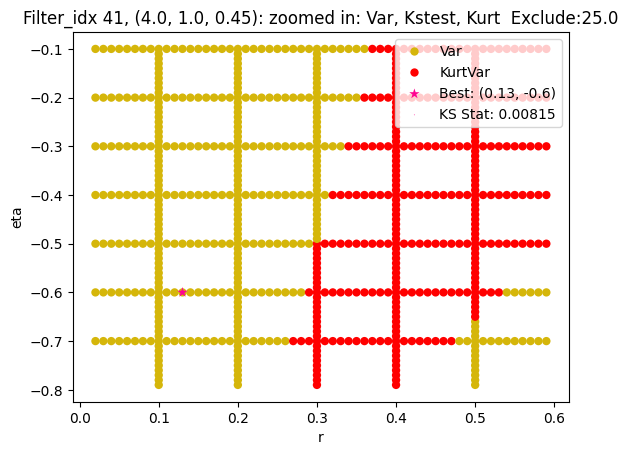

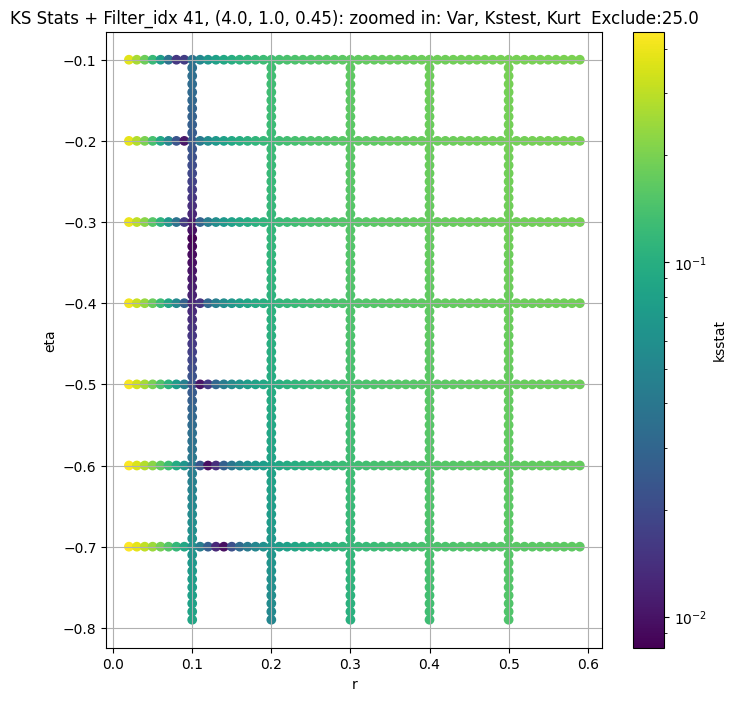

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,initial_scale,initial_exclude_cutoff,best_augmented_var,kstest_stat_cutoff_0.05,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff,n_pval_0.05
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",55335.40000,43910.880000,67200.02000,4.569961,2.753132,10.063652,65536000.0,"(2.0, 0.5, 0.044)",0.009377,...,8.054667e+04,50.0,55335.398438,0.000168,0.007650,0.80,-1.02,8.714475e+04,0.0,32000
1,"(2.0, 0.5, 0.065)",19047.67000,14847.801000,24242.93000,6.379718,3.746185,14.553737,65536000.0,"(2.0, 0.5, 0.065)",0.006850,...,2.968734e+04,0.0,18597.369141,0.000168,0.005517,0.80,-1.11,3.688315e+04,25.0,64000
2,"(2.0, 0.5, 0.096)",6874.37450,5331.145000,8745.57600,7.939266,4.336729,17.756517,65536000.0,"(2.0, 0.5, 0.096)",0.007515,...,7.818248e+03,0.0,6692.858887,0.000168,0.006486,0.60,-1.09,7.372649e+03,25.0,45562
3,"(2.0, 0.5, 0.141)",2517.88000,1859.195700,3329.25050,11.032557,5.883101,26.747358,65536000.0,"(2.0, 0.5, 0.141)",0.009173,...,1.748528e+03,0.0,2517.879883,0.000168,0.007213,0.40,-1.03,5.750366e+02,0.0,36000
4,"(2.0, 0.5, 0.208)",960.38640,676.863200,1276.19180,13.725231,7.874681,37.101093,65536000.0,"(2.0, 0.5, 0.208)",0.009045,...,2.139619e+01,100.0,960.386414,0.000168,0.005810,0.33,-1.00,6.872343e+01,0.0,54000
5,"(2.0, 0.5, 0.306)",337.90594,225.185470,464.41925,17.738790,8.973111,45.261600,65536000.0,"(2.0, 0.5, 0.306)",0.007586,...,1.176462e+01,50.0,288.571198,0.000168,0.007583,0.31,-1.00,1.368093e+01,125.0,32000
6,"(2.0, 0.5, 0.45)",228.05840,158.856740,316.73297,16.143604,8.750346,45.505930,65536000.0,"(2.0, 0.5, 0.45)",0.010307,...,6.060490e+01,100.0,228.058395,0.000168,0.010296,0.38,-1.10,5.415019e+01,0.0,18000
7,"(2.0, 1.0, 0.044)",75053.41000,60645.383000,93151.82000,5.436268,3.062418,13.906753,65536000.0,"(2.0, 1.0, 0.044)",0.007652,...,4.988344e+04,0.0,75053.406250,0.000168,0.004739,0.70,-0.95,7.979819e+04,0.0,81000
8,"(2.0, 1.0, 0.065)",27106.73800,20925.596000,34942.88700,7.330939,3.835541,21.208311,65536000.0,"(2.0, 1.0, 0.065)",0.004748,...,2.301723e+04,0.0,27106.738281,0.000168,0.003148,0.70,-1.05,3.672231e+04,0.0,192000


In [14]:
master_df_optimized_path = Path(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))

NUM_ITERS = dict(zip(GROUPS, [1]*len(GROUPS))) # By default, does one iteration per group
NUM_SAMPLES_OPTIMIZE = 2000
EXCLUDE_CUTOFFS_OPTIMIZE = np.arange(100, -101, -25)

if RERUN or not master_df_optimized_path.exists():

    if SKIP_OPTIMIZE_STEP:

        master_df['kstest_stat_best'] = master_df['kstest_stat_initial']
        master_df[f'best_r'] = master_df['initial_r']
        master_df[f'best_eta'] = master_df['initial_eta']
        master_df[f'best_scale'] = master_df['initial_scale']
        master_df[f'best_exclude_cutoff'] = master_df['initial_exclude_cutoff']

    else:
        for group in GROUPS: # TODO For quick testing purposes
            print(f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}:")
            master_df.loc[group, 'kstest_stat_best'] = master_df.loc[group, 'kstest_stat_initial']
            master_df.loc[group, 'best_r'] = master_df.loc[group, 'initial_r']
            master_df.loc[group, 'best_eta'] = master_df.loc[group, 'initial_eta']
            master_df.loc[group, 'best_scale'] = master_df.loc[group, 'initial_scale']

            sample = group_data_map[group]
            if len(sample) == 0:
                continue
            initial_r, initial_eta = master_df.loc[group, 'initial_r'], master_df.loc[group, f'initial_eta']
            eps = 0.5
            group_cdfs_df = fine_cdfs_df[(np.abs(master_df.loc[group, 'initial_r'] - fine_cdfs_df['r']) < eps) & 
                                        (np.abs(master_df.loc[group, 'initial_eta'] - fine_cdfs_df['eta']) < eps)].reset_index(drop=True)
            group_cdfs = {x[0]:x[1] for x in group_cdfs_df['(r,eta),cdf']}

            for adjust_exclude_cutoff in EXCLUDE_CUTOFFS_OPTIMIZE: # -50, -25, 0, 25, 50
                
                exclude_cutoff = int(max(0, adjust_exclude_cutoff + master_df.loc[group, 'initial_exclude_cutoff']))
                
                if exclude_cutoff == 0:
                    augmented_var = np.var(group_data_map[group])
                else:
                    augmented_var = np.var(group_data_map[group][exclude_cutoff:-exclude_cutoff])                       

                group_cdfs_df['scale'] = np.clip((augmented_var / group_cdfs_df['variance']), 0,  SCALE_CAP)
                ksstats, initial_param, min_stat = gridsearch(sample, group_cdfs, debug=True, scales=group_cdfs_df['scale'])
                
                cutoff_label = generate_cutoff_label(adjust_exclude_cutoff)

                augmented_var_df.loc[group, f"kstest_stat_{cutoff_label}"] = min_stat
                group_cdfs_df[f'ksstat_exclude_{cutoff_label}'] = ksstats
                
                print(f"{GROUP} {group}, {master_df.loc[group, 'initial_exclude_cutoff']} + {adjust_exclude_cutoff} = {exclude_cutoff}, ksstat: {min_stat}, var: {augmented_var}")
                best_adjust = 0

                if min_stat < master_df.loc[group, 'kstest_stat_best']:

                    inital_min_stat = min_stat
                    inital_best_param = initial_param
                    master_df.loc[group, 'kstest_stat_best'] = min_stat
                    initial_scale = group_cdfs_df.loc[(group_cdfs_df["r"] ==  initial_param[0]) & (group_cdfs_df["eta"] ==  initial_param[1])]["scale"].iloc[0]
                    master_df.loc[group, 'best_r'], master_df.loc[group, 'best_eta'] = initial_param
                    master_df.loc[group, 'best_scale'] = initial_scale
                    master_df.loc[group, 'best_exclude_cutoff'] = exclude_cutoff
                    master_df.loc[group, 'best_augmented_var'] = augmented_var
                    augmented_var_df.loc[group, 'best_augmented_var'] = augmented_var
                    best_adjust = adjust_exclude_cutoff

                if exclude_cutoff == 0:
                    break

            cutoff_label = generate_cutoff_label(best_adjust)
            ksstats = group_cdfs_df[f"ksstat_exclude_{cutoff_label}"]
            
            print(f"Number of samples: {sample.size}, Without approximation : {master_df.loc[group, 'total_samples']}")
            
            cutoff = stats.kstwo(n=master_df.loc[group, 'total_samples']).isf(0.05)
            master_df.loc[group, 'kstest_stat_cutoff_0.05'] = cutoff

            best_scales = np.clip((master_df.loc[group, 'best_augmented_var'] / group_cdfs_df['variance']), 0,  SCALE_CAP)

            group_cdfs_df['variance'] = group_cdfs_df['variance'] * best_scales
            group_cdfs_df['kurtosis'] = group_cdfs_df['kurtosis'] * best_scales

            group_cdfs_df = add_tests_to_df(cdfs_df = group_cdfs_df, group = group, var_kurt_df = master_df, ksstats = ksstats).sort_values(['r', 'eta'])

            group_dict = rEtaKsstats_dict[group]
            group_dict.update({'r_optimize' : group_cdfs_df['r'], 'eta_optimize' : group_cdfs_df['eta'], f'ksstat_exclude_{cutoff_label}' : ksstats})
            rEtaKsstats_dict[group] = group_dict

            cols = ['pass_var', 'pass_kstest', 'pass_kurt']
            fig = combo_test_plot(group_cdfs_df, cols, 
                                plot_name=f"{GROUP.capitalize()} {group}, {str(filter_group_map[group])}: zoomed in: {', '.join([col[5:].capitalize() for col in cols])}  Exclude:{master_df.loc[group, 'best_exclude_cutoff']}",
                                best_param=(master_df.loc[group, 'best_r'], master_df.loc[group, f'best_eta']),
                                best_ksstat=master_df.loc[group, 'kstest_stat_best'])
            fig.figure.savefig(os.path.join(CWD, "plots", f"optimized_full_grid_search_combo_plot_layer{group}.jpg"), bbox_inches = 'tight', dpi=100)
            
    master_df['n_pval_0.05'] = master_df.apply(lambda row : find_n_fixed_pval_stat(row.loc['kstest_stat_best'], row.loc['total_samples']), axis = 1)    
    master_df[['total_samples', 'initial_r', 'initial_eta', 'kstest_stat_initial', 'initial_exclude_cutoff', 'best_r', 'best_eta', 'best_scale', 'kstest_stat_best', 'best_exclude_cutoff', 'n_pval_0.05']].to_csv(os.path.join(CWD, "CSVs", 'optimized_params.csv'))
    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df_optimized.csv'))
    augmented_var_df.to_csv(augmented_var_df_path)
    pd.to_pickle(rEtaKsstats_dict, rEtaKsstats_dict_path)

rEtaKsstats_dict = pd.read_pickle(rEtaKsstats_dict_path)
master_df = pd.read_csv(master_df_optimized_path, index_col = GROUP)
augmented_var_df = pd.read_csv(augmented_var_df_path, index_col = GROUP)
master_df

## Comparing Empirical and Computed CDF/PDF

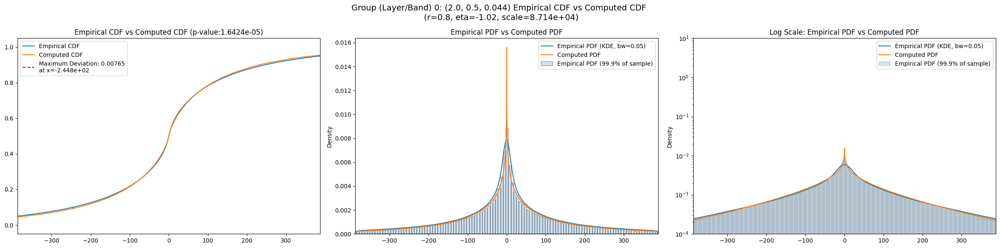

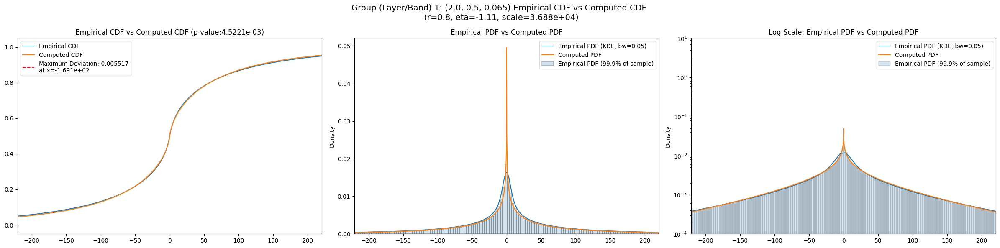

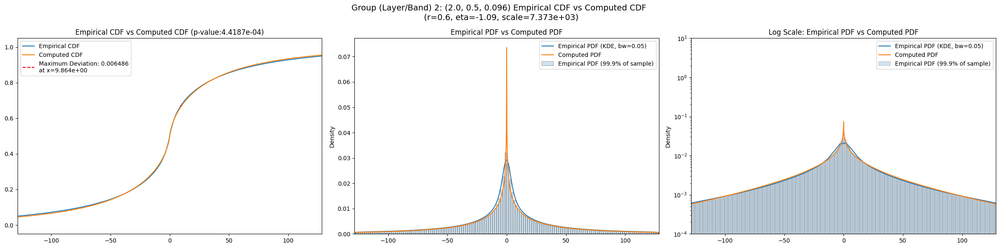

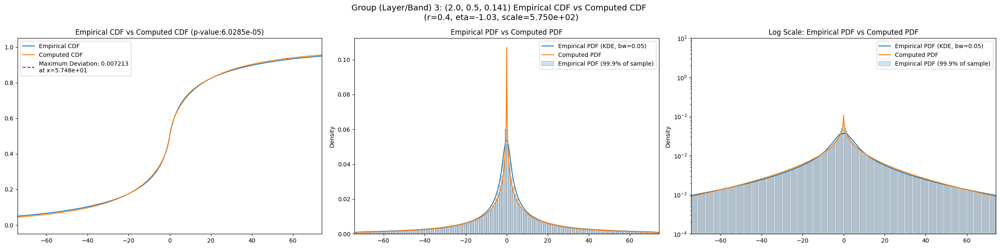

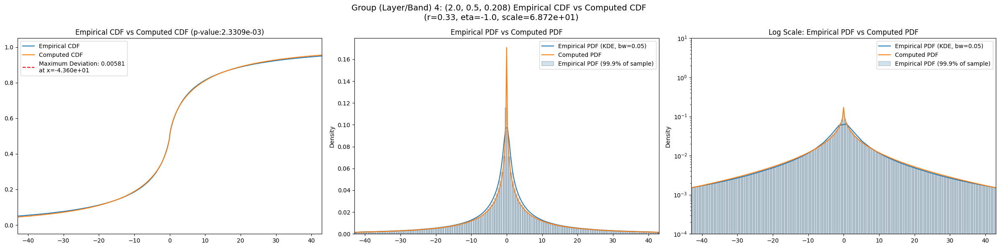

...

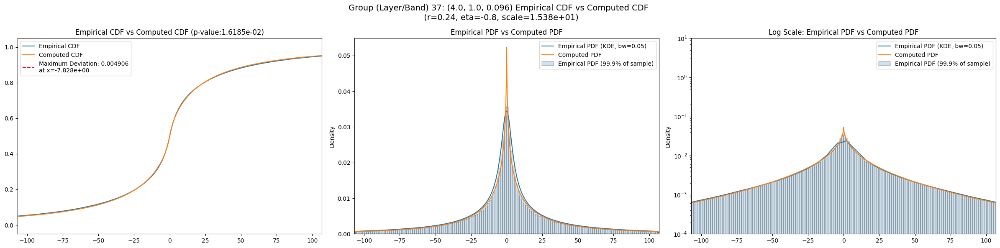

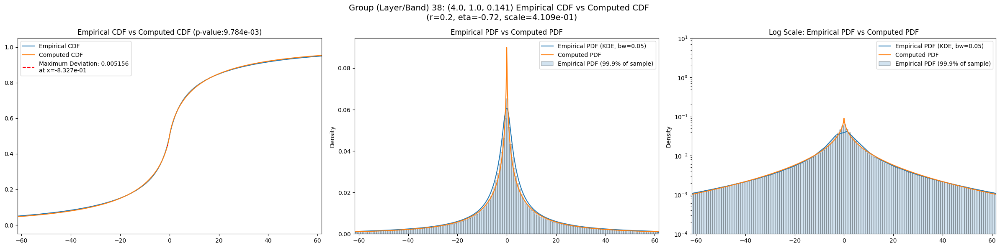

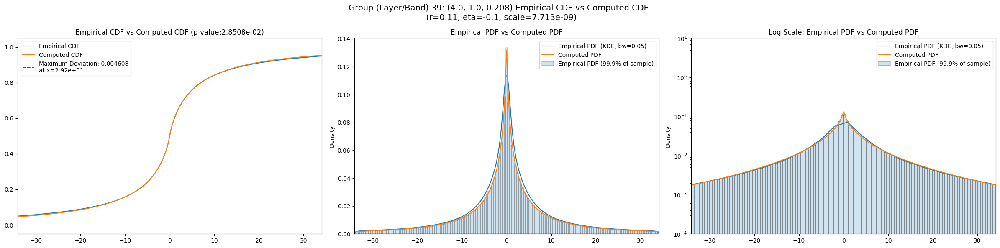

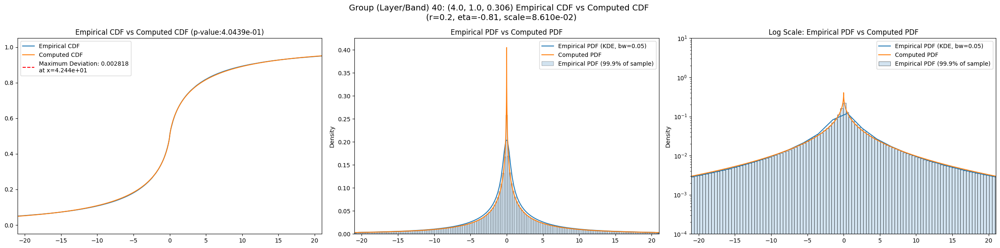

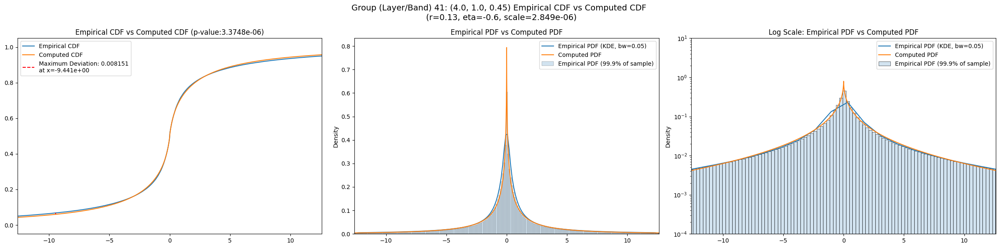

In [15]:
for group in GROUPS:
    group_info = master_df.loc[group]
    best_r = group_info['best_r']
    best_eta = group_info['best_eta']
    best_scale = group_info['best_scale']
    fig = visualize_cdf_pdf(sample = group_data_map[group], 
                    params = (best_r, best_eta, best_scale), 
                    log_scale = True,
                    group = f"{group}: {filter_group_map[group]}")
    fig.savefig(os.path.join(CWD, "plots", f'compare_cdf_pdf_layer_{group}.jpg'), bbox_inches = 'tight', dpi = 100)

## Comparing with Gaussian and Laplace Priors

In [16]:
def generate_func(sample, distro, *args, n_samples=200):
    if distro == 'gaussian' or distro == 'normal':
        def var_func(var):
            cdf = scipy.stats.norm(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'laplace':
        def var_func(var):
            cdf = scipy.stats.laplace(scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 't':
        def var_func(var):
            cdf = scipy.stats.t(df=2, scale=var).cdf
            return compute_ksstat(sample, cdf)
        return var_func
    elif distro == 'prior_r':
        eta = args[0]
        def r_func(r):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return r_func
    elif distro == 'prior_eta':
        r = args[0]
        def eta_func(eta):
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples)
            return compute_ksstat(sample, cdf)
        return eta_func
    elif distro == 'prior':
        def r_eta_func(params):
            r = params[0]
            eta = params[1]
            cdf = compute_prior_cdf(r, eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample, cdf)
        return r_eta_func
    elif distro == 'prior_with_scale':
        def r_eta_scale_func(params):
            r = params[0]
            eta = params[1]
            scale = params[2]
            print(r, eta, scale)
            cdf = compute_prior_cdf(r = r, eta = eta, n_samples=n_samples, debug=False)
            return compute_ksstat(sample/ np.sqrt(scale), cdf)
        return r_eta_scale_func

    print("Please enter a valid argument for `distro`: 'gaussian', 'laplace', 'prior_r', 'prior_eta', 'prior','prior_with_scale', 't'")

In [17]:
master_df_path = Path(os.path.join(CWD, "CSVs", 'master_df.csv'))

if RERUN or not master_df_path.exists():
    upper_bound = int(1e6)
    for group in GROUPS:
        if len(group_data_map[group]) == 0:
            continue
        norm_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'gaussian'), method = 'bounded', bounds = (0, upper_bound))
        laplace_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 'laplace'), method = 'bounded', bounds = (0, upper_bound))
        t_result = scipy.optimize.minimize_scalar(generate_func(group_data_map[group], 't'), method = 'bounded', bounds = (0, upper_bound))
        
        master_df.loc[group, 'param_gaussian'] = round_to_sigfigs(norm_result['x'], 6)
        master_df.loc[group, 'kstest_stat_gaussian'] = round_to_sigfigs(norm_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_gaussian'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_gaussian']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6)

        master_df.loc[group, 'param_laplace'] = round_to_sigfigs(laplace_result['x'], 6)
        master_df.loc[group, 'kstest_stat_laplace'] = round_to_sigfigs(laplace_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_laplace'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_laplace']), 6) 

        master_df.loc[group, 'param_t'] = round_to_sigfigs(t_result['x'], 6)
        master_df.loc[group, 'kstest_stat_t'] = round_to_sigfigs(t_result['fun'], 6)
        master_df.loc[group, 'kstest_pval_t'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_t']), 6) 

        master_df.loc[group, 'kstest_pval_gengamma'] = round_to_sigfigs(stats.kstwo(n=master_df.loc[group, 'total_samples']).sf(master_df.loc[group, 'kstest_stat_best']))

    master_df.to_csv(os.path.join(CWD, "CSVs", 'master_df.csv'))
    
master_df = pd.read_csv(os.path.join(CWD, "CSVs", 'master_df.csv'), index_col = GROUP)
master_df

,params,obs_var,var_lower,var_upper,obs_kurt,kurt_lower,kurt_upper,total_samples,filter_group,kstest_stat_initial,...,param_gaussian,kstest_stat_gaussian,kstest_pval_gaussian,param_laplace,kstest_stat_laplace,kstest_pval_laplace,param_t,kstest_stat_t,kstest_pval_t,kstest_pval_gengamma
filter_idx,,,,,,,,,,,,,,,,,,,,,
0,"(2.0, 0.5, 0.044)",55335.40000,43910.880000,67200.02000,4.569961,2.753132,10.063652,65536000.0,"(2.0, 0.5, 0.044)",0.009377,...,139.59800,0.062439,0.0,119.01000,0.037263,0.0,95.12480,0.041021,0.0,0.0
1,"(2.0, 0.5, 0.065)",19047.67000,14847.801000,24242.93000,6.379718,3.746185,14.553737,65536000.0,"(2.0, 0.5, 0.065)",0.006850,...,70.50900,0.071038,0.0,60.15920,0.045886,0.0,47.47110,0.048534,0.0,0.0
2,"(2.0, 0.5, 0.096)",6874.37450,5331.145000,8745.57600,7.939266,4.336729,17.756517,65536000.0,"(2.0, 0.5, 0.096)",0.007515,...,38.67180,0.074188,0.0,33.21280,0.048692,0.0,26.02760,0.050457,0.0,0.0
3,"(2.0, 0.5, 0.141)",2517.88000,1859.195700,3329.25050,11.032557,5.883101,26.747358,65536000.0,"(2.0, 0.5, 0.141)",0.009173,...,20.67760,0.077119,0.0,17.95470,0.051291,0.0,13.95010,0.051670,0.0,0.0
4,"(2.0, 0.5, 0.208)",960.38640,676.863200,1276.19180,13.725231,7.874681,37.101093,65536000.0,"(2.0, 0.5, 0.208)",0.009045,...,11.59190,0.076240,0.0,10.12570,0.050678,0.0,7.80580,0.050320,0.0,0.0
5,"(2.0, 0.5, 0.306)",337.90594,225.185470,464.41925,17.738790,8.973111,45.261600,65536000.0,"(2.0, 0.5, 0.306)",0.007586,...,6.06022,0.078256,0.0,5.28384,0.053047,0.0,4.05802,0.052572,0.0,0.0
6,"(2.0, 0.5, 0.45)",228.05840,158.856740,316.73297,16.143604,8.750346,45.505930,65536000.0,"(2.0, 0.5, 0.45)",0.010307,...,5.04173,0.080804,0.0,4.38064,0.055635,0.0,3.37105,0.055346,0.0,0.0
7,"(2.0, 1.0, 0.044)",75053.41000,60645.383000,93151.82000,5.436268,3.062418,13.906753,65536000.0,"(2.0, 1.0, 0.044)",0.007652,...,168.14200,0.054829,0.0,143.72200,0.029370,0.0,115.19200,0.033322,0.0,0.0
8,"(2.0, 1.0, 0.065)",27106.73800,20925.596000,34942.88700,7.330939,3.835541,21.208311,65536000.0,"(2.0, 1.0, 0.065)",0.004748,...,89.18640,0.062987,0.0,76.21930,0.037649,0.0,60.54730,0.040872,0.0,0.0


## Results

In [18]:
import pandas as pd
import os
master_df = pd.read_csv(os.path.join(os.getcwd(), "CSVs", 'master_df.csv'), index_col = 0)

In [19]:
master_df.filter(regex="kstest_stat.*")

,kstest_stat_initial,kstest_stat_cutoff_0.05,kstest_stat_best,kstest_stat_gaussian,kstest_stat_laplace,kstest_stat_t
filter_idx,,,,,,
0,0.009377,0.000168,0.007650,0.062439,0.037263,0.041021
1,0.006850,0.000168,0.005517,0.071038,0.045886,0.048534
2,0.007515,0.000168,0.006486,0.074188,0.048692,0.050457
3,0.009173,0.000168,0.007213,0.077119,0.051291,0.051670
4,0.009045,0.000168,0.005810,0.076240,0.050678,0.050320
5,0.007586,0.000168,0.007583,0.078256,0.053047,0.052572
6,0.010307,0.000168,0.010296,0.080804,0.055635,0.055346
7,0.007652,0.000168,0.004739,0.054829,0.029370,0.033322
8,0.004748,0.000168,0.003148,0.062987,0.037649,0.040872


In [20]:
master_df.filter(regex="best.*")

,best_augmented_var,kstest_stat_best,best_r,best_eta,best_scale,best_exclude_cutoff
filter_idx,,,,,,
0,55335.398438,0.007650,0.80,-1.02,8.714475e+04,0.0
1,18597.369141,0.005517,0.80,-1.11,3.688315e+04,25.0
2,6692.858887,0.006486,0.60,-1.09,7.372649e+03,25.0
3,2517.879883,0.007213,0.40,-1.03,5.750366e+02,0.0
4,960.386414,0.005810,0.33,-1.00,6.872343e+01,0.0
5,288.571198,0.007583,0.31,-1.00,1.368093e+01,125.0
6,228.058395,0.010296,0.38,-1.10,5.415019e+01,0.0
7,75053.406250,0.004739,0.70,-0.95,7.979819e+04,0.0
8,27106.738281,0.003148,0.70,-1.05,3.672231e+04,0.0
